In [1]:
from __future__ import print_function,division
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
import glob

get_ipython().run_line_magic('matplotlib','inline')
plt.rcParams['figure.figsize'] = (10.0,8.0)
plt.rcParams['image.interpolation'] = 'nearest'
#plt.rcParams['image.cmap'] = 'gray'

In [2]:
def disp_images(images,type="color"):
    image_type = len(images.shape)
    images = np.reshape(images,[images.shape[0],-1])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    if type=="color":   
        global sqrtimg
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1]/3))) #--------------------------------------------------------        
    else:  
        print("error, need to revise")
    figure = plt.figure(figsize = (sqrtn,sqrtn))
    gs = gridspec.GridSpec(sqrtn,sqrtn)
    gs.update(wspace = 0.05,hspace = 0.05)
    for i,img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg,3]))

def preprocess(x):
    return 2*x-1.0
def deprocess(x):
    return (x+1.0) / 2.0
def count_params():
    param_count = np.sum([np.prod(x.get_shape().as_list()) for x in tf.global_variables()])
    return param_count
def session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    session = tf.Session(config = config)
    return session
def activation(x, alpha = 0.01):# leaky relu
    a = tf.maximum(x,alpha*x)
    return a
def sample_noise(batch_size,dim):
    random_noise = tf.random_uniform(maxval = 1,minval = -1,shape =[batch_size,dim])
    return random_noise

def get_solvers(lr = 1e-3, beta1 = 0.5):
    d_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    g_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    return d_solver,g_solver
def wgan_gp_loss(logits_real,logits_fake,batch_size,x,G_sample):
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    lam = 10
    eps = tf.random_uniform([batch_size,1],minval=0.0,maxval=1.0)
    #a = tf.reshape(x,[batch_size,-1])    
    #b = tf.reshape(G_sample,[batch_size,-1])
    x_h = eps*x + (1-eps)*G_sample  #----------random relax search image-----------------------------------

    with tf.variable_scope("",reuse=True) as scope:# cannot understand gradient penalty
        #temp = tf.reshape(x_h,[batch_size,32,32,3])#-------------------------------------------change size
        grad_d_x_h = tf.gradients(discriminator(x_h),x_h)# [batch,32*32*3]
    grad_norm = tf.norm(grad_d_x_h[0],axis=1,ord='euclidean')#fetch x-gradient and apply euclidean calibration
    grad_pen = tf.reduce_mean(tf.square(grad_norm-1))
    
    d_loss += lam*grad_pen  #this is the key pivot at WGAN-GP
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss


def wgan_loss(logits_real,logits_fake,batch_size,x,G_sample):  #not yet regularization
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss

def dcgan_loss(logits_real,logits_fake,batch_size,x,G_sample): #not yet regularization
    d_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_real,1e-12,1.0)))-tf.reduce_mean(tf.log(tf.clip_by_value(1 - logits_fake,1e-12,1.0)))
    g_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_fake,1e-12,1.0)))
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss
###################loss
def fetch_img(path,amount=5000):
    image_list = []
    count = 0
    for filename in glob.glob(path + '/*.jpg'): #assuming gif
        count += 1
        im=mpimg.imread(filename)
        image_list.append(im)
        if count%5000 == 0:
            print(str(count) + "/50000")
        if count == amount:
            break
    cifar_10 = np.array(image_list)
    cifar_10 = cifar_10 * 1.0 / 255        #calibration from [0,255] to [0.0~1.0]
    print(cifar_10.shape)
    disp_images(cifar_10[:save_size])
    return cifar_10

(200, 96, 96, 3)


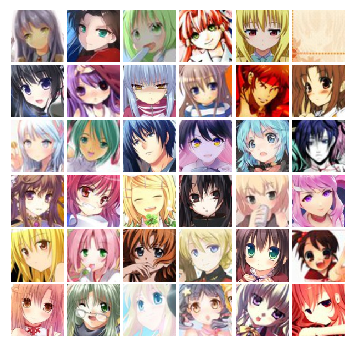

In [3]:
path = '/home/lw2435/faces'
fetch_amount = 200
batch_size = 36
noise_dim = 1024
log_dir='/home/lw2435' + '/DCGAN-v12'#------------------------------------------------------------------------
save_size = 36
cifar_10 = fetch_img(path,fetch_amount)

In [4]:
def attention(x,ch):
    with tf.variable_scope('attention', reuse=False):
        init = tf.contrib.layers.xavier_initializer()
        f = tf.layers.conv2d(x,filters=ch//2,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='ff_conv')
        g = tf.layers.conv2d(x,filters=ch//2,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='gg_conv')
        
        f = tf.reshape(f,shape=[f.shape[0],-1,f.shape[-1]])
        g = tf.reshape(g,shape=[g.shape[0],-1,g.shape[-1]])
        
        combine_f_g = tf.matmul(g,f,transpose_b=True)   #[batch,height,width,channel/2]
        combine_f_g = tf.nn.softmax(combine_f_g, dim=-1)#[batch,h*w,h*w]
        
        h = tf.layers.conv2d(x,filters=ch,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='hh_conv') #[batch,height,width,channel]
        h = tf.reshape(h,shape=[h.shape[0],-1,h.shape[-1]])      # [batch,h*w,channel]
        # N = h * w
        
        combine_f_g_h = tf.matmul(combine_f_g,h) # [batch,h*w,channel]
        combine_f_g_h = tf.reshape(combine_f_g_h, shape=x.shape)
        
        gamma = tf.get_variable("gamma",[1],initializer=tf.constant_initializer(0.0))
        x = gamma * combine_f_g_h + x

        return x
    
def generator(x):#for dcgan   input  [batch=128,noise_dim=1024]
    with tf.variable_scope("generator"):#zzz???????????????
        init = tf.contrib.layers.xavier_initializer()
        #reshape
        fc1 = tf.layers.dense(inputs=z,units=4*4*64,kernel_initializer=init,name='g_dense_0')  #[batch,4*4*64]#_--------------modify for all
        fc1 = tf.layers.batch_normalization(fc1,name='g_batchnorm_0')
        fc1 = tf.nn.relu(fc1)
        img = tf.reshape(fc1,[-1,4,4,64])                                              #[batch,4,4,256]   depth=256
        #deconv1
        img = tf.layers.conv2d_transpose(img,filters=32,kernel_size=4,strides=2,padding='same', #batch*8*8*32    strides=扩大几倍
                                                kernel_initializer=init,name='g_deconv_1')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_1')
        img = tf.nn.relu(img)
 
        img = tf.layers.conv2d_transpose(img,filters=16,kernel_size=4,strides=2,padding='same', #batch*16*16*16
                                                kernel_initializer=init,name='g_deconv_2')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_2')
        img = tf.nn.relu(img)
        
        #img = attention(img,16)
        
        img = tf.layers.conv2d_transpose(img,filters=8,kernel_size=4,strides=2,padding='same', #batch*32*32*8
                                                kernel_initializer=init,name='g_deconv_3')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        img = tf.nn.relu(img)

        img = tf.layers.conv2d_transpose(img,filters=3,kernel_size=4,strides=2,padding='same', #batch*64*64*3 #-----------------------adding layer
                                                kernel_initializer=init,name='g_deconv_4')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_4')
        img = tf.nn.tanh(img)  #size down is a linear function !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
        #img = tf.layers.conv2d_transpose(img,3,4,strides=1,padding='same', #batch*32*32*3-------------------------------------
                                                #activation=tf.nn.tanh,kernel_initializer=init,name='g_deconv_4')#-------activation

        #img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        #img = tf.nn.relu(img)
        #reshape
        #img = tf.reshape(img,[-1,64*64*3]) #[batch,] #------------------------------change size
        
        #img = tf.layers.dense(inputs=img,units=96*96*3,kernel_initializer=init,name='g_dense_5') #----------adding layer
        
        #img = img / tf.maximum(tf.abs(tf.reduce_min(img)),tf.abs(tf.reduce_max(img)))
        #img = tf.layers.dense(inputs=img,units=,activation=tf.nn.tanh,name='tanh')#---------------change para   #change output size
        img = tf.image.resize_images(img,(img_size,img_size),method=0)
        img = tf.reshape(img,shape=[-1,img_size*img_size*3])
        return img

def train(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step,
         show_every=250,print_every=50,batch_size=128,num_epoch=10):
    max_iter = int(cifar_10.shape[0]*num_epoch/batch_size)#===========================================
    offset = 0 #============================================================
    epoch_cur = 0
    for it in range(max_iter):
        if (it % show_every == 0):
            #print(sess.run(tf.reduce_max(G_sample)))
            #print(sess.run(tf.reduce_min(G_sample)))
            samples = deprocess(sess.run(G_sample))#-----------------------------take care to deprocess samples!!!
            fig = disp_images(samples[:64])# one global para
            plt.show()
            print()
        #fetch the minibatch and train
        #minibatch,minibatch_y = mnist.train.next_batch(batch_size)
        minibatch1 = cifar_10[offset : offset + batch_size]
        offset = offset + batch_size
        if (offset + batch_size >= cifar_10.shape[0]):    
            epoch_cur = epoch_cur + 1
            print("epoch:"+str(epoch_cur)+"---------------------------------")
            np.random.shuffle(cifar_10)
            offset = 0
        minibatch1 = minibatch1.reshape(minibatch1.shape[0],-1)# serialize all the pixels

        _,D_loss_curr = sess.run([D_train_step,D_loss],feed_dict = {x:minibatch1})
        _,G_loss_curr = sess.run([G_train_step,G_loss])
        #fetch the minibatch and train
        
        if (it % print_every == 0):
            print('Iter:{}, D:{:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
        if (it % show_every == 0):      
            rs = sess.run(merged,feed_dict = {x:minibatch1})#-------------------------------------------
            train_writer.add_summary(rs,it)
    print('Final images')
    samples = deprocess(sess.run(G_sample))
        
    fig = disp_images(samples[:save_size])# one global para
    plt.show()
  
def discriminator(x):#for wgan    input  [batch,32*32*3]
    with tf.variable_scope('discriminator'):
        init = tf.contrib.layers.xavier_initializer()
        
        x = tf.reshape(x,[-1,img_size*img_size*3])  #----------------------------------------change para:   [batch,96*96*3]
        #x = tf.reshape(x,[-1,img_size,img_size,3])  #generalize serialized pixels and bunch of pixels
        #x = tf.image.resize_images(x,(64,64),method=0)   #[batch,64,64,3]
        x = tf.layers.dense(x,12288,kernel_initializer=init,name='d_dense_0')#------we can never add batch normalization there
                                                                                #!!!!!!!!!!for down sample
        x = activation(x)
        
        x = tf.reshape(x,[-1,64,64,3])# one global para
        x = tf.layers.conv2d(x,filters=8,kernel_size=4,strides=2,padding='same',  #batch*32*32*8
                            kernel_initializer=init,name='d_conv_1')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_1')
        x = activation(x)        

        x = tf.layers.conv2d(x,filters=16,kernel_size=4,strides=2,padding='same',  #batch*16*16*16
                            kernel_initializer=init,name='d_conv_2')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_2')
        x = activation(x)         
        
        #x = attention(x,16)
        
        x = tf.layers.conv2d(x,filters=32,kernel_size=4,strides=2,padding='same',  #batch*8*8*32
                            kernel_initializer=init,name='d_conv_3')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_3')
        x = activation(x)  

        x = tf.layers.conv2d(x,filters=64,kernel_size=4,strides=2,padding='same',  #batch*4*4*64
                            kernel_initializer=init,name='d_conv_4')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_4')
        x = activation(x) 
        
        x = tf.reshape(x,[-1,4*4*64])                              # [batch,(4*4*64)]
        #x = tf.layers.dense(x,1024,kernel_initializer=init,name='d_dense3')  #discriminator too strong
        logits = tf.layers.dense(x,1,kernel_initializer=init,name='logits')
        #logits = tf.nn.sigmoid(logits)
        return logits



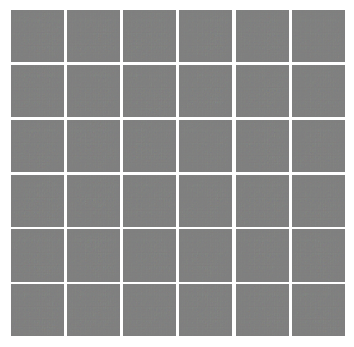


Iter:0, D:8.132, G:-0.1545
epoch:1---------------------------------
Iter:5, D:-109.2, G:-20.21
epoch:2---------------------------------
Iter:10, D:-200.4, G:-37.24
epoch:3---------------------------------
Iter:15, D:-330.4, G:47.88
epoch:4---------------------------------
Iter:20, D:-490.9, G:-156.9
epoch:5---------------------------------
Iter:25, D:-206.0, G:6.03
epoch:6---------------------------------
Iter:30, D:-432.8, G:-13.08
epoch:7---------------------------------
Iter:35, D:-257.7, G:-1.06
epoch:8---------------------------------
Iter:40, D:-232.7, G:-10.62
epoch:9---------------------------------
Iter:45, D:-158.8, G:-17.17
epoch:10---------------------------------
Iter:50, D:-274.0, G:-5.537
epoch:11---------------------------------
Iter:55, D:-183.6, G:-84.15
epoch:12---------------------------------
Iter:60, D:-127.1, G:-52.76
epoch:13---------------------------------
Iter:65, D:-68.28, G:-98.89
epoch:14---------------------------------
Iter:70, D:-50.55, G:3.102
epoch:1

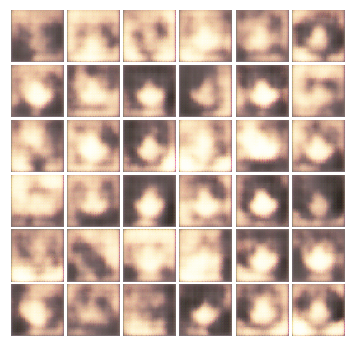


Iter:200, D:-62.33, G:66.17
epoch:41---------------------------------
Iter:205, D:-72.28, G:-31.98
epoch:42---------------------------------
Iter:210, D:-66.16, G:47.24
epoch:43---------------------------------
Iter:215, D:-72.91, G:-7.368
epoch:44---------------------------------
Iter:220, D:-71.76, G:19.16
epoch:45---------------------------------
Iter:225, D:-69.61, G:1.865
epoch:46---------------------------------
Iter:230, D:-73.75, G:14.03
epoch:47---------------------------------
Iter:235, D:-23.01, G:-0.5627
epoch:48---------------------------------
Iter:240, D:-57.09, G:60.93
epoch:49---------------------------------
Iter:245, D:-70.47, G:-8.891
epoch:50---------------------------------
Iter:250, D:-76.91, G:88.18
epoch:51---------------------------------
Iter:255, D:-63.95, G:-38.77
epoch:52---------------------------------
Iter:260, D:-73.54, G:47.18
epoch:53---------------------------------
Iter:265, D:-59.27, G:2.157
epoch:54---------------------------------
Iter:270, D:-

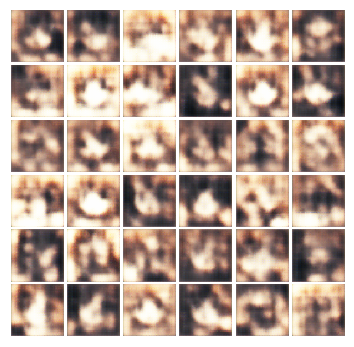


Iter:400, D:-100.8, G:-23.18
epoch:81---------------------------------
Iter:405, D:-99.98, G:48.86
epoch:82---------------------------------
Iter:410, D:-119.8, G:14.67
epoch:83---------------------------------
Iter:415, D:-123.1, G:55.14
epoch:84---------------------------------
Iter:420, D:-138.1, G:-61.13
epoch:85---------------------------------
Iter:425, D:-113.5, G:32.57
epoch:86---------------------------------
Iter:430, D:-96.9, G:3.661
epoch:87---------------------------------
Iter:435, D:-113.2, G:35.96
epoch:88---------------------------------
Iter:440, D:-82.52, G:-1.006
epoch:89---------------------------------
Iter:445, D:-41.74, G:49.44
epoch:90---------------------------------
Iter:450, D:-120.5, G:47.94
epoch:91---------------------------------
Iter:455, D:-88.57, G:-8.231
epoch:92---------------------------------
Iter:460, D:-149.4, G:11.65
epoch:93---------------------------------
Iter:465, D:-126.8, G:52.82
epoch:94---------------------------------
Iter:470, D:-102

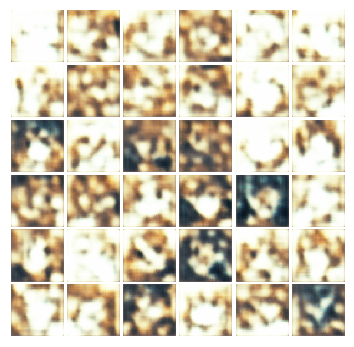


Iter:600, D:-153.7, G:7.815
epoch:121---------------------------------
Iter:605, D:-188.5, G:-81.03
epoch:122---------------------------------
Iter:610, D:-143.7, G:15.53
epoch:123---------------------------------
Iter:615, D:-159.1, G:-11.78
epoch:124---------------------------------
Iter:620, D:-175.8, G:69.23
epoch:125---------------------------------
Iter:625, D:-160.0, G:-33.22
epoch:126---------------------------------
Iter:630, D:-147.2, G:-24.21
epoch:127---------------------------------
Iter:635, D:-169.7, G:-7.647
epoch:128---------------------------------
Iter:640, D:-132.9, G:-39.4
epoch:129---------------------------------
Iter:645, D:-170.4, G:-22.63
epoch:130---------------------------------
Iter:650, D:-172.2, G:-12.94
epoch:131---------------------------------
Iter:655, D:-197.5, G:6.802
epoch:132---------------------------------
Iter:660, D:-148.6, G:52.5
epoch:133---------------------------------
Iter:665, D:-172.7, G:-81.58
epoch:134--------------------------------

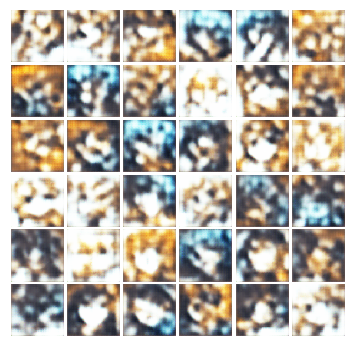


Iter:800, D:-216.6, G:31.01
epoch:161---------------------------------
Iter:805, D:-189.3, G:-11.11
epoch:162---------------------------------
Iter:810, D:-155.8, G:-137.8
epoch:163---------------------------------
Iter:815, D:-269.9, G:8.115
epoch:164---------------------------------
Iter:820, D:-219.1, G:48.82
epoch:165---------------------------------
Iter:825, D:-224.4, G:-12.45
epoch:166---------------------------------
Iter:830, D:-233.9, G:49.9
epoch:167---------------------------------
Iter:835, D:-196.6, G:56.03
epoch:168---------------------------------
Iter:840, D:-141.8, G:5.169
epoch:169---------------------------------
Iter:845, D:-262.8, G:20.38
epoch:170---------------------------------
Iter:850, D:-253.5, G:-1.243
epoch:171---------------------------------
Iter:855, D:-225.6, G:-51.39
epoch:172---------------------------------
Iter:860, D:-250.3, G:63.29
epoch:173---------------------------------
Iter:865, D:-218.9, G:8.11
epoch:174---------------------------------
It

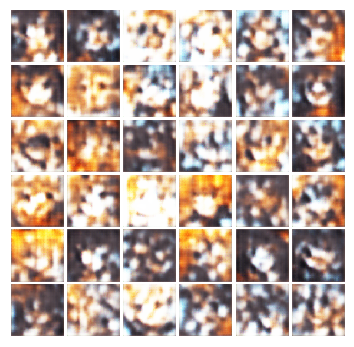


Iter:1000, D:-338.3, G:8.605
epoch:201---------------------------------
Iter:1005, D:-270.1, G:62.1
epoch:202---------------------------------
Iter:1010, D:-299.6, G:-34.35
epoch:203---------------------------------
Iter:1015, D:-298.0, G:19.42
epoch:204---------------------------------
Iter:1020, D:-262.2, G:-41.43
epoch:205---------------------------------
Iter:1025, D:-376.9, G:-4.132
epoch:206---------------------------------
Iter:1030, D:-301.4, G:-19.62
epoch:207---------------------------------
Iter:1035, D:-296.8, G:-38.4
epoch:208---------------------------------
Iter:1040, D:-439.7, G:88.37
epoch:209---------------------------------
Iter:1045, D:-252.9, G:-6.171
epoch:210---------------------------------
Iter:1050, D:-309.7, G:43.55
epoch:211---------------------------------
Iter:1055, D:-363.3, G:2.235
epoch:212---------------------------------
Iter:1060, D:-285.4, G:49.96
epoch:213---------------------------------
Iter:1065, D:-298.3, G:-33.98
epoch:214--------------------

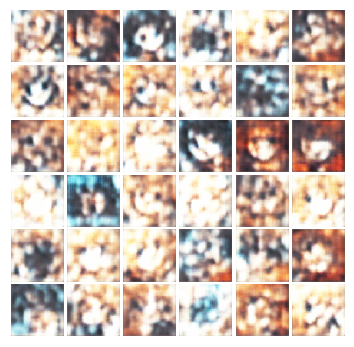


Iter:1200, D:-398.1, G:-14.59
epoch:241---------------------------------
Iter:1205, D:-352.1, G:-3.598
epoch:242---------------------------------
Iter:1210, D:-345.0, G:10.21
epoch:243---------------------------------
Iter:1215, D:-384.9, G:37.08
epoch:244---------------------------------
Iter:1220, D:-297.7, G:54.99
epoch:245---------------------------------
Iter:1225, D:-408.7, G:68.01
epoch:246---------------------------------
Iter:1230, D:-416.0, G:-70.1
epoch:247---------------------------------
Iter:1235, D:-398.0, G:21.78
epoch:248---------------------------------
Iter:1240, D:-390.4, G:14.32
epoch:249---------------------------------
Iter:1245, D:-529.1, G:10.88
epoch:250---------------------------------
Iter:1250, D:-430.2, G:-34.69
epoch:251---------------------------------
Iter:1255, D:-363.9, G:-89.16
epoch:252---------------------------------
Iter:1260, D:-336.9, G:2.558
epoch:253---------------------------------
Iter:1265, D:-416.0, G:6.316
epoch:254---------------------

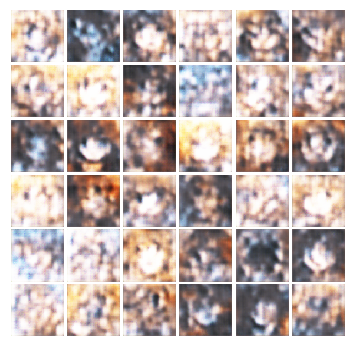


Iter:1400, D:-421.1, G:-20.5
epoch:281---------------------------------
Iter:1405, D:-447.4, G:-13.69
epoch:282---------------------------------
Iter:1410, D:-435.9, G:-9.679
epoch:283---------------------------------
Iter:1415, D:-343.2, G:25.18
epoch:284---------------------------------
Iter:1420, D:-340.3, G:-2.025
epoch:285---------------------------------
Iter:1425, D:-406.8, G:10.89
epoch:286---------------------------------
Iter:1430, D:-371.0, G:3.101
epoch:287---------------------------------
Iter:1435, D:-343.6, G:25.97
epoch:288---------------------------------
Iter:1440, D:-407.1, G:-71.03
epoch:289---------------------------------
Iter:1445, D:-332.8, G:31.29
epoch:290---------------------------------
Iter:1450, D:-445.0, G:-30.43
epoch:291---------------------------------
Iter:1455, D:-334.2, G:43.2
epoch:292---------------------------------
Iter:1460, D:-474.5, G:-36.22
epoch:293---------------------------------
Iter:1465, D:-330.5, G:46.38
epoch:294--------------------

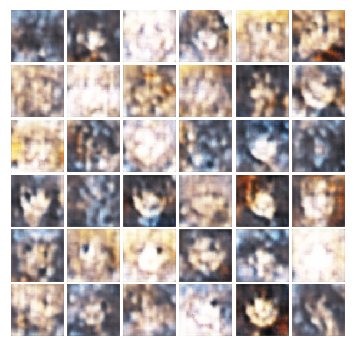


Iter:1600, D:-384.3, G:-47.96
epoch:321---------------------------------
Iter:1605, D:-463.4, G:-30.85
epoch:322---------------------------------
Iter:1610, D:-376.3, G:-34.67
epoch:323---------------------------------
Iter:1615, D:-407.7, G:0.966
epoch:324---------------------------------
Iter:1620, D:-364.1, G:9.421
epoch:325---------------------------------
Iter:1625, D:-366.0, G:1.866
epoch:326---------------------------------
Iter:1630, D:-363.5, G:-32.02
epoch:327---------------------------------
Iter:1635, D:-344.0, G:-4.681
epoch:328---------------------------------
Iter:1640, D:-396.5, G:-40.22
epoch:329---------------------------------
Iter:1645, D:-406.8, G:-2.067
epoch:330---------------------------------
Iter:1650, D:-414.3, G:-35.57
epoch:331---------------------------------
Iter:1655, D:-439.3, G:-4.727
epoch:332---------------------------------
Iter:1660, D:-376.2, G:-26.5
epoch:333---------------------------------
Iter:1665, D:-382.1, G:-35.82
epoch:334---------------

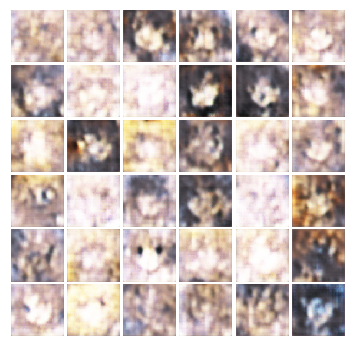


Iter:1800, D:-413.7, G:-66.31
epoch:361---------------------------------
Iter:1805, D:-307.3, G:45.85
epoch:362---------------------------------
Iter:1810, D:-454.7, G:36.09
epoch:363---------------------------------
Iter:1815, D:-354.8, G:-42.1
epoch:364---------------------------------
Iter:1820, D:-312.8, G:18.62
epoch:365---------------------------------
Iter:1825, D:-294.2, G:51.73
epoch:366---------------------------------
Iter:1830, D:-373.5, G:-2.907
epoch:367---------------------------------
Iter:1835, D:-378.0, G:2.178
epoch:368---------------------------------
Iter:1840, D:-300.4, G:17.71
epoch:369---------------------------------
Iter:1845, D:-339.1, G:-22.43
epoch:370---------------------------------
Iter:1850, D:-304.9, G:24.29
epoch:371---------------------------------
Iter:1855, D:-319.0, G:12.06
epoch:372---------------------------------
Iter:1860, D:-320.2, G:6.772
epoch:373---------------------------------
Iter:1865, D:-280.3, G:13.71
epoch:374----------------------

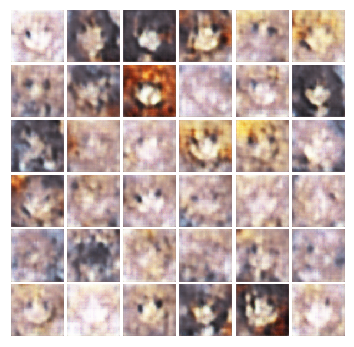


Iter:2000, D:-361.2, G:-61.03
epoch:401---------------------------------
Iter:2005, D:-337.8, G:6.167
epoch:402---------------------------------
Iter:2010, D:-419.9, G:-39.23
epoch:403---------------------------------
Iter:2015, D:-361.1, G:-26.34
epoch:404---------------------------------
Iter:2020, D:-344.4, G:9.69
epoch:405---------------------------------
Iter:2025, D:-368.8, G:-14.62
epoch:406---------------------------------
Iter:2030, D:-331.2, G:-6.026
epoch:407---------------------------------
Iter:2035, D:-276.9, G:15.22
epoch:408---------------------------------
Iter:2040, D:-345.8, G:-3.639
epoch:409---------------------------------
Iter:2045, D:-297.6, G:43.87
epoch:410---------------------------------
Iter:2050, D:-325.8, G:23.36
epoch:411---------------------------------
Iter:2055, D:-385.5, G:-35.93
epoch:412---------------------------------
Iter:2060, D:-288.0, G:10.17
epoch:413---------------------------------
Iter:2065, D:-301.0, G:-4.098
epoch:414------------------

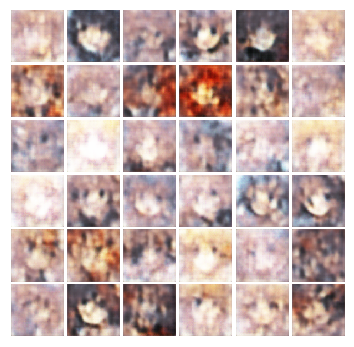


Iter:2200, D:-328.3, G:13.46
epoch:441---------------------------------
Iter:2205, D:-336.4, G:-27.74
epoch:442---------------------------------
Iter:2210, D:-314.8, G:-10.47
epoch:443---------------------------------
Iter:2215, D:-329.1, G:-8.407
epoch:444---------------------------------
Iter:2220, D:-269.8, G:6.515
epoch:445---------------------------------
Iter:2225, D:-254.9, G:8.784
epoch:446---------------------------------
Iter:2230, D:-305.1, G:-25.13
epoch:447---------------------------------
Iter:2235, D:-346.5, G:-43.08
epoch:448---------------------------------
Iter:2240, D:-363.9, G:-43.32
epoch:449---------------------------------
Iter:2245, D:-350.4, G:-10.16
epoch:450---------------------------------
Iter:2250, D:-327.5, G:-19.2
epoch:451---------------------------------
Iter:2255, D:-387.8, G:-45.71
epoch:452---------------------------------
Iter:2260, D:-381.9, G:-4.293
epoch:453---------------------------------
Iter:2265, D:-336.5, G:-20.85
epoch:454---------------

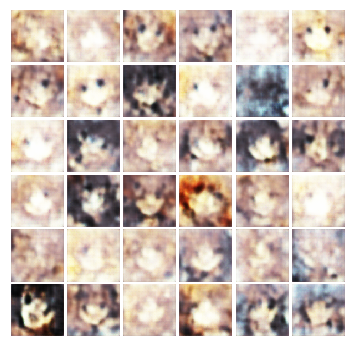


Iter:2400, D:-331.5, G:-64.14
epoch:481---------------------------------
Iter:2405, D:-244.2, G:20.75
epoch:482---------------------------------
Iter:2410, D:-363.3, G:0.9822
epoch:483---------------------------------
Iter:2415, D:-244.9, G:-4.091
epoch:484---------------------------------
Iter:2420, D:-367.9, G:-31.34
epoch:485---------------------------------
Iter:2425, D:-335.6, G:-19.17
epoch:486---------------------------------
Iter:2430, D:-280.5, G:-21.44
epoch:487---------------------------------
Iter:2435, D:-283.4, G:-6.591
epoch:488---------------------------------
Iter:2440, D:-280.9, G:-5.219
epoch:489---------------------------------
Iter:2445, D:-364.9, G:-26.57
epoch:490---------------------------------
Iter:2450, D:-323.1, G:-16.4
epoch:491---------------------------------
Iter:2455, D:-335.2, G:-44.84
epoch:492---------------------------------
Iter:2460, D:-353.4, G:-26.02
epoch:493---------------------------------
Iter:2465, D:-316.8, G:-6.061
epoch:494-------------

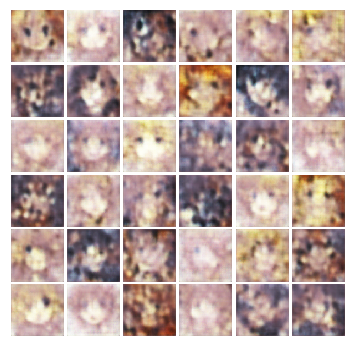


Iter:2600, D:-342.1, G:-24.49
epoch:521---------------------------------
Iter:2605, D:-264.2, G:14.84
epoch:522---------------------------------
Iter:2610, D:-269.1, G:-16.12
epoch:523---------------------------------
Iter:2615, D:-333.8, G:-39.85
epoch:524---------------------------------
Iter:2620, D:-308.9, G:-32.03
epoch:525---------------------------------
Iter:2625, D:-316.6, G:-34.62
epoch:526---------------------------------
Iter:2630, D:-283.5, G:-2.211
epoch:527---------------------------------
Iter:2635, D:-314.9, G:-6.064
epoch:528---------------------------------
Iter:2640, D:-323.5, G:-26.2
epoch:529---------------------------------
Iter:2645, D:-357.9, G:-15.44
epoch:530---------------------------------
Iter:2650, D:-318.7, G:-14.5
epoch:531---------------------------------
Iter:2655, D:-274.1, G:-13.83
epoch:532---------------------------------
Iter:2660, D:-254.0, G:-14.79
epoch:533---------------------------------
Iter:2665, D:-345.3, G:-27.11
epoch:534--------------

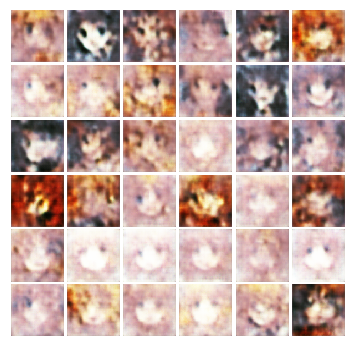


Iter:2800, D:-328.8, G:-32.91
epoch:561---------------------------------
Iter:2805, D:-416.1, G:-55.81
epoch:562---------------------------------
Iter:2810, D:-386.2, G:-59.5
epoch:563---------------------------------
Iter:2815, D:-288.3, G:29.75
epoch:564---------------------------------
Iter:2820, D:-303.9, G:-3.374
epoch:565---------------------------------
Iter:2825, D:-296.8, G:-21.21
epoch:566---------------------------------
Iter:2830, D:-327.3, G:-21.95
epoch:567---------------------------------
Iter:2835, D:-272.6, G:-20.76
epoch:568---------------------------------
Iter:2840, D:-247.8, G:-1.631
epoch:569---------------------------------
Iter:2845, D:-266.9, G:4.7
epoch:570---------------------------------
Iter:2850, D:-320.0, G:-10.48
epoch:571---------------------------------
Iter:2855, D:-285.8, G:-6.802
epoch:572---------------------------------
Iter:2860, D:-290.7, G:13.81
epoch:573---------------------------------
Iter:2865, D:-356.0, G:-63.8
epoch:574------------------

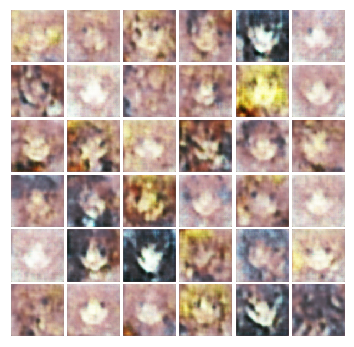


Iter:3000, D:-297.1, G:-22.68
epoch:601---------------------------------
Iter:3005, D:-302.3, G:-9.776
epoch:602---------------------------------
Iter:3010, D:-235.3, G:28.98
epoch:603---------------------------------
Iter:3015, D:-328.6, G:-17.6
epoch:604---------------------------------
Iter:3020, D:-249.5, G:8.186
epoch:605---------------------------------
Iter:3025, D:-305.0, G:-11.43
epoch:606---------------------------------
Iter:3030, D:-310.5, G:-38.93
epoch:607---------------------------------
Iter:3035, D:-313.9, G:3.089
epoch:608---------------------------------
Iter:3040, D:-264.6, G:0.8407
epoch:609---------------------------------
Iter:3045, D:-250.6, G:-11.1
epoch:610---------------------------------
Iter:3050, D:-230.2, G:-10.22
epoch:611---------------------------------
Iter:3055, D:-231.9, G:-17.52
epoch:612---------------------------------
Iter:3060, D:-224.5, G:-2.769
epoch:613---------------------------------
Iter:3065, D:-263.2, G:23.77
epoch:614-----------------

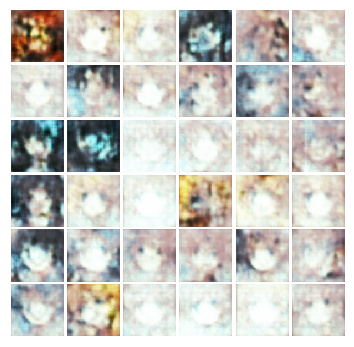


Iter:3200, D:-372.9, G:-84.55
epoch:641---------------------------------
Iter:3205, D:-337.6, G:90.62
epoch:642---------------------------------
Iter:3210, D:-398.2, G:-163.2
epoch:643---------------------------------
Iter:3215, D:-352.7, G:45.22
epoch:644---------------------------------
Iter:3220, D:-241.6, G:60.73
epoch:645---------------------------------
Iter:3225, D:-302.2, G:-128.5
epoch:646---------------------------------
Iter:3230, D:-305.2, G:29.69
epoch:647---------------------------------
Iter:3235, D:-520.1, G:-131.6
epoch:648---------------------------------
Iter:3240, D:-311.6, G:64.03
epoch:649---------------------------------
Iter:3245, D:-334.3, G:4.125
epoch:650---------------------------------
Iter:3250, D:-197.1, G:-3.079
epoch:651---------------------------------
Iter:3255, D:-281.3, G:-24.61
epoch:652---------------------------------
Iter:3260, D:-224.9, G:-1.964
epoch:653---------------------------------
Iter:3265, D:-282.7, G:-9.347
epoch:654-----------------

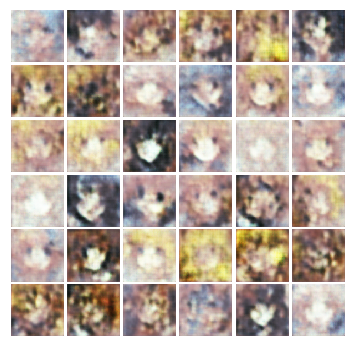


Iter:3400, D:-256.6, G:3.998
epoch:681---------------------------------
Iter:3405, D:-291.4, G:-8.006
epoch:682---------------------------------
Iter:3410, D:-278.0, G:-12.79
epoch:683---------------------------------
Iter:3415, D:-222.6, G:0.4979
epoch:684---------------------------------
Iter:3420, D:-229.3, G:-4.794
epoch:685---------------------------------
Iter:3425, D:-324.4, G:-22.61
epoch:686---------------------------------
Iter:3430, D:-262.0, G:-21.26
epoch:687---------------------------------
Iter:3435, D:-330.7, G:-6.85
epoch:688---------------------------------
Iter:3440, D:-346.3, G:-40.56
epoch:689---------------------------------
Iter:3445, D:-250.4, G:25.69
epoch:690---------------------------------
Iter:3450, D:-255.8, G:-4.562
epoch:691---------------------------------
Iter:3455, D:-271.8, G:-5.693
epoch:692---------------------------------
Iter:3460, D:-218.5, G:12.86
epoch:693---------------------------------
Iter:3465, D:-234.2, G:-6.726
epoch:694---------------

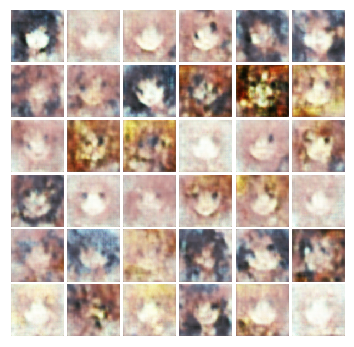


Iter:3600, D:-277.2, G:31.48
epoch:721---------------------------------
Iter:3605, D:-315.5, G:-16.45
epoch:722---------------------------------
Iter:3610, D:-328.7, G:-34.9
epoch:723---------------------------------
Iter:3615, D:-190.1, G:26.49
epoch:724---------------------------------
Iter:3620, D:-269.7, G:-7.546
epoch:725---------------------------------
Iter:3625, D:-257.2, G:-13.78
epoch:726---------------------------------
Iter:3630, D:-252.5, G:8.091
epoch:727---------------------------------
Iter:3635, D:-274.0, G:-19.75
epoch:728---------------------------------
Iter:3640, D:-315.8, G:-14.09
epoch:729---------------------------------
Iter:3645, D:-319.0, G:-16.28
epoch:730---------------------------------
Iter:3650, D:-300.2, G:-2.696
epoch:731---------------------------------
Iter:3655, D:-237.0, G:5.172
epoch:732---------------------------------
Iter:3660, D:-231.7, G:-9.588
epoch:733---------------------------------
Iter:3665, D:-279.0, G:-19.6
epoch:734-----------------

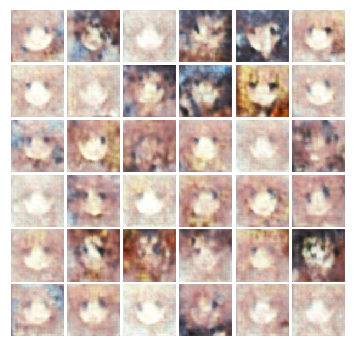


Iter:3800, D:-239.9, G:-2.715
epoch:761---------------------------------
Iter:3805, D:-307.8, G:-38.46
epoch:762---------------------------------
Iter:3810, D:-321.6, G:-6.142
epoch:763---------------------------------
Iter:3815, D:-267.2, G:-0.2317
epoch:764---------------------------------
Iter:3820, D:-296.7, G:-14.76
epoch:765---------------------------------
Iter:3825, D:-251.9, G:3.477
epoch:766---------------------------------
Iter:3830, D:-268.6, G:8.48
epoch:767---------------------------------
Iter:3835, D:-278.8, G:-28.32
epoch:768---------------------------------
Iter:3840, D:-325.7, G:-33.32
epoch:769---------------------------------
Iter:3845, D:-306.4, G:-6.599
epoch:770---------------------------------
Iter:3850, D:-260.4, G:-13.86
epoch:771---------------------------------
Iter:3855, D:-374.5, G:-28.6
epoch:772---------------------------------
Iter:3860, D:-347.2, G:-18.94
epoch:773---------------------------------
Iter:3865, D:-299.3, G:-2.617
epoch:774--------------

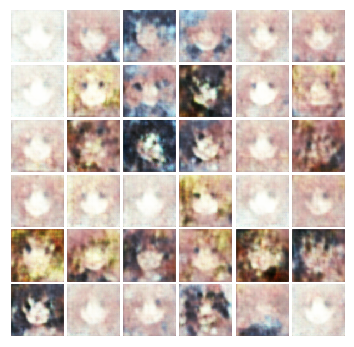


Iter:4000, D:-296.3, G:-18.94
epoch:801---------------------------------
Iter:4005, D:-334.9, G:-7.889
epoch:802---------------------------------
Iter:4010, D:-352.5, G:-49.16
epoch:803---------------------------------
Iter:4015, D:-301.9, G:-29.93
epoch:804---------------------------------
Iter:4020, D:-236.5, G:-7.717
epoch:805---------------------------------
Iter:4025, D:-309.3, G:-26.45
epoch:806---------------------------------
Iter:4030, D:-275.3, G:-29.13
epoch:807---------------------------------
Iter:4035, D:-322.9, G:-47.41
epoch:808---------------------------------
Iter:4040, D:-251.8, G:1.165
epoch:809---------------------------------
Iter:4045, D:-298.7, G:3.634
epoch:810---------------------------------
Iter:4050, D:-281.9, G:-1.143
epoch:811---------------------------------
Iter:4055, D:-263.5, G:3.966
epoch:812---------------------------------
Iter:4060, D:-270.8, G:-21.67
epoch:813---------------------------------
Iter:4065, D:-306.4, G:-36.96
epoch:814--------------

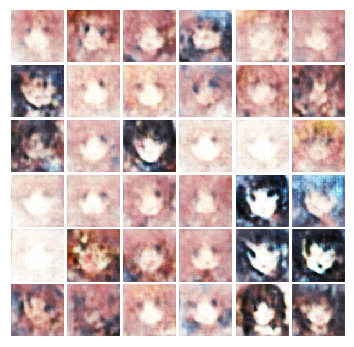


Iter:4200, D:-340.1, G:-24.6
epoch:841---------------------------------
Iter:4205, D:-333.8, G:-22.36
epoch:842---------------------------------
Iter:4210, D:-279.8, G:-16.7
epoch:843---------------------------------
Iter:4215, D:-258.1, G:-26.21
epoch:844---------------------------------
Iter:4220, D:-234.2, G:-36.03
epoch:845---------------------------------
Iter:4225, D:-240.2, G:-27.29
epoch:846---------------------------------
Iter:4230, D:-314.0, G:-12.47
epoch:847---------------------------------
Iter:4235, D:-313.9, G:-17.69
epoch:848---------------------------------
Iter:4240, D:-310.8, G:-33.66
epoch:849---------------------------------
Iter:4245, D:-309.9, G:-15.35
epoch:850---------------------------------
Iter:4250, D:-291.7, G:35.45
epoch:851---------------------------------
Iter:4255, D:-223.3, G:24.15
epoch:852---------------------------------
Iter:4260, D:-325.6, G:-26.84
epoch:853---------------------------------
Iter:4265, D:-294.2, G:-8.243
epoch:854---------------

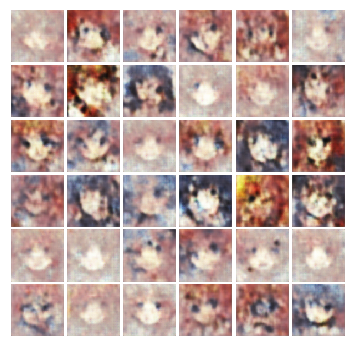


Iter:4400, D:-241.7, G:6.129
epoch:881---------------------------------
Iter:4405, D:-245.5, G:6.464
epoch:882---------------------------------
Iter:4410, D:-259.5, G:-12.05
epoch:883---------------------------------
Iter:4415, D:-254.5, G:-9.789
epoch:884---------------------------------
Iter:4420, D:-306.4, G:-18.59
epoch:885---------------------------------
Iter:4425, D:-246.0, G:-10.57
epoch:886---------------------------------
Iter:4430, D:-223.0, G:-15.09
epoch:887---------------------------------
Iter:4435, D:-273.2, G:-25.09
epoch:888---------------------------------
Iter:4440, D:-224.6, G:5.495
epoch:889---------------------------------
Iter:4445, D:-262.8, G:-23.74
epoch:890---------------------------------
Iter:4450, D:-310.0, G:-13.58
epoch:891---------------------------------
Iter:4455, D:-190.4, G:-4.801
epoch:892---------------------------------
Iter:4460, D:-223.3, G:-13.85
epoch:893---------------------------------
Iter:4465, D:-218.8, G:-9.572
epoch:894--------------

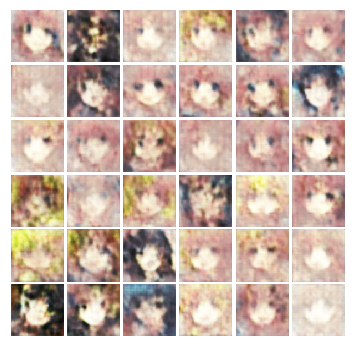


Iter:4600, D:-261.5, G:-5.862
epoch:921---------------------------------
Iter:4605, D:-219.7, G:-6.11
epoch:922---------------------------------
Iter:4610, D:-243.5, G:-9.158
epoch:923---------------------------------
Iter:4615, D:-248.1, G:-7.195
epoch:924---------------------------------
Iter:4620, D:-228.7, G:2.294
epoch:925---------------------------------
Iter:4625, D:-333.1, G:-29.39
epoch:926---------------------------------
Iter:4630, D:-262.9, G:-12.78
epoch:927---------------------------------
Iter:4635, D:-261.0, G:-9.991
epoch:928---------------------------------
Iter:4640, D:-243.4, G:-6.686
epoch:929---------------------------------
Iter:4645, D:-260.0, G:-15.93
epoch:930---------------------------------
Iter:4650, D:-242.1, G:-13.1
epoch:931---------------------------------
Iter:4655, D:-260.3, G:-10.8
epoch:932---------------------------------
Iter:4660, D:-313.1, G:-25.26
epoch:933---------------------------------
Iter:4665, D:-289.2, G:-23.74
epoch:934---------------

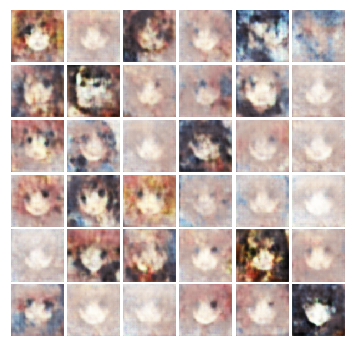


Iter:4800, D:-241.8, G:-13.93
epoch:961---------------------------------
Iter:4805, D:-235.3, G:-3.84
epoch:962---------------------------------
Iter:4810, D:-268.3, G:-22.55
epoch:963---------------------------------
Iter:4815, D:-221.0, G:-3.463
epoch:964---------------------------------
Iter:4820, D:-268.2, G:-5.547
epoch:965---------------------------------
Iter:4825, D:-282.4, G:-18.89
epoch:966---------------------------------
Iter:4830, D:-362.9, G:-42.9
epoch:967---------------------------------
Iter:4835, D:-264.7, G:1.398
epoch:968---------------------------------
Iter:4840, D:-289.1, G:-24.67
epoch:969---------------------------------
Iter:4845, D:-284.1, G:-22.02
epoch:970---------------------------------
Iter:4850, D:-282.2, G:-17.54
epoch:971---------------------------------
Iter:4855, D:-252.7, G:5.407
epoch:972---------------------------------
Iter:4860, D:-240.5, G:-5.095
epoch:973---------------------------------
Iter:4865, D:-272.8, G:-30.8
epoch:974----------------

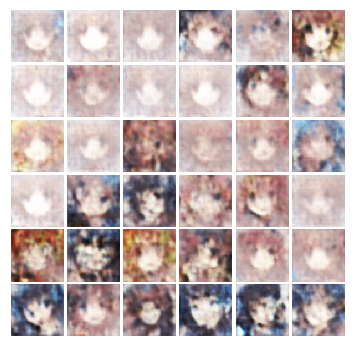


Iter:5000, D:-308.4, G:-34.67
epoch:1001---------------------------------
Iter:5005, D:-319.9, G:-10.71
epoch:1002---------------------------------
Iter:5010, D:-271.8, G:-1.366
epoch:1003---------------------------------
Iter:5015, D:-353.3, G:-11.69
epoch:1004---------------------------------
Iter:5020, D:-393.6, G:63.64
epoch:1005---------------------------------
Iter:5025, D:-338.0, G:177.7
epoch:1006---------------------------------
Iter:5030, D:-398.2, G:319.3
epoch:1007---------------------------------
Iter:5035, D:-315.7, G:211.0
epoch:1008---------------------------------
Iter:5040, D:-400.6, G:75.89
epoch:1009---------------------------------
Iter:5045, D:-182.9, G:367.7
epoch:1010---------------------------------
Iter:5050, D:88.58, G:-23.04
epoch:1011---------------------------------
Iter:5055, D:-418.9, G:3.261
epoch:1012---------------------------------
Iter:5060, D:-346.2, G:101.1
epoch:1013---------------------------------
Iter:5065, D:-254.1, G:21.74
epoch:1014-------

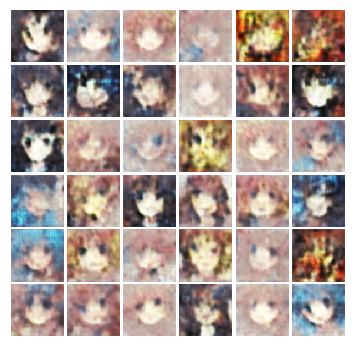


Iter:5200, D:-237.3, G:-14.71
epoch:1041---------------------------------
Iter:5205, D:-278.0, G:-14.7
epoch:1042---------------------------------
Iter:5210, D:-228.9, G:-0.3083
epoch:1043---------------------------------
Iter:5215, D:-241.6, G:-14.97
epoch:1044---------------------------------
Iter:5220, D:-185.0, G:2.846
epoch:1045---------------------------------
Iter:5225, D:-238.5, G:-5.092
epoch:1046---------------------------------
Iter:5230, D:-227.8, G:-9.285
epoch:1047---------------------------------
Iter:5235, D:-254.9, G:-8.703
epoch:1048---------------------------------
Iter:5240, D:-301.4, G:-37.05
epoch:1049---------------------------------
Iter:5245, D:-232.3, G:-4.859
epoch:1050---------------------------------
Iter:5250, D:-244.7, G:-9.654
epoch:1051---------------------------------
Iter:5255, D:-243.9, G:-6.396
epoch:1052---------------------------------
Iter:5260, D:-245.6, G:-12.57
epoch:1053---------------------------------
Iter:5265, D:-244.1, G:-11.07
epoch:10

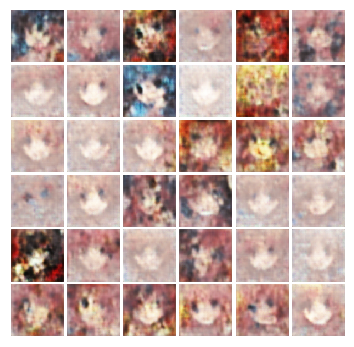


Iter:5400, D:-252.6, G:0.2104
epoch:1081---------------------------------
Iter:5405, D:-207.5, G:-2.654
epoch:1082---------------------------------
Iter:5410, D:-204.4, G:-0.2758
epoch:1083---------------------------------
Iter:5415, D:-253.3, G:-16.53
epoch:1084---------------------------------
Iter:5420, D:-253.2, G:-6.441
epoch:1085---------------------------------
Iter:5425, D:-285.5, G:-21.65
epoch:1086---------------------------------
Iter:5430, D:-215.2, G:-15.27
epoch:1087---------------------------------
Iter:5435, D:-227.1, G:0.3462
epoch:1088---------------------------------
Iter:5440, D:-273.2, G:-9.772
epoch:1089---------------------------------
Iter:5445, D:-321.8, G:-28.44
epoch:1090---------------------------------
Iter:5450, D:-322.0, G:-29.97
epoch:1091---------------------------------
Iter:5455, D:-295.4, G:-13.79
epoch:1092---------------------------------
Iter:5460, D:-267.7, G:-14.76
epoch:1093---------------------------------
Iter:5465, D:-263.7, G:7.565
epoch:1

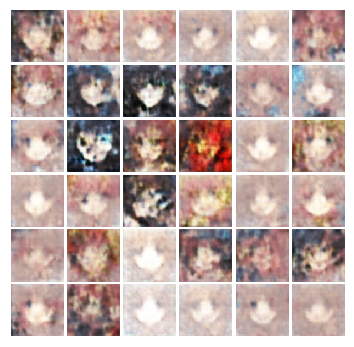


Iter:5600, D:-295.5, G:-21.28
epoch:1121---------------------------------
Iter:5605, D:-285.7, G:-13.14
epoch:1122---------------------------------
Iter:5610, D:-275.3, G:-11.35
epoch:1123---------------------------------
Iter:5615, D:-237.0, G:-6.356
epoch:1124---------------------------------
Iter:5620, D:-313.0, G:-5.966
epoch:1125---------------------------------
Iter:5625, D:-285.0, G:-26.67
epoch:1126---------------------------------
Iter:5630, D:-267.3, G:1.281
epoch:1127---------------------------------
Iter:5635, D:-256.3, G:6.233
epoch:1128---------------------------------
Iter:5640, D:-274.3, G:-47.22
epoch:1129---------------------------------
Iter:5645, D:-274.2, G:-22.93
epoch:1130---------------------------------
Iter:5650, D:-302.5, G:-17.29
epoch:1131---------------------------------
Iter:5655, D:-266.5, G:-10.36
epoch:1132---------------------------------
Iter:5660, D:-222.1, G:-6.532
epoch:1133---------------------------------
Iter:5665, D:-254.6, G:-2.068
epoch:113

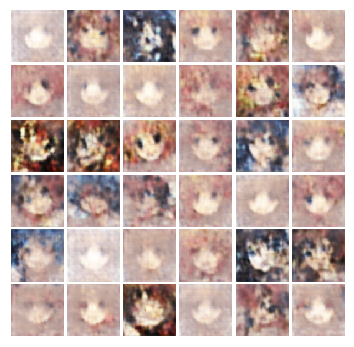


Iter:5800, D:-261.1, G:-13.42
epoch:1161---------------------------------
Iter:5805, D:-272.5, G:-22.55
epoch:1162---------------------------------
Iter:5810, D:-324.7, G:-3.735
epoch:1163---------------------------------
Iter:5815, D:-263.3, G:-9.289
epoch:1164---------------------------------
Iter:5820, D:-232.4, G:5.686
epoch:1165---------------------------------
Iter:5825, D:-206.7, G:-8.076
epoch:1166---------------------------------
Iter:5830, D:-192.8, G:-20.74
epoch:1167---------------------------------
Iter:5835, D:-292.1, G:-26.75
epoch:1168---------------------------------
Iter:5840, D:-274.9, G:-16.13
epoch:1169---------------------------------
Iter:5845, D:-313.7, G:-64.39
epoch:1170---------------------------------
Iter:5850, D:-276.3, G:-9.468
epoch:1171---------------------------------
Iter:5855, D:-288.5, G:-19.58
epoch:1172---------------------------------
Iter:5860, D:-274.3, G:-5.118
epoch:1173---------------------------------
Iter:5865, D:-370.8, G:-32.74
epoch:11

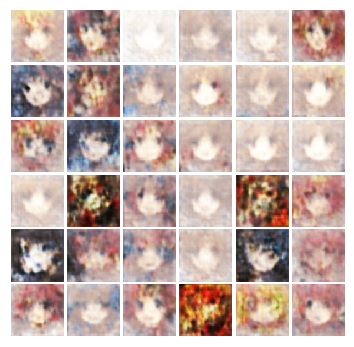


Iter:6000, D:-306.0, G:-20.67
epoch:1201---------------------------------
Iter:6005, D:-250.7, G:-17.77
epoch:1202---------------------------------
Iter:6010, D:-266.0, G:-4.444
epoch:1203---------------------------------
Iter:6015, D:-292.2, G:-2.556
epoch:1204---------------------------------
Iter:6020, D:-254.7, G:-3.755
epoch:1205---------------------------------
Iter:6025, D:-279.7, G:-26.99
epoch:1206---------------------------------
Iter:6030, D:-158.6, G:-2.745
epoch:1207---------------------------------
Iter:6035, D:-236.8, G:-16.79
epoch:1208---------------------------------
Iter:6040, D:-226.2, G:-10.98
epoch:1209---------------------------------
Iter:6045, D:-245.8, G:-5.458
epoch:1210---------------------------------
Iter:6050, D:-248.6, G:-15.92
epoch:1211---------------------------------
Iter:6055, D:-293.7, G:-25.58
epoch:1212---------------------------------
Iter:6060, D:-206.8, G:-9.466
epoch:1213---------------------------------
Iter:6065, D:-242.6, G:-17.7
epoch:12

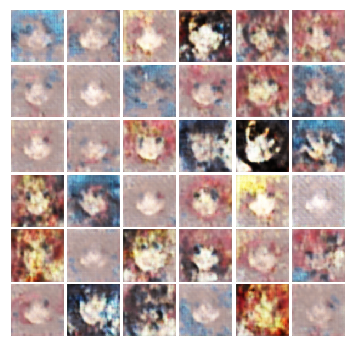


Iter:6200, D:-195.9, G:-9.758
epoch:1241---------------------------------
Iter:6205, D:-190.3, G:-2.252
epoch:1242---------------------------------
Iter:6210, D:-242.3, G:-14.09
epoch:1243---------------------------------
Iter:6215, D:-196.5, G:-5.273
epoch:1244---------------------------------
Iter:6220, D:-210.7, G:-9.484
epoch:1245---------------------------------
Iter:6225, D:-208.7, G:-5.478
epoch:1246---------------------------------
Iter:6230, D:-259.3, G:-31.62
epoch:1247---------------------------------
Iter:6235, D:-222.0, G:-16.8
epoch:1248---------------------------------
Iter:6240, D:-261.4, G:-15.95
epoch:1249---------------------------------
Iter:6245, D:-286.0, G:-29.63
epoch:1250---------------------------------
Iter:6250, D:-246.9, G:-14.96
epoch:1251---------------------------------
Iter:6255, D:-246.4, G:-23.55
epoch:1252---------------------------------
Iter:6260, D:-216.5, G:-8.821
epoch:1253---------------------------------
Iter:6265, D:-244.9, G:-19.66
epoch:12

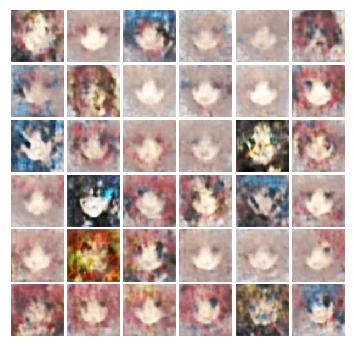


Iter:6400, D:-275.8, G:-24.21
epoch:1281---------------------------------
Iter:6405, D:-197.8, G:-15.96
epoch:1282---------------------------------
Iter:6410, D:-203.4, G:-14.91
epoch:1283---------------------------------
Iter:6415, D:-269.9, G:-27.54
epoch:1284---------------------------------
Iter:6420, D:-260.7, G:-10.0
epoch:1285---------------------------------
Iter:6425, D:-284.0, G:-9.586
epoch:1286---------------------------------
Iter:6430, D:-262.8, G:4.178
epoch:1287---------------------------------
Iter:6435, D:-271.0, G:-13.47
epoch:1288---------------------------------
Iter:6440, D:-296.4, G:-13.11
epoch:1289---------------------------------
Iter:6445, D:-224.3, G:-12.45
epoch:1290---------------------------------
Iter:6450, D:-250.2, G:-6.961
epoch:1291---------------------------------
Iter:6455, D:-185.0, G:9.336
epoch:1292---------------------------------
Iter:6460, D:-244.6, G:-20.83
epoch:1293---------------------------------
Iter:6465, D:-343.7, G:-37.36
epoch:1294

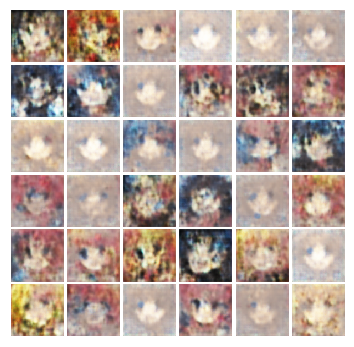


Iter:6600, D:-235.3, G:-8.667
epoch:1321---------------------------------
Iter:6605, D:-288.9, G:-28.56
epoch:1322---------------------------------
Iter:6610, D:-234.4, G:-16.2
epoch:1323---------------------------------
Iter:6615, D:-243.3, G:-8.529
epoch:1324---------------------------------
Iter:6620, D:-285.7, G:-30.45
epoch:1325---------------------------------
Iter:6625, D:-242.7, G:-12.42
epoch:1326---------------------------------
Iter:6630, D:-380.1, G:-39.44
epoch:1327---------------------------------
Iter:6635, D:-321.4, G:-31.0
epoch:1328---------------------------------
Iter:6640, D:-270.1, G:-8.381
epoch:1329---------------------------------
Iter:6645, D:-294.7, G:-11.61
epoch:1330---------------------------------
Iter:6650, D:-258.0, G:7.391
epoch:1331---------------------------------
Iter:6655, D:-258.1, G:-30.39
epoch:1332---------------------------------
Iter:6660, D:-250.5, G:-3.881
epoch:1333---------------------------------
Iter:6665, D:-295.7, G:-13.36
epoch:1334

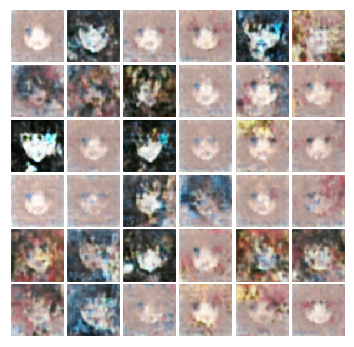


Iter:6800, D:-242.2, G:-21.81
epoch:1361---------------------------------
Iter:6805, D:-302.9, G:-34.75
epoch:1362---------------------------------
Iter:6810, D:-211.9, G:-10.32
epoch:1363---------------------------------
Iter:6815, D:-210.4, G:-10.31
epoch:1364---------------------------------
Iter:6820, D:-255.8, G:-6.537
epoch:1365---------------------------------
Iter:6825, D:-255.8, G:-20.82
epoch:1366---------------------------------
Iter:6830, D:-226.5, G:-15.67
epoch:1367---------------------------------
Iter:6835, D:-195.5, G:-7.031
epoch:1368---------------------------------
Iter:6840, D:-233.0, G:-5.521
epoch:1369---------------------------------
Iter:6845, D:-235.3, G:-7.414
epoch:1370---------------------------------
Iter:6850, D:-234.6, G:-19.35
epoch:1371---------------------------------
Iter:6855, D:-260.0, G:-14.27
epoch:1372---------------------------------
Iter:6860, D:-266.1, G:-5.116
epoch:1373---------------------------------
Iter:6865, D:-199.2, G:-1.833
epoch:1

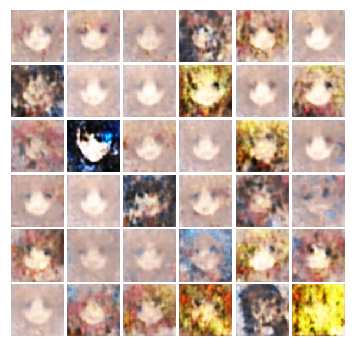


Iter:7000, D:-254.3, G:-3.216
epoch:1401---------------------------------
Iter:7005, D:-218.4, G:-9.625
epoch:1402---------------------------------
Iter:7010, D:-267.8, G:-19.79
epoch:1403---------------------------------
Iter:7015, D:-225.0, G:-15.51
epoch:1404---------------------------------
Iter:7020, D:-229.6, G:-11.93
epoch:1405---------------------------------
Iter:7025, D:-250.0, G:-27.77
epoch:1406---------------------------------
Iter:7030, D:-307.7, G:-22.31
epoch:1407---------------------------------
Iter:7035, D:-225.4, G:-8.099
epoch:1408---------------------------------
Iter:7040, D:-250.7, G:-22.55
epoch:1409---------------------------------
Iter:7045, D:-298.5, G:-21.79
epoch:1410---------------------------------
Iter:7050, D:-221.0, G:3.75
epoch:1411---------------------------------
Iter:7055, D:-283.2, G:-24.54
epoch:1412---------------------------------
Iter:7060, D:-288.9, G:-27.15
epoch:1413---------------------------------
Iter:7065, D:-289.5, G:-11.81
epoch:141

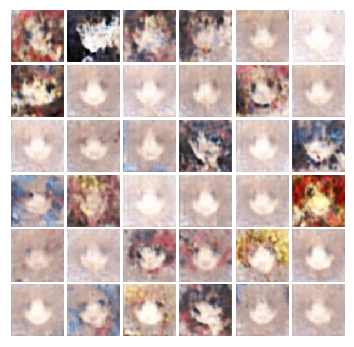


Iter:7200, D:-311.6, G:-7.808
epoch:1441---------------------------------
Iter:7205, D:-203.6, G:4.988
epoch:1442---------------------------------
Iter:7210, D:-278.4, G:-10.78
epoch:1443---------------------------------
Iter:7215, D:-228.0, G:-7.434
epoch:1444---------------------------------
Iter:7220, D:-335.5, G:-37.75
epoch:1445---------------------------------
Iter:7225, D:-212.2, G:-7.421
epoch:1446---------------------------------
Iter:7230, D:-236.4, G:-0.6063
epoch:1447---------------------------------
Iter:7235, D:-255.2, G:-15.13
epoch:1448---------------------------------
Iter:7240, D:-312.2, G:-42.83
epoch:1449---------------------------------
Iter:7245, D:-218.0, G:-18.07
epoch:1450---------------------------------
Iter:7250, D:-240.9, G:3.295
epoch:1451---------------------------------
Iter:7255, D:-294.9, G:-22.38
epoch:1452---------------------------------
Iter:7260, D:-235.8, G:-16.04
epoch:1453---------------------------------
Iter:7265, D:-278.4, G:-34.88
epoch:14

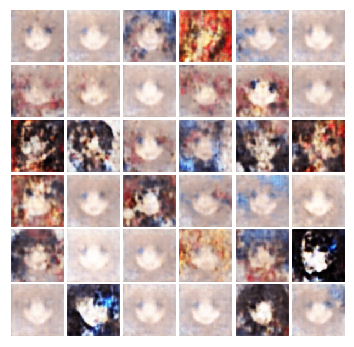


Iter:7400, D:-256.5, G:-9.072
epoch:1481---------------------------------
Iter:7405, D:-302.7, G:-1.041
epoch:1482---------------------------------
Iter:7410, D:-250.4, G:-8.548
epoch:1483---------------------------------
Iter:7415, D:-221.0, G:-7.147
epoch:1484---------------------------------
Iter:7420, D:-236.9, G:-2.414
epoch:1485---------------------------------
Iter:7425, D:-246.3, G:-28.15
epoch:1486---------------------------------
Iter:7430, D:-247.9, G:-10.04
epoch:1487---------------------------------
Iter:7435, D:-253.8, G:-14.99
epoch:1488---------------------------------
Iter:7440, D:-244.9, G:-17.69
epoch:1489---------------------------------
Iter:7445, D:-210.5, G:-8.39
epoch:1490---------------------------------
Iter:7450, D:-223.5, G:-8.357
epoch:1491---------------------------------
Iter:7455, D:-225.8, G:15.99
epoch:1492---------------------------------
Iter:7460, D:-285.3, G:-19.97
epoch:1493---------------------------------
Iter:7465, D:-279.2, G:-28.04
epoch:149

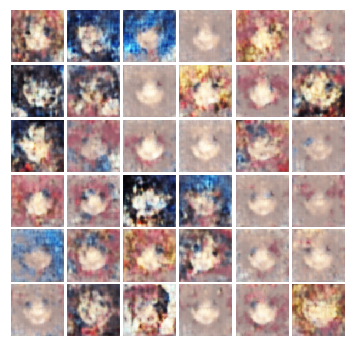


Iter:7600, D:-263.7, G:-14.05
epoch:1521---------------------------------
Iter:7605, D:-259.4, G:-16.49
epoch:1522---------------------------------
Iter:7610, D:-275.1, G:-21.06
epoch:1523---------------------------------
Iter:7615, D:-201.8, G:-4.041
epoch:1524---------------------------------
Iter:7620, D:-286.9, G:-24.88
epoch:1525---------------------------------
Iter:7625, D:-292.1, G:-26.72
epoch:1526---------------------------------
Iter:7630, D:-236.2, G:-7.053
epoch:1527---------------------------------
Iter:7635, D:-235.0, G:-39.85
epoch:1528---------------------------------
Iter:7640, D:-238.7, G:-3.87
epoch:1529---------------------------------
Iter:7645, D:-247.5, G:-4.372
epoch:1530---------------------------------
Iter:7650, D:-235.5, G:-12.71
epoch:1531---------------------------------
Iter:7655, D:-245.3, G:-30.17
epoch:1532---------------------------------
Iter:7660, D:-315.6, G:-21.95
epoch:1533---------------------------------
Iter:7665, D:-257.2, G:-21.66
epoch:15

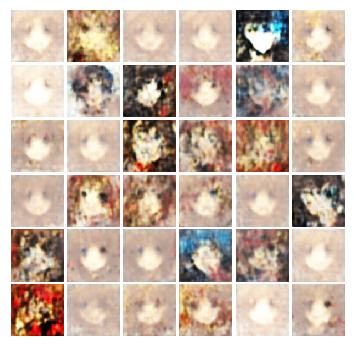


Iter:7800, D:-291.1, G:-21.05
epoch:1561---------------------------------
Iter:7805, D:-250.6, G:-11.09
epoch:1562---------------------------------
Iter:7810, D:-304.6, G:-16.16
epoch:1563---------------------------------
Iter:7815, D:-228.3, G:-9.572
epoch:1564---------------------------------
Iter:7820, D:-245.4, G:-7.325
epoch:1565---------------------------------
Iter:7825, D:-246.1, G:-8.817
epoch:1566---------------------------------
Iter:7830, D:-243.8, G:-6.768
epoch:1567---------------------------------
Iter:7835, D:-256.7, G:-18.78
epoch:1568---------------------------------
Iter:7840, D:-242.6, G:-28.33
epoch:1569---------------------------------
Iter:7845, D:-243.8, G:-20.35
epoch:1570---------------------------------
Iter:7850, D:-301.5, G:-24.85
epoch:1571---------------------------------
Iter:7855, D:-331.7, G:-8.082
epoch:1572---------------------------------
Iter:7860, D:-272.0, G:-13.97
epoch:1573---------------------------------
Iter:7865, D:-275.1, G:-16.1
epoch:15

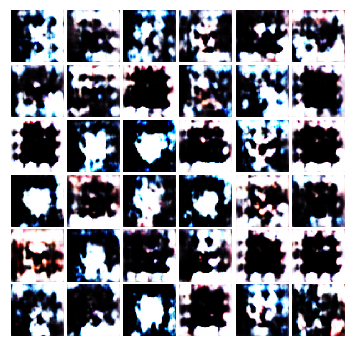


Iter:8000, D:-56.43, G:87.64
epoch:1601---------------------------------
Iter:8005, D:-118.6, G:204.0
epoch:1602---------------------------------
Iter:8010, D:-93.66, G:204.9
epoch:1603---------------------------------
Iter:8015, D:-93.67, G:213.0
epoch:1604---------------------------------
Iter:8020, D:-22.71, G:475.4
epoch:1605---------------------------------
Iter:8025, D:-39.5, G:15.64
epoch:1606---------------------------------
Iter:8030, D:-21.51, G:138.3
epoch:1607---------------------------------
Iter:8035, D:19.67, G:20.33
epoch:1608---------------------------------
Iter:8040, D:-5.311, G:-44.12
epoch:1609---------------------------------
Iter:8045, D:-11.87, G:20.05
epoch:1610---------------------------------
Iter:8050, D:-4.318, G:65.45
epoch:1611---------------------------------
Iter:8055, D:-22.66, G:-14.04
epoch:1612---------------------------------
Iter:8060, D:-39.7, G:-56.06
epoch:1613---------------------------------
Iter:8065, D:-21.08, G:22.88
epoch:1614-----------

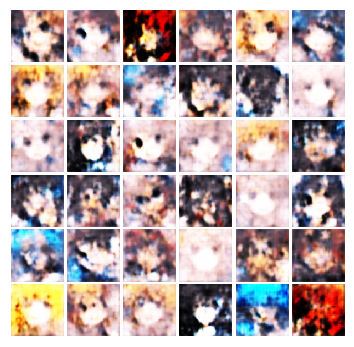


Iter:8200, D:-263.1, G:-52.1
epoch:1641---------------------------------
Iter:8205, D:-256.3, G:-7.88
epoch:1642---------------------------------
Iter:8210, D:-366.9, G:8.691
epoch:1643---------------------------------
Iter:8215, D:-233.9, G:8.748
epoch:1644---------------------------------
Iter:8220, D:-408.3, G:-71.01
epoch:1645---------------------------------
Iter:8225, D:-302.5, G:-54.23
epoch:1646---------------------------------
Iter:8230, D:-403.0, G:-49.05
epoch:1647---------------------------------
Iter:8235, D:-325.8, G:-7.196
epoch:1648---------------------------------
Iter:8240, D:-315.6, G:-24.19
epoch:1649---------------------------------
Iter:8245, D:-363.7, G:-29.22
epoch:1650---------------------------------
Iter:8250, D:-315.3, G:-21.6
epoch:1651---------------------------------
Iter:8255, D:-383.5, G:-16.66
epoch:1652---------------------------------
Iter:8260, D:-395.5, G:-21.44
epoch:1653---------------------------------
Iter:8265, D:-390.5, G:-29.0
epoch:1654---

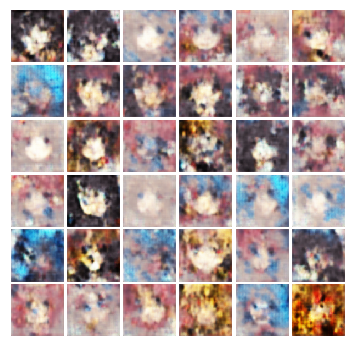


Iter:8400, D:-279.6, G:11.0
epoch:1681---------------------------------
Iter:8405, D:-293.2, G:-14.77
epoch:1682---------------------------------
Iter:8410, D:-257.9, G:7.217
epoch:1683---------------------------------
Iter:8415, D:-263.2, G:5.339
epoch:1684---------------------------------
Iter:8420, D:-208.0, G:3.362
epoch:1685---------------------------------
Iter:8425, D:-279.7, G:-12.39
epoch:1686---------------------------------
Iter:8430, D:-356.5, G:1.294
epoch:1687---------------------------------
Iter:8435, D:-238.2, G:-2.433
epoch:1688---------------------------------
Iter:8440, D:-256.4, G:-8.51
epoch:1689---------------------------------
Iter:8445, D:-224.6, G:15.32
epoch:1690---------------------------------
Iter:8450, D:-269.6, G:-11.87
epoch:1691---------------------------------
Iter:8455, D:-268.5, G:-20.97
epoch:1692---------------------------------
Iter:8460, D:-272.6, G:-21.43
epoch:1693---------------------------------
Iter:8465, D:-310.2, G:4.599
epoch:1694------

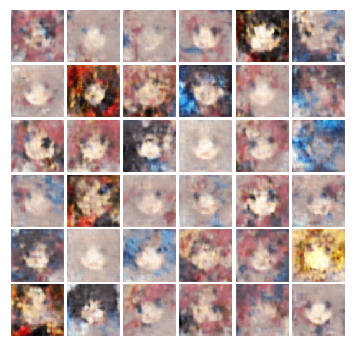


Iter:8600, D:-253.6, G:-11.2
epoch:1721---------------------------------
Iter:8605, D:-282.2, G:-23.7
epoch:1722---------------------------------
Iter:8610, D:-315.1, G:-8.766
epoch:1723---------------------------------
Iter:8615, D:-207.0, G:3.069
epoch:1724---------------------------------
Iter:8620, D:-309.5, G:-25.87
epoch:1725---------------------------------
Iter:8625, D:-277.4, G:-7.587
epoch:1726---------------------------------
Iter:8630, D:-255.2, G:-15.11
epoch:1727---------------------------------
Iter:8635, D:-301.6, G:-32.23
epoch:1728---------------------------------
Iter:8640, D:-312.3, G:-3.712
epoch:1729---------------------------------
Iter:8645, D:-217.4, G:16.16
epoch:1730---------------------------------
Iter:8650, D:-254.3, G:-18.04
epoch:1731---------------------------------
Iter:8655, D:-246.3, G:-10.58
epoch:1732---------------------------------
Iter:8660, D:-243.4, G:-19.3
epoch:1733---------------------------------
Iter:8665, D:-274.2, G:-8.338
epoch:1734--

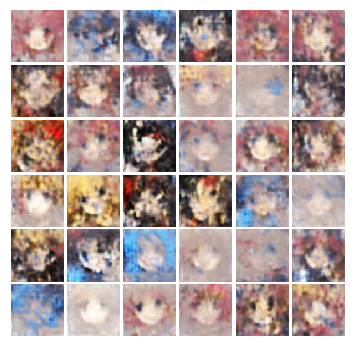


Iter:8800, D:-269.1, G:-25.39
epoch:1761---------------------------------
Iter:8805, D:-266.0, G:-4.678
epoch:1762---------------------------------
Iter:8810, D:-275.0, G:-6.721
epoch:1763---------------------------------
Iter:8815, D:-249.3, G:1.58
epoch:1764---------------------------------
Iter:8820, D:-269.2, G:-10.32
epoch:1765---------------------------------
Iter:8825, D:-278.6, G:-9.536
epoch:1766---------------------------------
Iter:8830, D:-270.3, G:-10.02
epoch:1767---------------------------------
Iter:8835, D:-230.2, G:-6.32
epoch:1768---------------------------------
Iter:8840, D:-233.5, G:-1.052
epoch:1769---------------------------------
Iter:8845, D:-265.3, G:-10.12
epoch:1770---------------------------------
Iter:8850, D:-208.2, G:9.727
epoch:1771---------------------------------
Iter:8855, D:-228.8, G:-3.288
epoch:1772---------------------------------
Iter:8860, D:-201.0, G:-1.533
epoch:1773---------------------------------
Iter:8865, D:-260.9, G:1.232
epoch:1774--

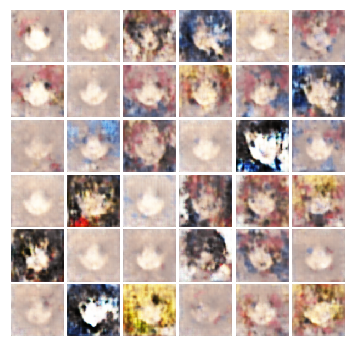


Iter:9000, D:-298.7, G:0.6537
epoch:1801---------------------------------
Iter:9005, D:-258.0, G:7.725
epoch:1802---------------------------------
Iter:9010, D:-263.9, G:-6.778
epoch:1803---------------------------------
Iter:9015, D:-209.2, G:6.907
epoch:1804---------------------------------
Iter:9020, D:-335.7, G:-15.38
epoch:1805---------------------------------
Iter:9025, D:-231.3, G:-2.792
epoch:1806---------------------------------
Iter:9030, D:-225.4, G:-3.198
epoch:1807---------------------------------
Iter:9035, D:-263.7, G:-2.958
epoch:1808---------------------------------
Iter:9040, D:-211.4, G:-2.835
epoch:1809---------------------------------
Iter:9045, D:-244.5, G:-5.799
epoch:1810---------------------------------
Iter:9050, D:-272.8, G:-20.27
epoch:1811---------------------------------
Iter:9055, D:-265.4, G:-16.85
epoch:1812---------------------------------
Iter:9060, D:-299.8, G:-1.125
epoch:1813---------------------------------
Iter:9065, D:-286.2, G:-9.545
epoch:181

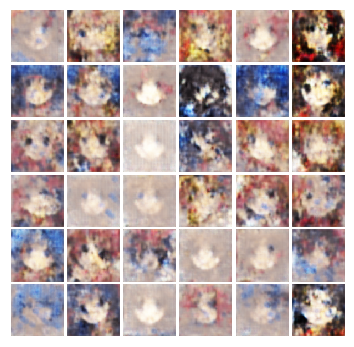


Iter:9200, D:-259.6, G:5.618
epoch:1841---------------------------------
Iter:9205, D:-313.4, G:-17.45
epoch:1842---------------------------------
Iter:9210, D:-231.7, G:-5.405
epoch:1843---------------------------------
Iter:9215, D:-279.9, G:-7.219
epoch:1844---------------------------------
Iter:9220, D:-260.3, G:-3.744
epoch:1845---------------------------------
Iter:9225, D:-196.8, G:-3.065
epoch:1846---------------------------------
Iter:9230, D:-264.7, G:-2.458
epoch:1847---------------------------------
Iter:9235, D:-243.1, G:2.477
epoch:1848---------------------------------
Iter:9240, D:-293.4, G:-14.28
epoch:1849---------------------------------
Iter:9245, D:-254.7, G:0.8667
epoch:1850---------------------------------
Iter:9250, D:-270.8, G:-18.27
epoch:1851---------------------------------
Iter:9255, D:-276.2, G:-22.59
epoch:1852---------------------------------
Iter:9260, D:-278.5, G:-18.06
epoch:1853---------------------------------
Iter:9265, D:-251.7, G:-0.2266
epoch:18

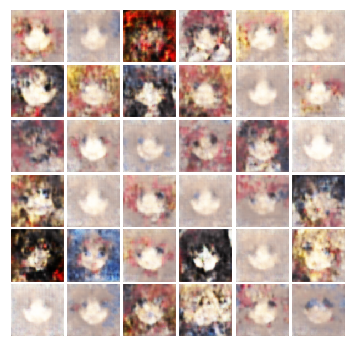


Iter:9400, D:-223.2, G:2.274
epoch:1881---------------------------------
Iter:9405, D:-239.6, G:-6.004
epoch:1882---------------------------------
Iter:9410, D:-281.3, G:-6.13
epoch:1883---------------------------------
Iter:9415, D:-190.2, G:1.616
epoch:1884---------------------------------
Iter:9420, D:-242.1, G:-11.4
epoch:1885---------------------------------
Iter:9425, D:-239.2, G:7.424
epoch:1886---------------------------------
Iter:9430, D:-247.6, G:-8.252
epoch:1887---------------------------------
Iter:9435, D:-242.4, G:3.854
epoch:1888---------------------------------
Iter:9440, D:-226.9, G:-5.944
epoch:1889---------------------------------
Iter:9445, D:-249.7, G:2.009
epoch:1890---------------------------------
Iter:9450, D:-229.3, G:-3.85
epoch:1891---------------------------------
Iter:9455, D:-277.4, G:-21.99
epoch:1892---------------------------------
Iter:9460, D:-297.7, G:-9.931
epoch:1893---------------------------------
Iter:9465, D:-226.9, G:4.891
epoch:1894------

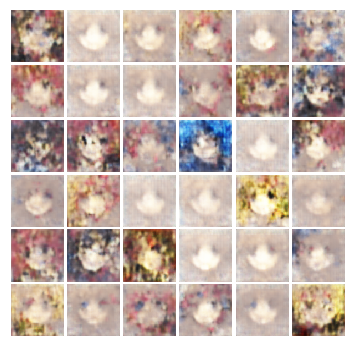


Iter:9600, D:-309.7, G:-17.61
epoch:1921---------------------------------
Iter:9605, D:-246.1, G:-4.316
epoch:1922---------------------------------
Iter:9610, D:-258.2, G:-2.575
epoch:1923---------------------------------
Iter:9615, D:-214.6, G:1.801
epoch:1924---------------------------------
Iter:9620, D:-213.7, G:4.739
epoch:1925---------------------------------
Iter:9625, D:-263.5, G:-2.636
epoch:1926---------------------------------
Iter:9630, D:-236.9, G:-0.8728
epoch:1927---------------------------------
Iter:9635, D:-304.6, G:-12.79
epoch:1928---------------------------------
Iter:9640, D:-202.3, G:-6.417
epoch:1929---------------------------------
Iter:9645, D:-270.9, G:-2.842
epoch:1930---------------------------------
Iter:9650, D:-280.1, G:-6.114
epoch:1931---------------------------------
Iter:9655, D:-204.4, G:0.6341
epoch:1932---------------------------------
Iter:9660, D:-251.3, G:-15.55
epoch:1933---------------------------------
Iter:9665, D:-298.5, G:-19.56
epoch:19

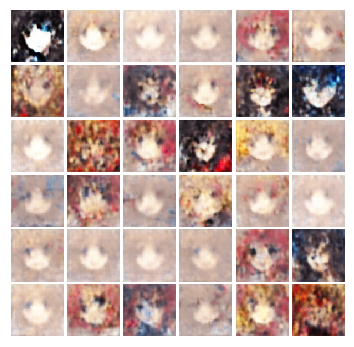


Iter:9800, D:-216.4, G:-6.127
epoch:1961---------------------------------
Iter:9805, D:-325.7, G:-20.03
epoch:1962---------------------------------
Iter:9810, D:-268.6, G:11.29
epoch:1963---------------------------------
Iter:9815, D:-268.6, G:5.181
epoch:1964---------------------------------
Iter:9820, D:-178.9, G:5.608
epoch:1965---------------------------------
Iter:9825, D:-264.4, G:-14.46
epoch:1966---------------------------------
Iter:9830, D:-277.4, G:-11.26
epoch:1967---------------------------------
Iter:9835, D:-315.0, G:-14.15
epoch:1968---------------------------------
Iter:9840, D:-206.8, G:9.728
epoch:1969---------------------------------
Iter:9845, D:-210.5, G:5.408
epoch:1970---------------------------------
Iter:9850, D:-263.0, G:-9.342
epoch:1971---------------------------------
Iter:9855, D:-263.6, G:-12.11
epoch:1972---------------------------------
Iter:9860, D:-252.1, G:-9.711
epoch:1973---------------------------------
Iter:9865, D:-245.0, G:12.11
epoch:1974---

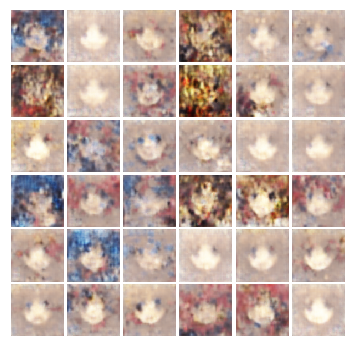


Iter:10000, D:-248.1, G:-3.132
epoch:2001---------------------------------
Iter:10005, D:-273.2, G:-4.867
epoch:2002---------------------------------
Iter:10010, D:-238.3, G:-6.9
epoch:2003---------------------------------
Iter:10015, D:-246.8, G:6.929
epoch:2004---------------------------------
Iter:10020, D:-299.6, G:-24.99
epoch:2005---------------------------------
Iter:10025, D:-232.3, G:-12.75
epoch:2006---------------------------------
Iter:10030, D:-222.4, G:5.641
epoch:2007---------------------------------
Iter:10035, D:-243.0, G:-2.224
epoch:2008---------------------------------
Iter:10040, D:-261.9, G:1.426
epoch:2009---------------------------------
Iter:10045, D:-255.4, G:-2.703
epoch:2010---------------------------------
Iter:10050, D:-253.2, G:-6.135
epoch:2011---------------------------------
Iter:10055, D:-287.0, G:-15.86
epoch:2012---------------------------------
Iter:10060, D:-296.6, G:-11.89
epoch:2013---------------------------------
Iter:10065, D:-207.9, G:16.75

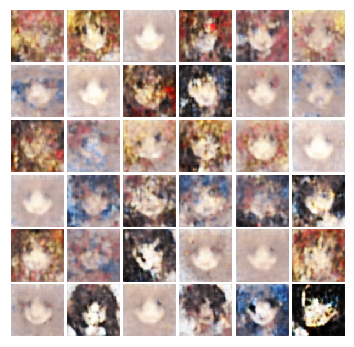


Iter:10200, D:-270.2, G:-12.93
epoch:2041---------------------------------
Iter:10205, D:-273.7, G:-1.947
epoch:2042---------------------------------
Iter:10210, D:-213.6, G:-7.361
epoch:2043---------------------------------
Iter:10215, D:-259.6, G:-7.433
epoch:2044---------------------------------
Iter:10220, D:-271.1, G:1.394
epoch:2045---------------------------------
Iter:10225, D:-286.6, G:-2.685
epoch:2046---------------------------------
Iter:10230, D:-211.7, G:-3.613
epoch:2047---------------------------------
Iter:10235, D:-243.7, G:-5.899
epoch:2048---------------------------------
Iter:10240, D:-217.8, G:-2.358
epoch:2049---------------------------------
Iter:10245, D:-244.2, G:-16.32
epoch:2050---------------------------------
Iter:10250, D:-212.3, G:-2.587
epoch:2051---------------------------------
Iter:10255, D:-263.4, G:13.73
epoch:2052---------------------------------
Iter:10260, D:-272.2, G:-17.86
epoch:2053---------------------------------
Iter:10265, D:-264.7, G:10

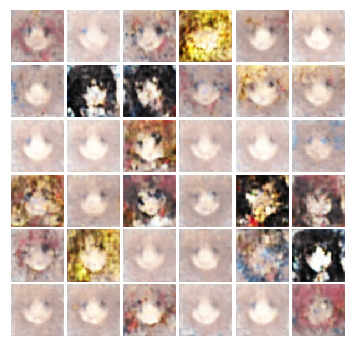


Iter:10400, D:-240.9, G:-13.69
epoch:2081---------------------------------
Iter:10405, D:-277.8, G:15.62
epoch:2082---------------------------------
Iter:10410, D:-283.4, G:-7.524
epoch:2083---------------------------------
Iter:10415, D:-252.6, G:-18.22
epoch:2084---------------------------------
Iter:10420, D:-279.7, G:8.854
epoch:2085---------------------------------
Iter:10425, D:-215.6, G:-9.272
epoch:2086---------------------------------
Iter:10430, D:-220.3, G:5.098
epoch:2087---------------------------------
Iter:10435, D:-264.7, G:-7.803
epoch:2088---------------------------------
Iter:10440, D:-246.8, G:-5.469
epoch:2089---------------------------------
Iter:10445, D:-281.4, G:5.764
epoch:2090---------------------------------
Iter:10450, D:-232.2, G:-0.4612
epoch:2091---------------------------------
Iter:10455, D:-255.2, G:4.174
epoch:2092---------------------------------
Iter:10460, D:-264.2, G:-22.88
epoch:2093---------------------------------
Iter:10465, D:-276.6, G:-11.

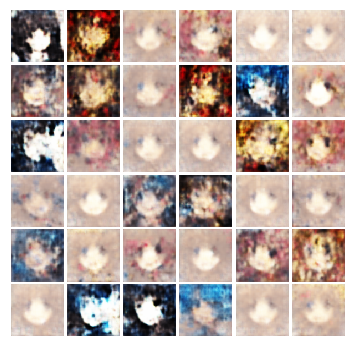


Iter:10600, D:-240.2, G:10.41
epoch:2121---------------------------------
Iter:10605, D:-261.9, G:-0.5558
epoch:2122---------------------------------
Iter:10610, D:-312.3, G:-9.071
epoch:2123---------------------------------
Iter:10615, D:-271.8, G:-15.01
epoch:2124---------------------------------
Iter:10620, D:-223.9, G:-2.258
epoch:2125---------------------------------
Iter:10625, D:-321.3, G:-14.25
epoch:2126---------------------------------
Iter:10630, D:-217.9, G:-7.218
epoch:2127---------------------------------
Iter:10635, D:-259.2, G:-4.29
epoch:2128---------------------------------
Iter:10640, D:-178.2, G:28.09
epoch:2129---------------------------------
Iter:10645, D:-232.1, G:-4.626
epoch:2130---------------------------------
Iter:10650, D:-256.8, G:6.0
epoch:2131---------------------------------
Iter:10655, D:-246.4, G:0.5457
epoch:2132---------------------------------
Iter:10660, D:-264.4, G:-4.016
epoch:2133---------------------------------
Iter:10665, D:-270.4, G:-7.10

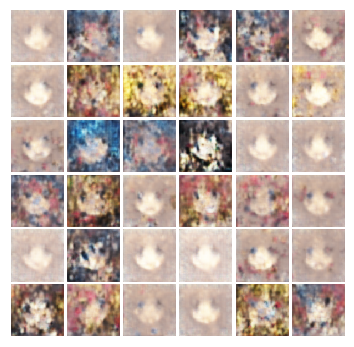


Iter:10800, D:-248.0, G:-8.562
epoch:2161---------------------------------
Iter:10805, D:-242.7, G:17.8
epoch:2162---------------------------------
Iter:10810, D:-248.7, G:-19.66
epoch:2163---------------------------------
Iter:10815, D:-251.6, G:-17.51
epoch:2164---------------------------------
Iter:10820, D:-284.4, G:2.083
epoch:2165---------------------------------
Iter:10825, D:-228.9, G:4.403
epoch:2166---------------------------------
Iter:10830, D:-319.3, G:-17.07
epoch:2167---------------------------------
Iter:10835, D:-222.2, G:12.16
epoch:2168---------------------------------
Iter:10840, D:-199.7, G:-0.5732
epoch:2169---------------------------------
Iter:10845, D:-284.1, G:-16.68
epoch:2170---------------------------------
Iter:10850, D:-269.4, G:-6.954
epoch:2171---------------------------------
Iter:10855, D:-264.0, G:-8.401
epoch:2172---------------------------------
Iter:10860, D:-229.9, G:8.711
epoch:2173---------------------------------
Iter:10865, D:-286.8, G:-30.6

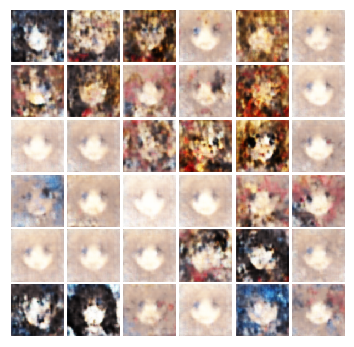


Iter:11000, D:-306.3, G:2.421
epoch:2201---------------------------------
Iter:11005, D:-292.3, G:-5.525
epoch:2202---------------------------------
Iter:11010, D:-213.4, G:2.386
epoch:2203---------------------------------
Iter:11015, D:-271.2, G:-3.997
epoch:2204---------------------------------
Iter:11020, D:-334.7, G:-14.14
epoch:2205---------------------------------
Iter:11025, D:-325.0, G:-37.11
epoch:2206---------------------------------
Iter:11030, D:-274.8, G:-6.37
epoch:2207---------------------------------
Iter:11035, D:-259.4, G:1.7
epoch:2208---------------------------------
Iter:11040, D:-247.6, G:-7.406
epoch:2209---------------------------------
Iter:11045, D:-264.1, G:-0.5239
epoch:2210---------------------------------
Iter:11050, D:-265.4, G:-9.858
epoch:2211---------------------------------
Iter:11055, D:-272.3, G:0.7379
epoch:2212---------------------------------
Iter:11060, D:-279.8, G:-16.69
epoch:2213---------------------------------
Iter:11065, D:-253.1, G:-9.13

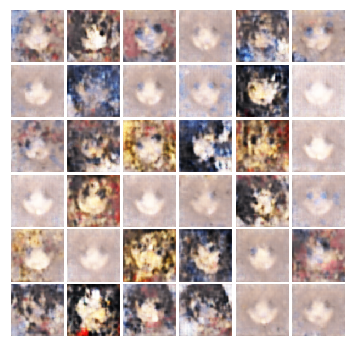


Iter:11200, D:-308.0, G:-33.38
epoch:2241---------------------------------
Iter:11205, D:-232.5, G:24.42
epoch:2242---------------------------------
Iter:11210, D:-261.1, G:-6.73
epoch:2243---------------------------------
Iter:11215, D:-217.6, G:-11.87
epoch:2244---------------------------------
Iter:11220, D:-260.2, G:16.45
epoch:2245---------------------------------
Iter:11225, D:-318.0, G:2.336
epoch:2246---------------------------------
Iter:11230, D:-205.3, G:-8.74
epoch:2247---------------------------------
Iter:11235, D:-247.3, G:-5.608
epoch:2248---------------------------------
Iter:11240, D:-336.2, G:-34.06
epoch:2249---------------------------------
Iter:11245, D:-284.7, G:0.4409
epoch:2250---------------------------------
Iter:11250, D:-231.6, G:-2.862
epoch:2251---------------------------------
Iter:11255, D:-286.7, G:-8.492
epoch:2252---------------------------------
Iter:11260, D:-243.2, G:-10.48
epoch:2253---------------------------------
Iter:11265, D:-303.2, G:-6.96

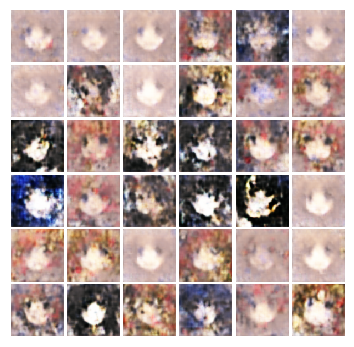


Iter:11400, D:-224.8, G:0.6908
epoch:2281---------------------------------
Iter:11405, D:-241.2, G:-2.896
epoch:2282---------------------------------
Iter:11410, D:-288.1, G:-13.13
epoch:2283---------------------------------
Iter:11415, D:-335.5, G:-6.748
epoch:2284---------------------------------
Iter:11420, D:-269.0, G:-12.65
epoch:2285---------------------------------
Iter:11425, D:-244.6, G:-5.765
epoch:2286---------------------------------
Iter:11430, D:-293.6, G:-7.886
epoch:2287---------------------------------
Iter:11435, D:-251.5, G:-0.3231
epoch:2288---------------------------------
Iter:11440, D:-245.3, G:-14.51
epoch:2289---------------------------------
Iter:11445, D:-267.0, G:-5.901
epoch:2290---------------------------------
Iter:11450, D:-333.3, G:19.04
epoch:2291---------------------------------
Iter:11455, D:-294.9, G:2.82
epoch:2292---------------------------------
Iter:11460, D:-293.8, G:-13.86
epoch:2293---------------------------------
Iter:11465, D:-201.6, G:4.

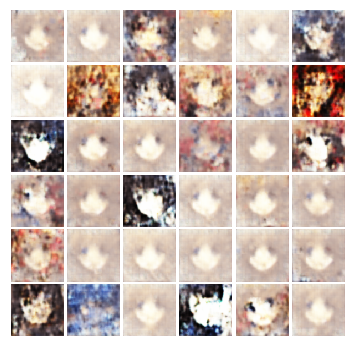


Iter:11600, D:-263.4, G:5.897
epoch:2321---------------------------------
Iter:11605, D:-239.8, G:10.29
epoch:2322---------------------------------
Iter:11610, D:-216.0, G:11.91
epoch:2323---------------------------------
Iter:11615, D:-271.3, G:-17.29
epoch:2324---------------------------------
Iter:11620, D:-276.9, G:-24.43
epoch:2325---------------------------------
Iter:11625, D:-232.5, G:1.804
epoch:2326---------------------------------
Iter:11630, D:-176.8, G:15.84
epoch:2327---------------------------------
Iter:11635, D:-243.2, G:2.215
epoch:2328---------------------------------
Iter:11640, D:-300.8, G:-12.51
epoch:2329---------------------------------
Iter:11645, D:-256.7, G:-5.435
epoch:2330---------------------------------
Iter:11650, D:-252.2, G:-2.503
epoch:2331---------------------------------
Iter:11655, D:-212.1, G:-6.275
epoch:2332---------------------------------
Iter:11660, D:-325.4, G:-32.32
epoch:2333---------------------------------
Iter:11665, D:-299.3, G:-26.85

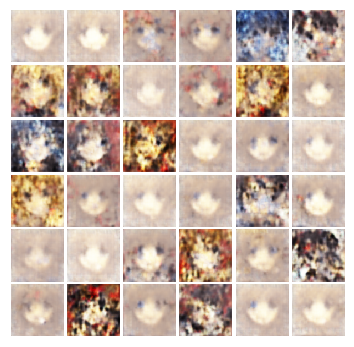


Iter:11800, D:-291.2, G:-22.4
epoch:2361---------------------------------
Iter:11805, D:-247.3, G:9.708
epoch:2362---------------------------------
Iter:11810, D:-313.5, G:-15.33
epoch:2363---------------------------------
Iter:11815, D:-233.6, G:15.64
epoch:2364---------------------------------
Iter:11820, D:-263.8, G:-18.71
epoch:2365---------------------------------
Iter:11825, D:-254.8, G:-0.4632
epoch:2366---------------------------------
Iter:11830, D:-254.8, G:7.123
epoch:2367---------------------------------
Iter:11835, D:-253.2, G:-9.435
epoch:2368---------------------------------
Iter:11840, D:-265.2, G:-4.662
epoch:2369---------------------------------
Iter:11845, D:-224.1, G:5.857
epoch:2370---------------------------------
Iter:11850, D:-217.3, G:13.65
epoch:2371---------------------------------
Iter:11855, D:-297.4, G:-8.138
epoch:2372---------------------------------
Iter:11860, D:-213.7, G:-4.766
epoch:2373---------------------------------
Iter:11865, D:-205.8, G:7.425

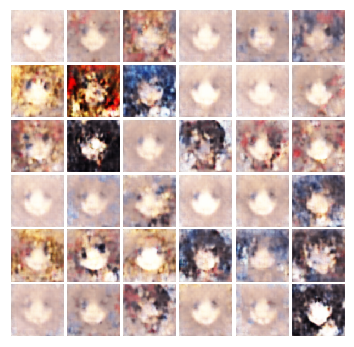


Iter:12000, D:-246.4, G:12.86
epoch:2401---------------------------------
Iter:12005, D:-307.5, G:-4.372
epoch:2402---------------------------------
Iter:12010, D:-228.3, G:19.06
epoch:2403---------------------------------
Iter:12015, D:-271.6, G:0.4246
epoch:2404---------------------------------
Iter:12020, D:-281.8, G:-0.1306
epoch:2405---------------------------------
Iter:12025, D:-231.0, G:3.922
epoch:2406---------------------------------
Iter:12030, D:-321.1, G:-31.54
epoch:2407---------------------------------
Iter:12035, D:-296.0, G:-43.48
epoch:2408---------------------------------
Iter:12040, D:-285.4, G:2.158
epoch:2409---------------------------------
Iter:12045, D:-294.0, G:-10.85
epoch:2410---------------------------------
Iter:12050, D:-246.4, G:10.84
epoch:2411---------------------------------
Iter:12055, D:-258.9, G:6.376
epoch:2412---------------------------------
Iter:12060, D:-253.6, G:-12.71
epoch:2413---------------------------------
Iter:12065, D:-261.4, G:13.63

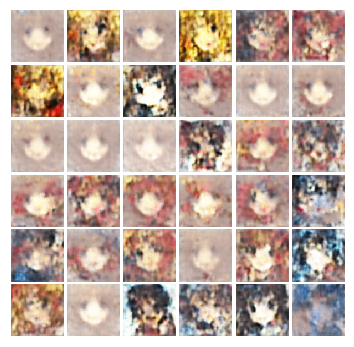


Iter:12200, D:-314.9, G:-28.94
epoch:2441---------------------------------
Iter:12205, D:-313.7, G:-17.27
epoch:2442---------------------------------
Iter:12210, D:-276.4, G:-11.39
epoch:2443---------------------------------
Iter:12215, D:-237.3, G:-6.983
epoch:2444---------------------------------
Iter:12220, D:-237.5, G:0.6925
epoch:2445---------------------------------
Iter:12225, D:-266.4, G:-3.817
epoch:2446---------------------------------
Iter:12230, D:-253.8, G:-20.33
epoch:2447---------------------------------
Iter:12235, D:-288.5, G:-20.4
epoch:2448---------------------------------
Iter:12240, D:-218.6, G:5.83
epoch:2449---------------------------------
Iter:12245, D:-207.2, G:-1.932
epoch:2450---------------------------------
Iter:12250, D:-253.0, G:1.517
epoch:2451---------------------------------
Iter:12255, D:-258.3, G:1.018
epoch:2452---------------------------------
Iter:12260, D:-276.5, G:-18.98
epoch:2453---------------------------------
Iter:12265, D:-265.5, G:-4.06

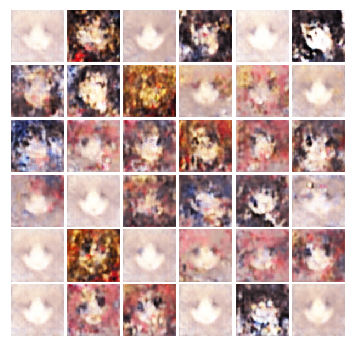


Iter:12400, D:-235.0, G:8.865
epoch:2481---------------------------------
Iter:12405, D:-316.2, G:-33.1
epoch:2482---------------------------------
Iter:12410, D:-277.6, G:-6.952
epoch:2483---------------------------------
Iter:12415, D:-240.6, G:-21.31
epoch:2484---------------------------------
Iter:12420, D:-252.8, G:-6.739
epoch:2485---------------------------------
Iter:12425, D:-216.6, G:0.9228
epoch:2486---------------------------------
Iter:12430, D:-295.6, G:-11.67
epoch:2487---------------------------------
Iter:12435, D:-196.3, G:19.43
epoch:2488---------------------------------
Iter:12440, D:-273.1, G:-8.019
epoch:2489---------------------------------
Iter:12445, D:-207.2, G:5.36
epoch:2490---------------------------------
Iter:12450, D:-239.8, G:-3.311
epoch:2491---------------------------------
Iter:12455, D:-279.6, G:-0.5536
epoch:2492---------------------------------
Iter:12460, D:-201.5, G:-9.66
epoch:2493---------------------------------
Iter:12465, D:-224.8, G:-13.0

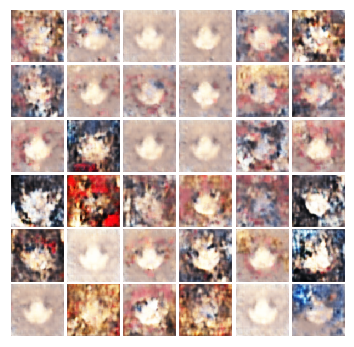


Iter:12600, D:-272.1, G:1.297
epoch:2521---------------------------------
Iter:12605, D:-245.9, G:3.775
epoch:2522---------------------------------
Iter:12610, D:-213.2, G:-6.832
epoch:2523---------------------------------
Iter:12615, D:-259.7, G:1.586
epoch:2524---------------------------------
Iter:12620, D:-244.2, G:-4.322
epoch:2525---------------------------------
Iter:12625, D:-257.8, G:-1.292
epoch:2526---------------------------------
Iter:12630, D:-245.8, G:3.406
epoch:2527---------------------------------
Iter:12635, D:-297.5, G:-24.8
epoch:2528---------------------------------
Iter:12640, D:-256.1, G:-4.485
epoch:2529---------------------------------
Iter:12645, D:-278.6, G:-11.58
epoch:2530---------------------------------
Iter:12650, D:-306.0, G:-22.16
epoch:2531---------------------------------
Iter:12655, D:-310.4, G:-6.276
epoch:2532---------------------------------
Iter:12660, D:-258.7, G:-1.886
epoch:2533---------------------------------
Iter:12665, D:-230.5, G:5.632

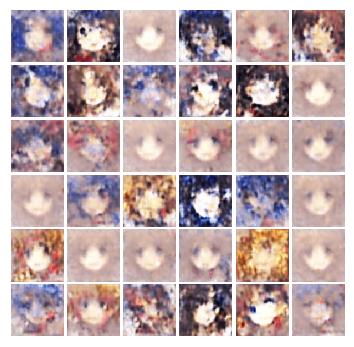


Iter:12800, D:-210.9, G:12.81
epoch:2561---------------------------------
Iter:12805, D:-235.4, G:-4.064
epoch:2562---------------------------------
Iter:12810, D:-281.7, G:-6.294
epoch:2563---------------------------------
Iter:12815, D:-241.3, G:1.685
epoch:2564---------------------------------
Iter:12820, D:-260.6, G:-14.58
epoch:2565---------------------------------
Iter:12825, D:-235.4, G:-2.97
epoch:2566---------------------------------
Iter:12830, D:-315.7, G:-22.66
epoch:2567---------------------------------
Iter:12835, D:-257.2, G:7.908
epoch:2568---------------------------------
Iter:12840, D:-245.6, G:-10.98
epoch:2569---------------------------------
Iter:12845, D:-277.0, G:-11.81
epoch:2570---------------------------------
Iter:12850, D:-307.0, G:10.38
epoch:2571---------------------------------
Iter:12855, D:-286.6, G:-22.99
epoch:2572---------------------------------
Iter:12860, D:-295.6, G:-8.187
epoch:2573---------------------------------
Iter:12865, D:-257.4, G:-16.0

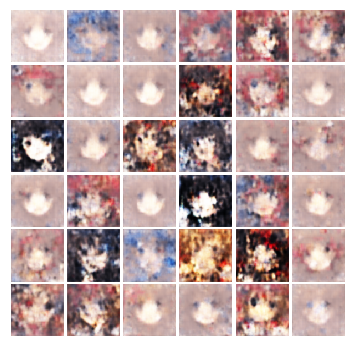


Iter:13000, D:-239.3, G:2.566
epoch:2601---------------------------------
Iter:13005, D:-330.1, G:-11.06
epoch:2602---------------------------------
Iter:13010, D:-216.0, G:-1.877
epoch:2603---------------------------------
Iter:13015, D:-255.8, G:-6.281
epoch:2604---------------------------------
Iter:13020, D:-301.2, G:-18.43
epoch:2605---------------------------------
Iter:13025, D:-255.8, G:-15.13
epoch:2606---------------------------------
Iter:13030, D:-246.4, G:-13.53
epoch:2607---------------------------------
Iter:13035, D:-175.8, G:5.213
epoch:2608---------------------------------
Iter:13040, D:-283.7, G:-22.08
epoch:2609---------------------------------
Iter:13045, D:-236.9, G:-4.435
epoch:2610---------------------------------
Iter:13050, D:-243.1, G:-3.99
epoch:2611---------------------------------
Iter:13055, D:-273.9, G:-2.544
epoch:2612---------------------------------
Iter:13060, D:-300.9, G:-40.69
epoch:2613---------------------------------
Iter:13065, D:-320.8, G:-15

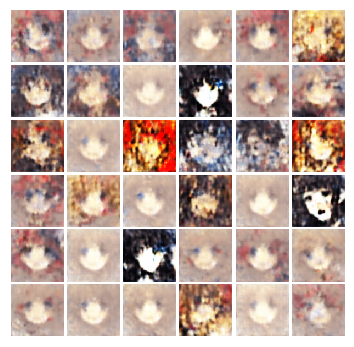


Iter:13200, D:-242.4, G:-1.112
epoch:2641---------------------------------
Iter:13205, D:-187.3, G:-1.162
epoch:2642---------------------------------
Iter:13210, D:-214.5, G:-6.129
epoch:2643---------------------------------
Iter:13215, D:-262.2, G:-5.268
epoch:2644---------------------------------
Iter:13220, D:-262.9, G:-0.5331
epoch:2645---------------------------------
Iter:13225, D:-260.1, G:-4.176
epoch:2646---------------------------------
Iter:13230, D:-269.3, G:-23.1
epoch:2647---------------------------------
Iter:13235, D:-269.0, G:-7.733
epoch:2648---------------------------------
Iter:13240, D:-236.9, G:-9.612
epoch:2649---------------------------------
Iter:13245, D:-311.6, G:-38.97
epoch:2650---------------------------------
Iter:13250, D:-267.8, G:-6.284
epoch:2651---------------------------------
Iter:13255, D:-262.8, G:4.428
epoch:2652---------------------------------
Iter:13260, D:-224.3, G:-6.441
epoch:2653---------------------------------
Iter:13265, D:-303.0, G:-

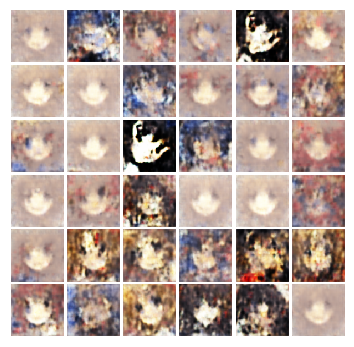


Iter:13400, D:-217.2, G:-0.5666
epoch:2681---------------------------------
Iter:13405, D:-282.0, G:-5.793
epoch:2682---------------------------------
Iter:13410, D:-274.2, G:-7.749
epoch:2683---------------------------------
Iter:13415, D:-259.0, G:9.06
epoch:2684---------------------------------
Iter:13420, D:-228.2, G:1.926
epoch:2685---------------------------------
Iter:13425, D:-285.5, G:3.261
epoch:2686---------------------------------
Iter:13430, D:-176.5, G:3.65
epoch:2687---------------------------------
Iter:13435, D:-253.9, G:-2.703
epoch:2688---------------------------------
Iter:13440, D:-276.7, G:-14.31
epoch:2689---------------------------------
Iter:13445, D:-329.4, G:-26.95
epoch:2690---------------------------------
Iter:13450, D:-291.0, G:-23.12
epoch:2691---------------------------------
Iter:13455, D:-294.0, G:-4.597
epoch:2692---------------------------------
Iter:13460, D:-331.5, G:-10.65
epoch:2693---------------------------------
Iter:13465, D:-266.4, G:-1.01

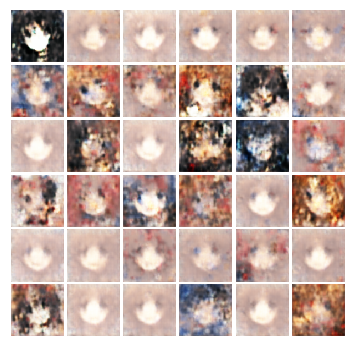


Iter:13600, D:-327.6, G:-13.75
epoch:2721---------------------------------
Iter:13605, D:-261.2, G:0.8602
epoch:2722---------------------------------
Iter:13610, D:-232.2, G:-6.069
epoch:2723---------------------------------
Iter:13615, D:-256.6, G:-5.73
epoch:2724---------------------------------
Iter:13620, D:-260.3, G:11.83
epoch:2725---------------------------------
Iter:13625, D:-263.7, G:5.073
epoch:2726---------------------------------
Iter:13630, D:-310.7, G:-6.531
epoch:2727---------------------------------
Iter:13635, D:-279.6, G:-13.52
epoch:2728---------------------------------
Iter:13640, D:-310.1, G:-26.13
epoch:2729---------------------------------
Iter:13645, D:-292.3, G:0.6982
epoch:2730---------------------------------
Iter:13650, D:-295.3, G:-10.29
epoch:2731---------------------------------
Iter:13655, D:-237.5, G:12.02
epoch:2732---------------------------------
Iter:13660, D:-287.7, G:3.629
epoch:2733---------------------------------
Iter:13665, D:-213.9, G:8.165

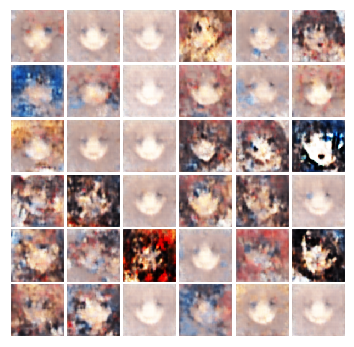


Iter:13800, D:-281.2, G:-9.383
epoch:2761---------------------------------
Iter:13805, D:-226.0, G:-0.02209
epoch:2762---------------------------------
Iter:13810, D:-329.4, G:-21.9
epoch:2763---------------------------------
Iter:13815, D:-287.5, G:-0.9273
epoch:2764---------------------------------
Iter:13820, D:-269.5, G:-8.375
epoch:2765---------------------------------
Iter:13825, D:-298.2, G:-22.81
epoch:2766---------------------------------
Iter:13830, D:-267.5, G:7.636
epoch:2767---------------------------------
Iter:13835, D:-233.4, G:-8.755
epoch:2768---------------------------------
Iter:13840, D:-238.6, G:-6.379
epoch:2769---------------------------------
Iter:13845, D:-233.2, G:16.64
epoch:2770---------------------------------
Iter:13850, D:-243.0, G:-6.679
epoch:2771---------------------------------
Iter:13855, D:-292.9, G:-17.54
epoch:2772---------------------------------
Iter:13860, D:-272.5, G:5.075
epoch:2773---------------------------------
Iter:13865, D:-187.9, G:1

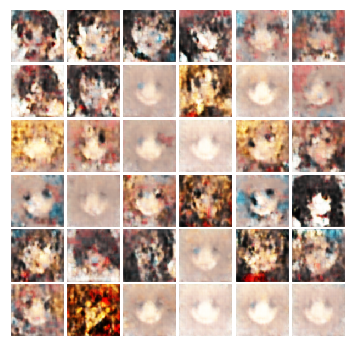


Iter:14000, D:-323.2, G:-6.671
epoch:2801---------------------------------
Iter:14005, D:-247.8, G:3.796
epoch:2802---------------------------------
Iter:14010, D:-299.2, G:-34.56
epoch:2803---------------------------------
Iter:14015, D:-264.7, G:2.101
epoch:2804---------------------------------
Iter:14020, D:-260.6, G:13.58
epoch:2805---------------------------------
Iter:14025, D:-284.6, G:-14.12
epoch:2806---------------------------------
Iter:14030, D:-248.9, G:7.0
epoch:2807---------------------------------
Iter:14035, D:-305.9, G:-8.391
epoch:2808---------------------------------
Iter:14040, D:-271.6, G:-3.682
epoch:2809---------------------------------
Iter:14045, D:-248.7, G:-7.854
epoch:2810---------------------------------
Iter:14050, D:-270.9, G:-0.7577
epoch:2811---------------------------------
Iter:14055, D:-264.2, G:-10.25
epoch:2812---------------------------------
Iter:14060, D:-213.2, G:10.77
epoch:2813---------------------------------
Iter:14065, D:-255.2, G:-1.095

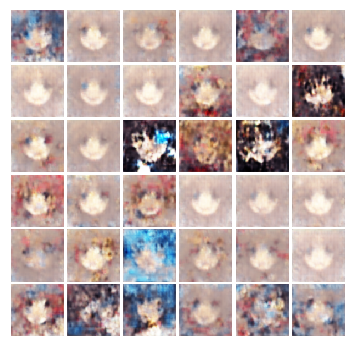


Iter:14200, D:-227.3, G:-6.284
epoch:2841---------------------------------
Iter:14205, D:-273.3, G:-7.757
epoch:2842---------------------------------
Iter:14210, D:-234.9, G:3.896
epoch:2843---------------------------------
Iter:14215, D:-237.8, G:-0.995
epoch:2844---------------------------------
Iter:14220, D:-277.9, G:-14.66
epoch:2845---------------------------------
Iter:14225, D:-241.5, G:7.871
epoch:2846---------------------------------
Iter:14230, D:-271.1, G:-12.79
epoch:2847---------------------------------
Iter:14235, D:-224.7, G:-7.381
epoch:2848---------------------------------
Iter:14240, D:-206.5, G:14.51
epoch:2849---------------------------------
Iter:14245, D:-240.5, G:-2.612
epoch:2850---------------------------------
Iter:14250, D:-257.9, G:-16.11
epoch:2851---------------------------------
Iter:14255, D:-205.7, G:-5.199
epoch:2852---------------------------------
Iter:14260, D:-231.2, G:-5.455
epoch:2853---------------------------------
Iter:14265, D:-264.2, G:7.1

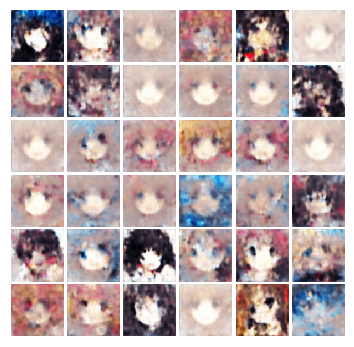


Iter:14400, D:-222.2, G:-0.7761
epoch:2881---------------------------------
Iter:14405, D:-268.2, G:-1.862
epoch:2882---------------------------------
Iter:14410, D:-212.6, G:9.911
epoch:2883---------------------------------
Iter:14415, D:-221.0, G:-6.941
epoch:2884---------------------------------
Iter:14420, D:-218.8, G:-5.052
epoch:2885---------------------------------
Iter:14425, D:-203.8, G:3.71
epoch:2886---------------------------------
Iter:14430, D:-259.4, G:-16.11
epoch:2887---------------------------------
Iter:14435, D:-241.7, G:-7.472
epoch:2888---------------------------------
Iter:14440, D:-229.6, G:-8.667
epoch:2889---------------------------------
Iter:14445, D:-276.6, G:-13.38
epoch:2890---------------------------------
Iter:14450, D:-178.1, G:6.283
epoch:2891---------------------------------
Iter:14455, D:-249.2, G:5.26
epoch:2892---------------------------------
Iter:14460, D:-228.9, G:-16.49
epoch:2893---------------------------------
Iter:14465, D:-250.8, G:1.172

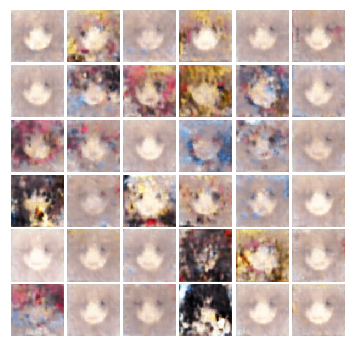


Iter:14600, D:-274.6, G:-9.811
epoch:2921---------------------------------
Iter:14605, D:-260.4, G:-6.8
epoch:2922---------------------------------
Iter:14610, D:-230.0, G:10.9
epoch:2923---------------------------------
Iter:14615, D:-204.1, G:-10.47
epoch:2924---------------------------------
Iter:14620, D:-245.0, G:-15.06
epoch:2925---------------------------------
Iter:14625, D:-204.6, G:4.036
epoch:2926---------------------------------
Iter:14630, D:-215.8, G:-7.2
epoch:2927---------------------------------
Iter:14635, D:-295.2, G:-19.85
epoch:2928---------------------------------
Iter:14640, D:-212.2, G:6.214
epoch:2929---------------------------------
Iter:14645, D:-159.3, G:9.521
epoch:2930---------------------------------
Iter:14650, D:-241.9, G:-7.756
epoch:2931---------------------------------
Iter:14655, D:-274.7, G:-12.26
epoch:2932---------------------------------
Iter:14660, D:-207.3, G:-7.248
epoch:2933---------------------------------
Iter:14665, D:-232.3, G:-12.51
ep

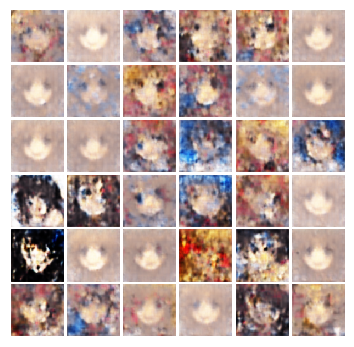


Iter:14800, D:-222.8, G:-4.518
epoch:2961---------------------------------
Iter:14805, D:-223.5, G:-11.01
epoch:2962---------------------------------
Iter:14810, D:-252.0, G:-5.889
epoch:2963---------------------------------
Iter:14815, D:-243.0, G:-0.3124
epoch:2964---------------------------------
Iter:14820, D:-200.8, G:-3.937
epoch:2965---------------------------------
Iter:14825, D:-176.6, G:5.864
epoch:2966---------------------------------
Iter:14830, D:-234.7, G:-5.093
epoch:2967---------------------------------
Iter:14835, D:-231.3, G:3.121
epoch:2968---------------------------------
Iter:14840, D:-245.1, G:-0.6235
epoch:2969---------------------------------
Iter:14845, D:-204.1, G:6.19
epoch:2970---------------------------------
Iter:14850, D:-252.4, G:-10.96
epoch:2971---------------------------------
Iter:14855, D:-239.8, G:-18.04
epoch:2972---------------------------------
Iter:14860, D:-197.5, G:2.192
epoch:2973---------------------------------
Iter:14865, D:-209.8, G:-2.

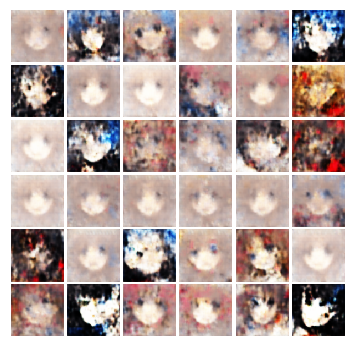


Iter:15000, D:-217.1, G:3.946
epoch:3001---------------------------------
Iter:15005, D:-255.4, G:-16.28
epoch:3002---------------------------------
Iter:15010, D:-186.7, G:-9.239
epoch:3003---------------------------------
Iter:15015, D:-182.6, G:1.856
epoch:3004---------------------------------
Iter:15020, D:-227.3, G:-5.237
epoch:3005---------------------------------
Iter:15025, D:-242.3, G:-8.262
epoch:3006---------------------------------
Iter:15030, D:-220.1, G:3.035
epoch:3007---------------------------------
Iter:15035, D:-258.8, G:-2.702
epoch:3008---------------------------------
Iter:15040, D:-258.5, G:-10.53
epoch:3009---------------------------------
Iter:15045, D:-243.7, G:-15.65
epoch:3010---------------------------------
Iter:15050, D:-224.4, G:-11.16
epoch:3011---------------------------------
Iter:15055, D:-233.0, G:-12.39
epoch:3012---------------------------------
Iter:15060, D:-203.3, G:1.273
epoch:3013---------------------------------
Iter:15065, D:-206.4, G:0.45

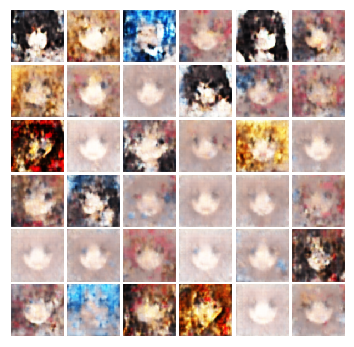


Iter:15200, D:-270.8, G:-16.93
epoch:3041---------------------------------
Iter:15205, D:-258.3, G:-7.552
epoch:3042---------------------------------
Iter:15210, D:-196.9, G:-1.95
epoch:3043---------------------------------
Iter:15215, D:-228.3, G:-4.48
epoch:3044---------------------------------
Iter:15220, D:-233.9, G:0.9573
epoch:3045---------------------------------
Iter:15225, D:-231.8, G:-2.409
epoch:3046---------------------------------
Iter:15230, D:-255.4, G:3.564
epoch:3047---------------------------------
Iter:15235, D:-217.3, G:-5.915
epoch:3048---------------------------------
Iter:15240, D:-231.7, G:-16.64
epoch:3049---------------------------------
Iter:15245, D:-216.0, G:1.539
epoch:3050---------------------------------
Iter:15250, D:-229.0, G:-9.926
epoch:3051---------------------------------
Iter:15255, D:-240.1, G:-10.84
epoch:3052---------------------------------
Iter:15260, D:-227.1, G:-8.071
epoch:3053---------------------------------
Iter:15265, D:-243.1, G:-2.8

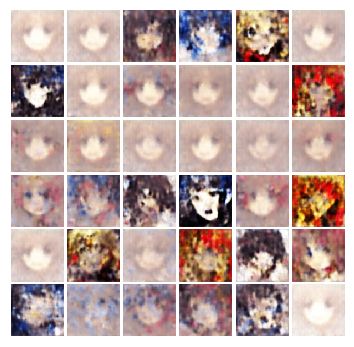


Iter:15400, D:-261.7, G:-34.18
epoch:3081---------------------------------
Iter:15405, D:-245.0, G:0.2944
epoch:3082---------------------------------
Iter:15410, D:-206.6, G:26.72
epoch:3083---------------------------------
Iter:15415, D:-240.4, G:-18.73
epoch:3084---------------------------------
Iter:15420, D:-239.4, G:-18.29
epoch:3085---------------------------------
Iter:15425, D:-214.7, G:-16.16
epoch:3086---------------------------------
Iter:15430, D:-244.6, G:-1.28
epoch:3087---------------------------------
Iter:15435, D:-220.9, G:-0.3629
epoch:3088---------------------------------
Iter:15440, D:-260.9, G:-16.29
epoch:3089---------------------------------
Iter:15445, D:-244.9, G:-7.947
epoch:3090---------------------------------
Iter:15450, D:-276.0, G:-8.401
epoch:3091---------------------------------
Iter:15455, D:-218.1, G:-9.663
epoch:3092---------------------------------
Iter:15460, D:-220.6, G:-0.5373
epoch:3093---------------------------------
Iter:15465, D:-240.7, G:

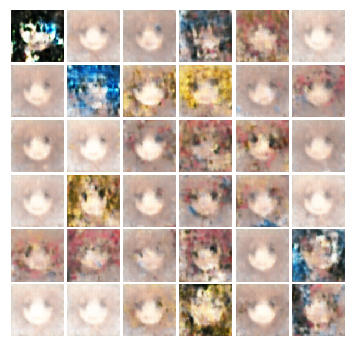


Iter:15600, D:-195.6, G:3.667
epoch:3121---------------------------------
Iter:15605, D:-234.7, G:-22.24
epoch:3122---------------------------------
Iter:15610, D:-222.9, G:-10.95
epoch:3123---------------------------------
Iter:15615, D:-219.4, G:6.106
epoch:3124---------------------------------
Iter:15620, D:-240.6, G:-21.1
epoch:3125---------------------------------
Iter:15625, D:-224.5, G:4.604
epoch:3126---------------------------------
Iter:15630, D:-229.1, G:6.708
epoch:3127---------------------------------
Iter:15635, D:-207.1, G:1.293
epoch:3128---------------------------------
Iter:15640, D:-234.0, G:-1.688
epoch:3129---------------------------------
Iter:15645, D:-189.4, G:-4.684
epoch:3130---------------------------------
Iter:15650, D:-216.8, G:1.897
epoch:3131---------------------------------
Iter:15655, D:-236.0, G:-20.59
epoch:3132---------------------------------
Iter:15660, D:-203.9, G:4.176
epoch:3133---------------------------------
Iter:15665, D:-205.4, G:-2.839
e

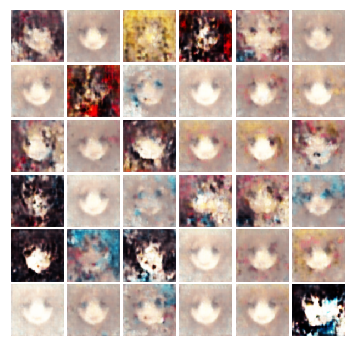


Iter:15800, D:-224.4, G:-5.131
epoch:3161---------------------------------
Iter:15805, D:-207.2, G:1.438
epoch:3162---------------------------------
Iter:15810, D:-182.8, G:-5.305
epoch:3163---------------------------------
Iter:15815, D:-211.0, G:-2.936
epoch:3164---------------------------------
Iter:15820, D:-159.9, G:19.05
epoch:3165---------------------------------
Iter:15825, D:-247.2, G:-24.33
epoch:3166---------------------------------
Iter:15830, D:-193.6, G:12.64
epoch:3167---------------------------------
Iter:15835, D:-242.5, G:-10.26
epoch:3168---------------------------------
Iter:15840, D:-241.2, G:-8.971
epoch:3169---------------------------------
Iter:15845, D:-215.3, G:4.208
epoch:3170---------------------------------
Iter:15850, D:-183.1, G:-6.019
epoch:3171---------------------------------
Iter:15855, D:-224.4, G:-2.019
epoch:3172---------------------------------
Iter:15860, D:-246.1, G:-12.46
epoch:3173---------------------------------
Iter:15865, D:-217.7, G:1.51

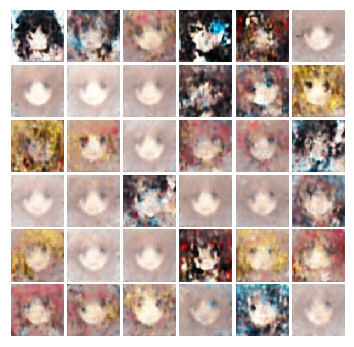


Iter:16000, D:-198.4, G:-7.02
epoch:3201---------------------------------
Iter:16005, D:-164.5, G:-5.965
epoch:3202---------------------------------
Iter:16010, D:-224.6, G:-12.71
epoch:3203---------------------------------
Iter:16015, D:-224.9, G:-6.684
epoch:3204---------------------------------
Iter:16020, D:-249.8, G:-16.25
epoch:3205---------------------------------
Iter:16025, D:-286.5, G:-15.68
epoch:3206---------------------------------
Iter:16030, D:-222.9, G:-16.35
epoch:3207---------------------------------
Iter:16035, D:-212.1, G:-2.932
epoch:3208---------------------------------
Iter:16040, D:-219.5, G:-10.99
epoch:3209---------------------------------
Iter:16045, D:-172.3, G:-0.4615
epoch:3210---------------------------------
Iter:16050, D:-247.3, G:-16.24
epoch:3211---------------------------------
Iter:16055, D:-199.6, G:16.58
epoch:3212---------------------------------
Iter:16060, D:-217.4, G:0.9219
epoch:3213---------------------------------
Iter:16065, D:-190.5, G:-

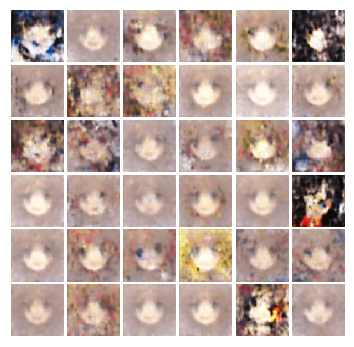


Iter:16200, D:-209.7, G:-5.12
epoch:3241---------------------------------
Iter:16205, D:-220.8, G:-0.3076
epoch:3242---------------------------------
Iter:16210, D:-238.4, G:-15.01
epoch:3243---------------------------------
Iter:16215, D:-246.0, G:-4.945
epoch:3244---------------------------------
Iter:16220, D:-177.4, G:2.875
epoch:3245---------------------------------
Iter:16225, D:-207.5, G:-8.26
epoch:3246---------------------------------
Iter:16230, D:-246.1, G:-7.545
epoch:3247---------------------------------
Iter:16235, D:-197.6, G:-2.102
epoch:3248---------------------------------
Iter:16240, D:-215.1, G:-10.13
epoch:3249---------------------------------
Iter:16245, D:-214.6, G:-13.23
epoch:3250---------------------------------
Iter:16250, D:-317.7, G:-38.3
epoch:3251---------------------------------
Iter:16255, D:-249.6, G:-6.158
epoch:3252---------------------------------
Iter:16260, D:-200.8, G:9.753
epoch:3253---------------------------------
Iter:16265, D:-211.7, G:3.17

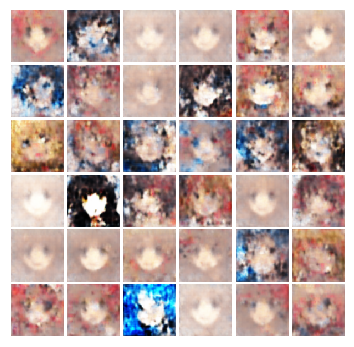


Iter:16400, D:-230.8, G:-22.67
epoch:3281---------------------------------
Iter:16405, D:-182.9, G:3.731
epoch:3282---------------------------------
Iter:16410, D:-200.1, G:-1.283
epoch:3283---------------------------------
Iter:16415, D:-224.9, G:-6.473
epoch:3284---------------------------------
Iter:16420, D:-190.1, G:4.433
epoch:3285---------------------------------
Iter:16425, D:-217.8, G:-4.03
epoch:3286---------------------------------
Iter:16430, D:-274.4, G:-11.17
epoch:3287---------------------------------
Iter:16435, D:-206.3, G:-10.68
epoch:3288---------------------------------
Iter:16440, D:-235.0, G:-29.97
epoch:3289---------------------------------
Iter:16445, D:-178.8, G:6.862
epoch:3290---------------------------------
Iter:16450, D:-251.7, G:9.6
epoch:3291---------------------------------
Iter:16455, D:-260.0, G:15.69
epoch:3292---------------------------------
Iter:16460, D:-206.9, G:3.374
epoch:3293---------------------------------
Iter:16465, D:-225.8, G:-20.81
ep

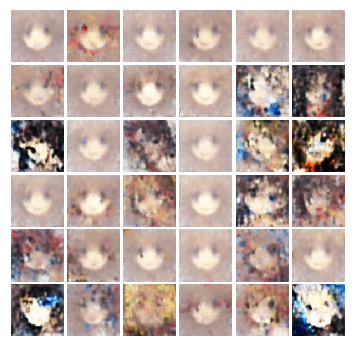


Iter:16600, D:-225.4, G:-10.03
epoch:3321---------------------------------
Iter:16605, D:-208.5, G:-1.873
epoch:3322---------------------------------
Iter:16610, D:-207.5, G:-7.273
epoch:3323---------------------------------
Iter:16615, D:-199.6, G:-0.8492
epoch:3324---------------------------------
Iter:16620, D:-262.3, G:-26.35
epoch:3325---------------------------------
Iter:16625, D:-274.2, G:-27.4
epoch:3326---------------------------------
Iter:16630, D:-229.9, G:12.86
epoch:3327---------------------------------
Iter:16635, D:-232.4, G:-2.314
epoch:3328---------------------------------
Iter:16640, D:-223.1, G:0.6555
epoch:3329---------------------------------
Iter:16645, D:-188.9, G:2.363
epoch:3330---------------------------------
Iter:16650, D:-189.2, G:-11.73
epoch:3331---------------------------------
Iter:16655, D:-250.2, G:-4.415
epoch:3332---------------------------------
Iter:16660, D:-254.1, G:-6.675
epoch:3333---------------------------------
Iter:16665, D:-232.1, G:-2

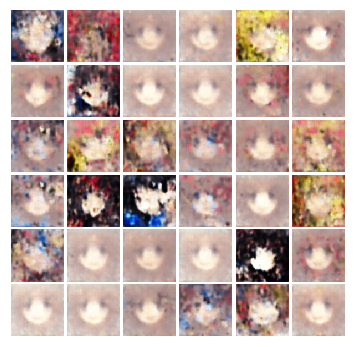


Iter:16800, D:-220.8, G:-20.98
epoch:3361---------------------------------
Iter:16805, D:-185.9, G:8.667
epoch:3362---------------------------------
Iter:16810, D:-236.7, G:6.186
epoch:3363---------------------------------
Iter:16815, D:-217.2, G:3.321
epoch:3364---------------------------------
Iter:16820, D:-205.5, G:-9.947
epoch:3365---------------------------------
Iter:16825, D:-231.2, G:-14.95
epoch:3366---------------------------------
Iter:16830, D:-220.2, G:-14.29
epoch:3367---------------------------------
Iter:16835, D:-222.3, G:0.8446
epoch:3368---------------------------------
Iter:16840, D:-230.0, G:-17.12
epoch:3369---------------------------------
Iter:16845, D:-231.5, G:4.434
epoch:3370---------------------------------
Iter:16850, D:-188.6, G:-6.271
epoch:3371---------------------------------
Iter:16855, D:-216.1, G:-3.852
epoch:3372---------------------------------
Iter:16860, D:-214.9, G:-2.97
epoch:3373---------------------------------
Iter:16865, D:-244.7, G:-29.2

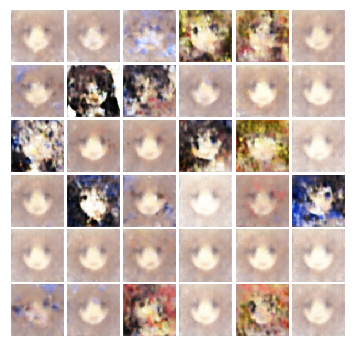


Iter:17000, D:-241.0, G:-4.889
epoch:3401---------------------------------
Iter:17005, D:-261.8, G:-3.3
epoch:3402---------------------------------
Iter:17010, D:-270.7, G:-25.84
epoch:3403---------------------------------
Iter:17015, D:-240.8, G:-13.15
epoch:3404---------------------------------
Iter:17020, D:-215.8, G:-1.132
epoch:3405---------------------------------
Iter:17025, D:-256.0, G:-18.26
epoch:3406---------------------------------
Iter:17030, D:-224.3, G:3.182
epoch:3407---------------------------------
Iter:17035, D:-170.7, G:15.67
epoch:3408---------------------------------
Iter:17040, D:-184.2, G:-10.46
epoch:3409---------------------------------
Iter:17045, D:-217.1, G:-10.93
epoch:3410---------------------------------
Iter:17050, D:-220.3, G:1.098
epoch:3411---------------------------------
Iter:17055, D:-179.3, G:-6.208
epoch:3412---------------------------------
Iter:17060, D:-205.6, G:-10.0
epoch:3413---------------------------------
Iter:17065, D:-221.0, G:-1.508

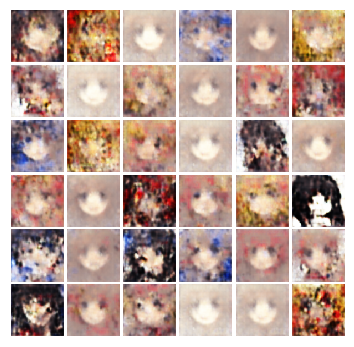


Iter:17200, D:-211.5, G:-11.19
epoch:3441---------------------------------
Iter:17205, D:-220.1, G:-8.324
epoch:3442---------------------------------
Iter:17210, D:-203.4, G:-7.055
epoch:3443---------------------------------
Iter:17215, D:-158.0, G:2.847
epoch:3444---------------------------------
Iter:17220, D:-184.5, G:4.754
epoch:3445---------------------------------
Iter:17225, D:-200.7, G:-10.35
epoch:3446---------------------------------
Iter:17230, D:-262.8, G:-13.13
epoch:3447---------------------------------
Iter:17235, D:-226.7, G:-17.74
epoch:3448---------------------------------
Iter:17240, D:-197.2, G:-4.851
epoch:3449---------------------------------
Iter:17245, D:-223.5, G:-4.451
epoch:3450---------------------------------
Iter:17250, D:-209.9, G:-3.53
epoch:3451---------------------------------
Iter:17255, D:-222.1, G:-2.181
epoch:3452---------------------------------
Iter:17260, D:-213.0, G:-8.952
epoch:3453---------------------------------
Iter:17265, D:-207.6, G:-6.

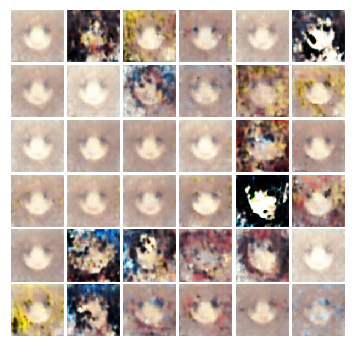


Iter:17400, D:-244.2, G:-26.2
epoch:3481---------------------------------
Iter:17405, D:-263.2, G:-10.3
epoch:3482---------------------------------
Iter:17410, D:-177.3, G:-7.278
epoch:3483---------------------------------
Iter:17415, D:-246.6, G:0.4876
epoch:3484---------------------------------
Iter:17420, D:-251.0, G:-12.22
epoch:3485---------------------------------
Iter:17425, D:-242.8, G:-13.14
epoch:3486---------------------------------
Iter:17430, D:-197.5, G:9.903
epoch:3487---------------------------------
Iter:17435, D:-217.1, G:-4.526
epoch:3488---------------------------------
Iter:17440, D:-226.1, G:-2.432
epoch:3489---------------------------------
Iter:17445, D:-213.7, G:0.8027
epoch:3490---------------------------------
Iter:17450, D:-215.3, G:-9.508
epoch:3491---------------------------------
Iter:17455, D:-214.6, G:-10.86
epoch:3492---------------------------------
Iter:17460, D:-215.5, G:-5.249
epoch:3493---------------------------------
Iter:17465, D:-209.6, G:-1.

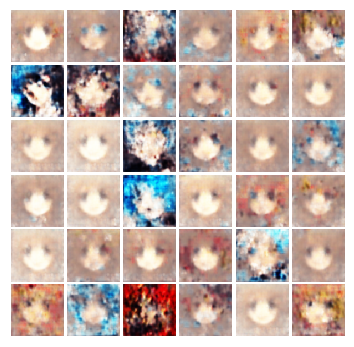


Iter:17600, D:-200.0, G:-14.54
epoch:3521---------------------------------
Iter:17605, D:-252.3, G:-15.66
epoch:3522---------------------------------
Iter:17610, D:-193.6, G:2.064
epoch:3523---------------------------------
Iter:17615, D:-200.8, G:-10.54
epoch:3524---------------------------------
Iter:17620, D:-195.0, G:5.153
epoch:3525---------------------------------
Iter:17625, D:-266.7, G:-12.74
epoch:3526---------------------------------
Iter:17630, D:-208.4, G:-3.269
epoch:3527---------------------------------
Iter:17635, D:-187.3, G:-10.69
epoch:3528---------------------------------
Iter:17640, D:-228.0, G:-3.873
epoch:3529---------------------------------
Iter:17645, D:-197.8, G:-1.051
epoch:3530---------------------------------
Iter:17650, D:-226.6, G:-7.148
epoch:3531---------------------------------
Iter:17655, D:-205.1, G:-2.686
epoch:3532---------------------------------
Iter:17660, D:-235.4, G:-17.41
epoch:3533---------------------------------
Iter:17665, D:-198.5, G:-3

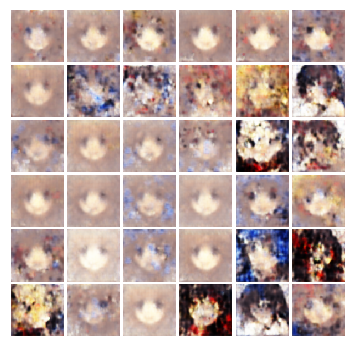


Iter:17800, D:-208.9, G:2.534
epoch:3561---------------------------------
Iter:17805, D:-227.9, G:-1.302
epoch:3562---------------------------------
Iter:17810, D:-199.7, G:0.2245
epoch:3563---------------------------------
Iter:17815, D:-213.6, G:8.908
epoch:3564---------------------------------
Iter:17820, D:-198.6, G:-6.513
epoch:3565---------------------------------
Iter:17825, D:-181.9, G:-2.582
epoch:3566---------------------------------
Iter:17830, D:-203.7, G:-4.275
epoch:3567---------------------------------
Iter:17835, D:-183.5, G:-7.662
epoch:3568---------------------------------
Iter:17840, D:-192.2, G:2.476
epoch:3569---------------------------------
Iter:17845, D:-204.8, G:-0.1688
epoch:3570---------------------------------
Iter:17850, D:-228.0, G:-17.36
epoch:3571---------------------------------
Iter:17855, D:-227.0, G:-2.032
epoch:3572---------------------------------
Iter:17860, D:-191.6, G:0.2072
epoch:3573---------------------------------
Iter:17865, D:-206.8, G:7.

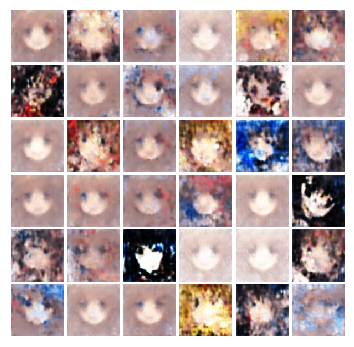


Iter:18000, D:-243.2, G:-5.007
epoch:3601---------------------------------
Iter:18005, D:-248.0, G:-7.837
epoch:3602---------------------------------
Iter:18010, D:-200.1, G:-4.251
epoch:3603---------------------------------
Iter:18015, D:-240.4, G:-10.59
epoch:3604---------------------------------
Iter:18020, D:-207.8, G:-0.01121
epoch:3605---------------------------------
Iter:18025, D:-204.7, G:-1.452
epoch:3606---------------------------------
Iter:18030, D:-221.7, G:-6.542
epoch:3607---------------------------------
Iter:18035, D:-187.7, G:-4.506
epoch:3608---------------------------------
Iter:18040, D:-219.2, G:-8.297
epoch:3609---------------------------------
Iter:18045, D:-257.2, G:-23.81
epoch:3610---------------------------------
Iter:18050, D:-257.6, G:-11.36
epoch:3611---------------------------------
Iter:18055, D:-232.3, G:-10.13
epoch:3612---------------------------------
Iter:18060, D:-229.6, G:-10.92
epoch:3613---------------------------------
Iter:18065, D:-175.9, 

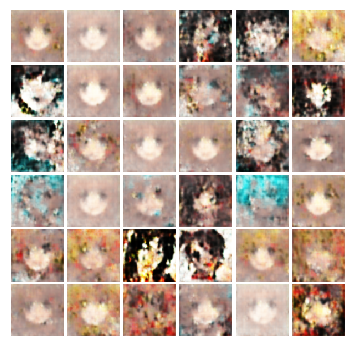


Iter:18200, D:-218.1, G:0.6299
epoch:3641---------------------------------
Iter:18205, D:-244.2, G:-19.53
epoch:3642---------------------------------
Iter:18210, D:-228.2, G:-16.64
epoch:3643---------------------------------
Iter:18215, D:-203.5, G:-1.888
epoch:3644---------------------------------
Iter:18220, D:-216.6, G:0.6683
epoch:3645---------------------------------
Iter:18225, D:-235.7, G:-5.19
epoch:3646---------------------------------
Iter:18230, D:-241.5, G:-9.659
epoch:3647---------------------------------
Iter:18235, D:-172.3, G:-6.446
epoch:3648---------------------------------
Iter:18240, D:-195.7, G:-5.799
epoch:3649---------------------------------
Iter:18245, D:-179.4, G:3.53
epoch:3650---------------------------------
Iter:18250, D:-241.9, G:-12.46
epoch:3651---------------------------------
Iter:18255, D:-229.6, G:-11.45
epoch:3652---------------------------------
Iter:18260, D:-237.7, G:2.779
epoch:3653---------------------------------
Iter:18265, D:-174.9, G:2.22

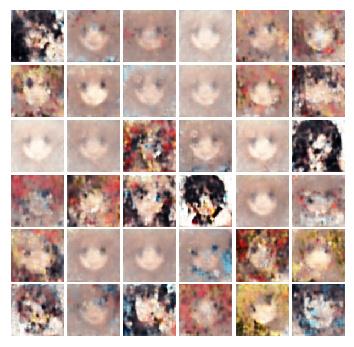


Iter:18400, D:-214.2, G:-20.49
epoch:3681---------------------------------
Iter:18405, D:-180.4, G:6.05
epoch:3682---------------------------------
Iter:18410, D:-218.2, G:-3.45
epoch:3683---------------------------------
Iter:18415, D:-173.8, G:-0.3269
epoch:3684---------------------------------
Iter:18420, D:-211.7, G:-11.51
epoch:3685---------------------------------
Iter:18425, D:-239.8, G:1.26
epoch:3686---------------------------------
Iter:18430, D:-190.2, G:4.265
epoch:3687---------------------------------
Iter:18435, D:-228.3, G:-18.22
epoch:3688---------------------------------
Iter:18440, D:-210.7, G:-7.433
epoch:3689---------------------------------
Iter:18445, D:-189.8, G:-1.612
epoch:3690---------------------------------
Iter:18450, D:-251.3, G:11.42
epoch:3691---------------------------------
Iter:18455, D:-245.1, G:-12.81
epoch:3692---------------------------------
Iter:18460, D:-198.0, G:0.8967
epoch:3693---------------------------------
Iter:18465, D:-229.2, G:0.5466

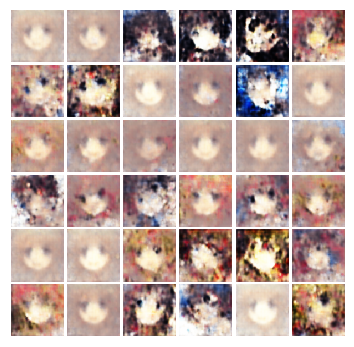


Iter:18600, D:-178.5, G:7.289
epoch:3721---------------------------------
Iter:18605, D:-232.9, G:-2.857
epoch:3722---------------------------------
Iter:18610, D:-179.4, G:-0.1787
epoch:3723---------------------------------
Iter:18615, D:-239.7, G:-11.21
epoch:3724---------------------------------
Iter:18620, D:-210.3, G:-3.307
epoch:3725---------------------------------
Iter:18625, D:-190.3, G:-2.978
epoch:3726---------------------------------
Iter:18630, D:-212.4, G:2.296
epoch:3727---------------------------------
Iter:18635, D:-208.4, G:-9.158
epoch:3728---------------------------------
Iter:18640, D:-216.7, G:-10.33
epoch:3729---------------------------------
Iter:18645, D:-241.9, G:-12.4
epoch:3730---------------------------------
Iter:18650, D:-218.7, G:6.147
epoch:3731---------------------------------
Iter:18655, D:-239.0, G:-14.61
epoch:3732---------------------------------
Iter:18660, D:-274.4, G:-9.743
epoch:3733---------------------------------
Iter:18665, D:-262.0, G:-9.

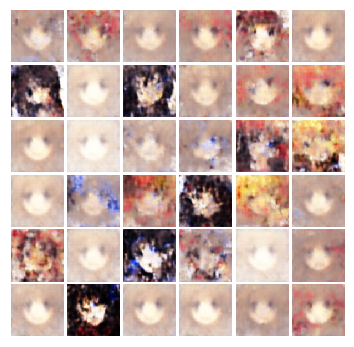


Iter:18800, D:-212.7, G:-6.861
epoch:3761---------------------------------
Iter:18805, D:-215.8, G:2.906
epoch:3762---------------------------------
Iter:18810, D:-289.5, G:-2.417
epoch:3763---------------------------------
Iter:18815, D:-208.2, G:2.602
epoch:3764---------------------------------
Iter:18820, D:-200.8, G:-9.214
epoch:3765---------------------------------
Iter:18825, D:-202.4, G:0.989
epoch:3766---------------------------------
Iter:18830, D:-230.2, G:1.442
epoch:3767---------------------------------
Iter:18835, D:-220.1, G:2.636
epoch:3768---------------------------------
Iter:18840, D:-210.7, G:1.162
epoch:3769---------------------------------
Iter:18845, D:-197.2, G:-12.81
epoch:3770---------------------------------
Iter:18850, D:-173.8, G:9.171
epoch:3771---------------------------------
Iter:18855, D:-257.1, G:-23.26
epoch:3772---------------------------------
Iter:18860, D:-167.4, G:-0.5739
epoch:3773---------------------------------
Iter:18865, D:-192.4, G:-7.742

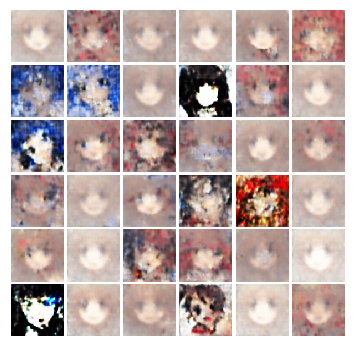


Iter:19000, D:-214.7, G:4.653
epoch:3801---------------------------------
Iter:19005, D:-197.8, G:-13.49
epoch:3802---------------------------------
Iter:19010, D:-221.5, G:-10.94
epoch:3803---------------------------------
Iter:19015, D:-247.3, G:7.705
epoch:3804---------------------------------
Iter:19020, D:-188.7, G:5.389
epoch:3805---------------------------------
Iter:19025, D:-230.5, G:-11.37
epoch:3806---------------------------------
Iter:19030, D:-226.6, G:-1.86
epoch:3807---------------------------------
Iter:19035, D:-240.8, G:-6.515
epoch:3808---------------------------------
Iter:19040, D:-273.0, G:-20.14
epoch:3809---------------------------------
Iter:19045, D:-223.5, G:-14.13
epoch:3810---------------------------------
Iter:19050, D:-236.1, G:-6.765
epoch:3811---------------------------------
Iter:19055, D:-239.7, G:-19.08
epoch:3812---------------------------------
Iter:19060, D:-242.5, G:-4.017
epoch:3813---------------------------------
Iter:19065, D:-223.2, G:-8.1

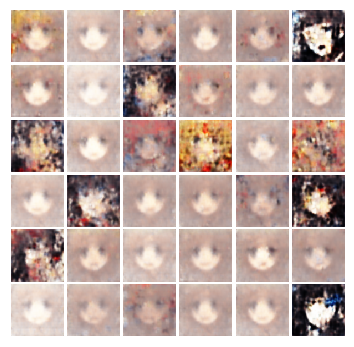


Iter:19200, D:-179.8, G:1.726
epoch:3841---------------------------------
Iter:19205, D:-211.4, G:-4.598
epoch:3842---------------------------------
Iter:19210, D:-206.5, G:-14.79
epoch:3843---------------------------------
Iter:19215, D:-203.1, G:-11.89
epoch:3844---------------------------------
Iter:19220, D:-239.6, G:5.119
epoch:3845---------------------------------
Iter:19225, D:-227.7, G:-6.435
epoch:3846---------------------------------
Iter:19230, D:-158.1, G:7.716
epoch:3847---------------------------------
Iter:19235, D:-222.2, G:-10.37
epoch:3848---------------------------------
Iter:19240, D:-231.1, G:-23.37
epoch:3849---------------------------------
Iter:19245, D:-222.4, G:-1.797
epoch:3850---------------------------------
Iter:19250, D:-178.3, G:0.4079
epoch:3851---------------------------------
Iter:19255, D:-232.2, G:-21.69
epoch:3852---------------------------------
Iter:19260, D:-204.5, G:-3.505
epoch:3853---------------------------------
Iter:19265, D:-196.0, G:-2.

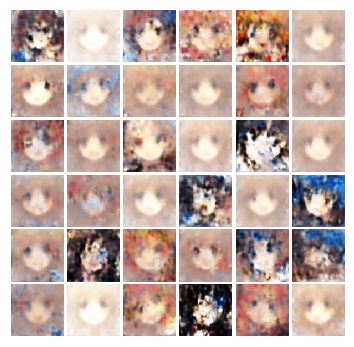


Iter:19400, D:-213.3, G:-9.018
epoch:3881---------------------------------
Iter:19405, D:-233.8, G:-4.643
epoch:3882---------------------------------
Iter:19410, D:-280.5, G:-13.28
epoch:3883---------------------------------
Iter:19415, D:-216.1, G:3.11
epoch:3884---------------------------------
Iter:19420, D:-242.7, G:-4.13
epoch:3885---------------------------------
Iter:19425, D:-202.5, G:3.294
epoch:3886---------------------------------
Iter:19430, D:-249.2, G:-13.92
epoch:3887---------------------------------
Iter:19435, D:-213.4, G:7.526
epoch:3888---------------------------------
Iter:19440, D:-204.5, G:0.558
epoch:3889---------------------------------
Iter:19445, D:-229.5, G:-25.92
epoch:3890---------------------------------
Iter:19450, D:-198.1, G:9.703
epoch:3891---------------------------------
Iter:19455, D:-211.9, G:-18.53
epoch:3892---------------------------------
Iter:19460, D:-236.5, G:-0.2582
epoch:3893---------------------------------
Iter:19465, D:-225.5, G:5.668


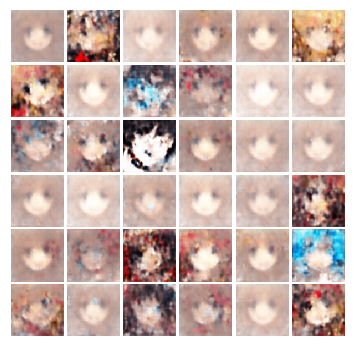


Iter:19600, D:-222.5, G:7.313
epoch:3921---------------------------------
Iter:19605, D:-225.7, G:-5.723
epoch:3922---------------------------------
Iter:19610, D:-163.1, G:-8.563
epoch:3923---------------------------------
Iter:19615, D:-182.1, G:-2.368
epoch:3924---------------------------------
Iter:19620, D:-201.3, G:-14.81
epoch:3925---------------------------------
Iter:19625, D:-206.5, G:-5.326
epoch:3926---------------------------------
Iter:19630, D:-186.9, G:1.609
epoch:3927---------------------------------
Iter:19635, D:-189.0, G:-3.774
epoch:3928---------------------------------
Iter:19640, D:-178.3, G:-4.239
epoch:3929---------------------------------
Iter:19645, D:-209.7, G:1.517
epoch:3930---------------------------------
Iter:19650, D:-236.3, G:-8.002
epoch:3931---------------------------------
Iter:19655, D:-198.4, G:-4.282
epoch:3932---------------------------------
Iter:19660, D:-201.0, G:2.864
epoch:3933---------------------------------
Iter:19665, D:-239.2, G:-12.

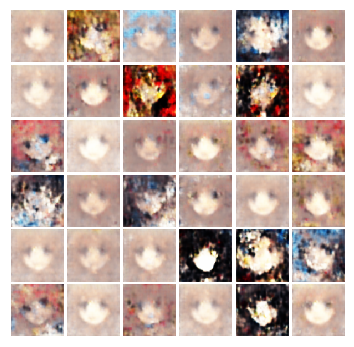


Iter:19800, D:-241.0, G:-21.24
epoch:3961---------------------------------
Iter:19805, D:-236.1, G:-9.241
epoch:3962---------------------------------
Iter:19810, D:-213.0, G:-2.132
epoch:3963---------------------------------
Iter:19815, D:-225.6, G:-10.06
epoch:3964---------------------------------
Iter:19820, D:-254.8, G:-7.558
epoch:3965---------------------------------
Iter:19825, D:-256.4, G:-10.11
epoch:3966---------------------------------
Iter:19830, D:-269.0, G:-16.76
epoch:3967---------------------------------
Iter:19835, D:-200.4, G:0.03048
epoch:3968---------------------------------
Iter:19840, D:-197.6, G:2.887
epoch:3969---------------------------------
Iter:19845, D:-254.1, G:-18.3
epoch:3970---------------------------------
Iter:19850, D:-214.7, G:-11.28
epoch:3971---------------------------------
Iter:19855, D:-241.2, G:-12.58
epoch:3972---------------------------------
Iter:19860, D:-217.0, G:-6.592
epoch:3973---------------------------------
Iter:19865, D:-225.1, G:-

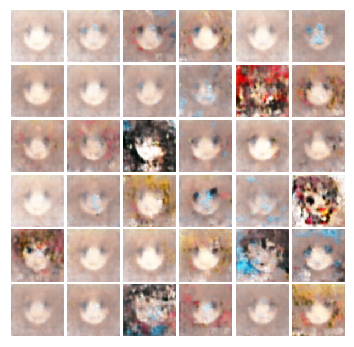


Iter:20000, D:-205.9, G:-14.03
epoch:4001---------------------------------
Iter:20005, D:-209.2, G:-5.741
epoch:4002---------------------------------
Iter:20010, D:-190.0, G:-2.881
epoch:4003---------------------------------
Iter:20015, D:-268.6, G:-24.83
epoch:4004---------------------------------
Iter:20020, D:-245.5, G:-1.797
epoch:4005---------------------------------
Iter:20025, D:-224.0, G:-6.994
epoch:4006---------------------------------
Iter:20030, D:-199.9, G:-6.574
epoch:4007---------------------------------
Iter:20035, D:-245.5, G:-11.75
epoch:4008---------------------------------
Iter:20040, D:-214.0, G:-9.311
epoch:4009---------------------------------
Iter:20045, D:-182.0, G:-10.93
epoch:4010---------------------------------
Iter:20050, D:-221.9, G:-5.189
epoch:4011---------------------------------
Iter:20055, D:-256.9, G:-10.33
epoch:4012---------------------------------
Iter:20060, D:-246.7, G:-17.63
epoch:4013---------------------------------
Iter:20065, D:-202.7, G:

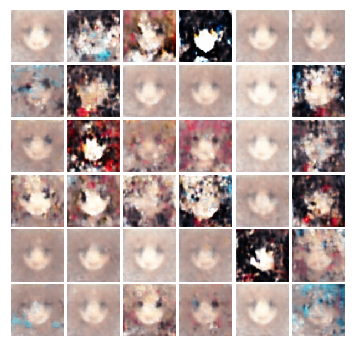


Iter:20200, D:-189.3, G:3.084
epoch:4041---------------------------------
Iter:20205, D:-224.0, G:-7.961
epoch:4042---------------------------------
Iter:20210, D:-222.5, G:-7.47
epoch:4043---------------------------------
Iter:20215, D:-231.9, G:-13.37
epoch:4044---------------------------------
Iter:20220, D:-215.9, G:-17.16
epoch:4045---------------------------------
Iter:20225, D:-168.0, G:-4.441
epoch:4046---------------------------------
Iter:20230, D:-197.2, G:-7.977
epoch:4047---------------------------------
Iter:20235, D:-211.2, G:-9.289
epoch:4048---------------------------------
Iter:20240, D:-206.4, G:-7.529
epoch:4049---------------------------------
Iter:20245, D:-170.6, G:10.1
epoch:4050---------------------------------
Iter:20250, D:-225.1, G:-9.638
epoch:4051---------------------------------
Iter:20255, D:-160.8, G:2.019
epoch:4052---------------------------------
Iter:20260, D:-206.4, G:-4.15
epoch:4053---------------------------------
Iter:20265, D:-255.9, G:-9.253

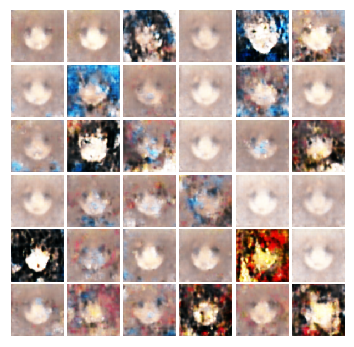


Iter:20400, D:-215.3, G:-14.74
epoch:4081---------------------------------
Iter:20405, D:-226.3, G:-7.291
epoch:4082---------------------------------
Iter:20410, D:-241.0, G:-10.83
epoch:4083---------------------------------
Iter:20415, D:-223.5, G:-15.69
epoch:4084---------------------------------
Iter:20420, D:-245.1, G:-11.19
epoch:4085---------------------------------
Iter:20425, D:-261.4, G:-12.06
epoch:4086---------------------------------
Iter:20430, D:-188.7, G:-0.3995
epoch:4087---------------------------------
Iter:20435, D:-219.4, G:-22.71
epoch:4088---------------------------------
Iter:20440, D:-223.5, G:-7.419
epoch:4089---------------------------------
Iter:20445, D:-213.5, G:-1.699
epoch:4090---------------------------------
Iter:20450, D:-189.7, G:7.177
epoch:4091---------------------------------
Iter:20455, D:-237.9, G:-10.63
epoch:4092---------------------------------
Iter:20460, D:-197.9, G:-5.18
epoch:4093---------------------------------
Iter:20465, D:-201.6, G:-

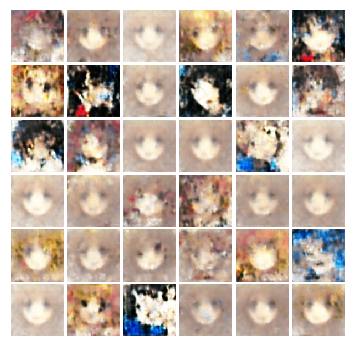


Iter:20600, D:-214.3, G:-1.705
epoch:4121---------------------------------
Iter:20605, D:-230.4, G:-8.356
epoch:4122---------------------------------
Iter:20610, D:-249.2, G:-22.66
epoch:4123---------------------------------
Iter:20615, D:-182.7, G:-6.741
epoch:4124---------------------------------
Iter:20620, D:-191.2, G:-7.137
epoch:4125---------------------------------
Iter:20625, D:-236.5, G:-18.88
epoch:4126---------------------------------
Iter:20630, D:-234.0, G:-6.023
epoch:4127---------------------------------
Iter:20635, D:-186.0, G:-5.811
epoch:4128---------------------------------
Iter:20640, D:-226.0, G:-7.079
epoch:4129---------------------------------
Iter:20645, D:-216.2, G:-0.6861
epoch:4130---------------------------------
Iter:20650, D:-235.5, G:-11.85
epoch:4131---------------------------------
Iter:20655, D:-223.3, G:-10.38
epoch:4132---------------------------------
Iter:20660, D:-210.9, G:-15.26
epoch:4133---------------------------------
Iter:20665, D:-217.5, G

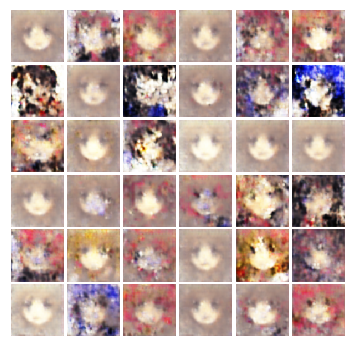


Iter:20800, D:-163.0, G:-2.614
epoch:4161---------------------------------
Iter:20805, D:-224.9, G:-6.027
epoch:4162---------------------------------
Iter:20810, D:-222.9, G:-11.48
epoch:4163---------------------------------
Iter:20815, D:-187.2, G:1.765
epoch:4164---------------------------------
Iter:20820, D:-251.5, G:-17.34
epoch:4165---------------------------------
Iter:20825, D:-207.4, G:-10.76
epoch:4166---------------------------------
Iter:20830, D:-200.1, G:-9.412
epoch:4167---------------------------------
Iter:20835, D:-189.0, G:-3.929
epoch:4168---------------------------------
Iter:20840, D:-235.7, G:-23.61
epoch:4169---------------------------------
Iter:20845, D:-211.1, G:-8.123
epoch:4170---------------------------------
Iter:20850, D:-222.2, G:-4.812
epoch:4171---------------------------------
Iter:20855, D:-183.1, G:-11.31
epoch:4172---------------------------------
Iter:20860, D:-196.5, G:-5.166
epoch:4173---------------------------------
Iter:20865, D:-209.3, G:3

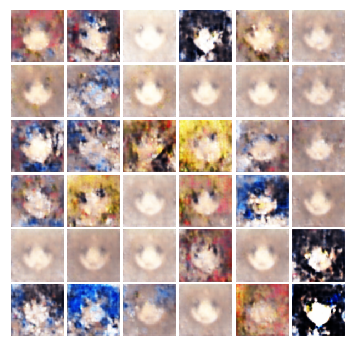


Iter:21000, D:-237.2, G:-10.2
epoch:4201---------------------------------
Iter:21005, D:-220.4, G:-8.571
epoch:4202---------------------------------
Iter:21010, D:-246.8, G:-22.55
epoch:4203---------------------------------
Iter:21015, D:-243.6, G:-15.16
epoch:4204---------------------------------
Iter:21020, D:-167.1, G:5.064
epoch:4205---------------------------------
Iter:21025, D:-182.9, G:-7.406
epoch:4206---------------------------------
Iter:21030, D:-210.3, G:-13.72
epoch:4207---------------------------------
Iter:21035, D:-233.8, G:-12.27
epoch:4208---------------------------------
Iter:21040, D:-254.8, G:-22.73
epoch:4209---------------------------------
Iter:21045, D:-256.2, G:-13.84
epoch:4210---------------------------------
Iter:21050, D:-191.1, G:-11.48
epoch:4211---------------------------------
Iter:21055, D:-210.1, G:-7.611
epoch:4212---------------------------------
Iter:21060, D:-206.4, G:-5.02
epoch:4213---------------------------------
Iter:21065, D:-243.5, G:-25

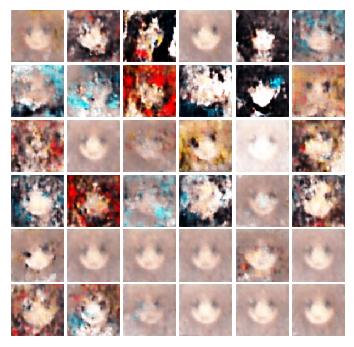


Iter:21200, D:-196.3, G:-7.411
epoch:4241---------------------------------
Iter:21205, D:-219.2, G:-1.361
epoch:4242---------------------------------
Iter:21210, D:-220.9, G:-1.342
epoch:4243---------------------------------
Iter:21215, D:-233.7, G:-16.85
epoch:4244---------------------------------
Iter:21220, D:-191.2, G:-10.05
epoch:4245---------------------------------
Iter:21225, D:-196.1, G:-11.92
epoch:4246---------------------------------
Iter:21230, D:-244.8, G:-15.47
epoch:4247---------------------------------
Iter:21235, D:-171.9, G:-0.4937
epoch:4248---------------------------------
Iter:21240, D:-158.8, G:-4.13
epoch:4249---------------------------------
Iter:21245, D:-190.8, G:-9.68
epoch:4250---------------------------------
Iter:21250, D:-245.0, G:-21.51
epoch:4251---------------------------------
Iter:21255, D:-187.6, G:0.751
epoch:4252---------------------------------
Iter:21260, D:-171.6, G:7.39
epoch:4253---------------------------------
Iter:21265, D:-200.0, G:-17.

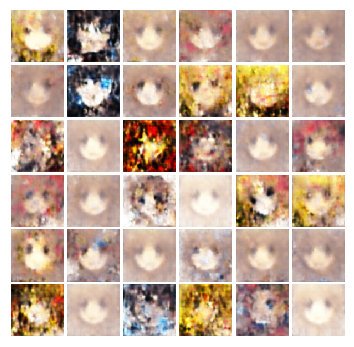


Iter:21400, D:-241.9, G:-21.91
epoch:4281---------------------------------
Iter:21405, D:-174.4, G:7.645
epoch:4282---------------------------------
Iter:21410, D:-243.3, G:-11.45
epoch:4283---------------------------------
Iter:21415, D:-200.5, G:-6.379
epoch:4284---------------------------------
Iter:21420, D:-216.8, G:-2.977
epoch:4285---------------------------------
Iter:21425, D:-162.0, G:-13.41
epoch:4286---------------------------------
Iter:21430, D:-216.7, G:-27.01
epoch:4287---------------------------------
Iter:21435, D:-224.1, G:-3.81
epoch:4288---------------------------------
Iter:21440, D:-230.9, G:-17.95
epoch:4289---------------------------------
Iter:21445, D:-192.8, G:-2.245
epoch:4290---------------------------------
Iter:21450, D:-193.5, G:-14.6
epoch:4291---------------------------------
Iter:21455, D:-246.7, G:-13.48
epoch:4292---------------------------------
Iter:21460, D:-193.6, G:-1.331
epoch:4293---------------------------------
Iter:21465, D:-236.1, G:-14

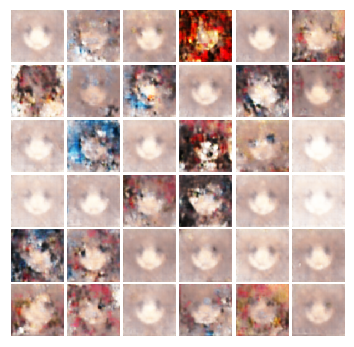


Iter:21600, D:-213.7, G:-7.802
epoch:4321---------------------------------
Iter:21605, D:-230.6, G:-16.53
epoch:4322---------------------------------
Iter:21610, D:-202.3, G:-12.35
epoch:4323---------------------------------
Iter:21615, D:-236.5, G:-11.41
epoch:4324---------------------------------
Iter:21620, D:-215.3, G:-18.61
epoch:4325---------------------------------
Iter:21625, D:-218.0, G:-2.541
epoch:4326---------------------------------
Iter:21630, D:-208.6, G:6.466
epoch:4327---------------------------------
Iter:21635, D:-192.7, G:-4.632
epoch:4328---------------------------------
Iter:21640, D:-181.1, G:-11.47
epoch:4329---------------------------------
Iter:21645, D:-211.8, G:-21.25
epoch:4330---------------------------------
Iter:21650, D:-214.8, G:-3.416
epoch:4331---------------------------------
Iter:21655, D:-255.8, G:-20.82
epoch:4332---------------------------------
Iter:21660, D:-236.1, G:-3.405
epoch:4333---------------------------------
Iter:21665, D:-276.9, G:-

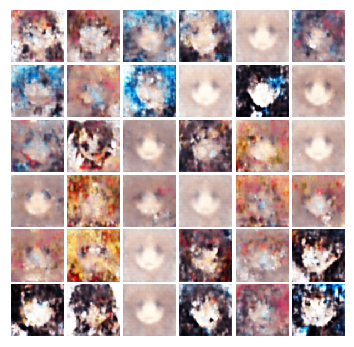


Iter:21800, D:-234.6, G:-9.04
epoch:4361---------------------------------
Iter:21805, D:-230.5, G:-18.28
epoch:4362---------------------------------
Iter:21810, D:-216.6, G:-10.1
epoch:4363---------------------------------
Iter:21815, D:-190.9, G:-10.99
epoch:4364---------------------------------
Iter:21820, D:-217.1, G:-18.47
epoch:4365---------------------------------
Iter:21825, D:-215.9, G:-8.256
epoch:4366---------------------------------
Iter:21830, D:-259.4, G:-13.21
epoch:4367---------------------------------
Iter:21835, D:-229.6, G:-12.13
epoch:4368---------------------------------
Iter:21840, D:-207.1, G:6.888
epoch:4369---------------------------------
Iter:21845, D:-191.9, G:-9.813
epoch:4370---------------------------------
Iter:21850, D:-180.8, G:-2.987
epoch:4371---------------------------------
Iter:21855, D:-224.7, G:-10.44
epoch:4372---------------------------------
Iter:21860, D:-204.8, G:-25.46
epoch:4373---------------------------------
Iter:21865, D:-196.9, G:-10

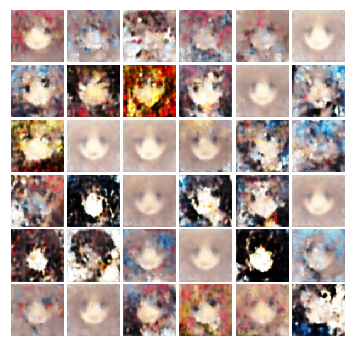


Iter:22000, D:-222.0, G:-5.215
epoch:4401---------------------------------
Iter:22005, D:-219.1, G:-9.575
epoch:4402---------------------------------
Iter:22010, D:-219.8, G:-4.376
epoch:4403---------------------------------
Iter:22015, D:-256.1, G:-5.48
epoch:4404---------------------------------
Iter:22020, D:-223.4, G:-20.3
epoch:4405---------------------------------
Iter:22025, D:-218.7, G:1.025
epoch:4406---------------------------------
Iter:22030, D:-197.5, G:-14.71
epoch:4407---------------------------------
Iter:22035, D:-224.0, G:-24.4
epoch:4408---------------------------------
Iter:22040, D:-186.5, G:-13.22
epoch:4409---------------------------------
Iter:22045, D:-208.4, G:-0.51
epoch:4410---------------------------------
Iter:22050, D:-218.1, G:-12.08
epoch:4411---------------------------------
Iter:22055, D:-176.4, G:6.778
epoch:4412---------------------------------
Iter:22060, D:-176.0, G:-17.29
epoch:4413---------------------------------
Iter:22065, D:-194.8, G:-13.61

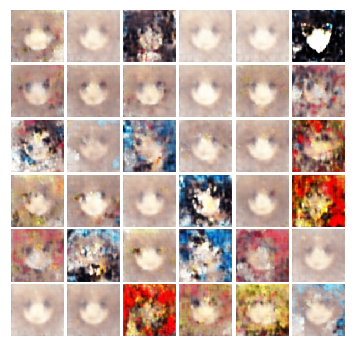


Iter:22200, D:-212.8, G:-5.505
epoch:4441---------------------------------
Iter:22205, D:-216.5, G:-10.85
epoch:4442---------------------------------
Iter:22210, D:-222.2, G:-4.728
epoch:4443---------------------------------
Iter:22215, D:-236.7, G:-7.42
epoch:4444---------------------------------
Iter:22220, D:-249.6, G:-17.01
epoch:4445---------------------------------
Iter:22225, D:-198.4, G:-12.0
epoch:4446---------------------------------
Iter:22230, D:-198.9, G:-12.4
epoch:4447---------------------------------
Iter:22235, D:-192.7, G:-8.801
epoch:4448---------------------------------
Iter:22240, D:-255.7, G:-15.16
epoch:4449---------------------------------
Iter:22245, D:-233.5, G:-25.19
epoch:4450---------------------------------
Iter:22250, D:-191.4, G:-11.54
epoch:4451---------------------------------
Iter:22255, D:-204.6, G:0.06905
epoch:4452---------------------------------
Iter:22260, D:-279.5, G:-36.85
epoch:4453---------------------------------
Iter:22265, D:-234.8, G:0.

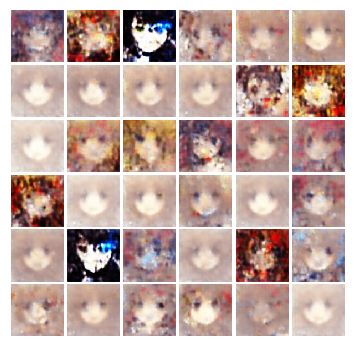


Iter:22400, D:-233.4, G:-18.62
epoch:4481---------------------------------
Iter:22405, D:-228.2, G:-8.047
epoch:4482---------------------------------
Iter:22410, D:-187.7, G:-3.892
epoch:4483---------------------------------
Iter:22415, D:-231.7, G:-19.11
epoch:4484---------------------------------
Iter:22420, D:-252.3, G:-19.25
epoch:4485---------------------------------
Iter:22425, D:-229.1, G:-1.813
epoch:4486---------------------------------
Iter:22430, D:-226.2, G:-9.934
epoch:4487---------------------------------
Iter:22435, D:-211.2, G:-4.206
epoch:4488---------------------------------
Iter:22440, D:-205.1, G:-17.5
epoch:4489---------------------------------
Iter:22445, D:-206.9, G:-9.362
epoch:4490---------------------------------
Iter:22450, D:-198.8, G:-28.47
epoch:4491---------------------------------
Iter:22455, D:-234.3, G:-17.97
epoch:4492---------------------------------
Iter:22460, D:-161.2, G:5.5
epoch:4493---------------------------------
Iter:22465, D:-237.2, G:-28.

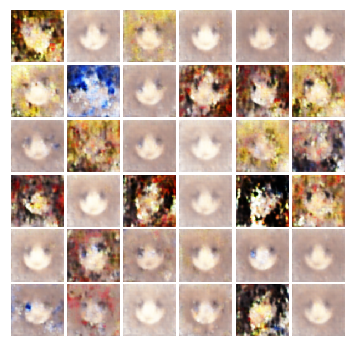


Iter:22600, D:-206.4, G:-16.97
epoch:4521---------------------------------
Iter:22605, D:-229.0, G:-14.81
epoch:4522---------------------------------
Iter:22610, D:-204.7, G:-7.373
epoch:4523---------------------------------
Iter:22615, D:-193.9, G:-15.13
epoch:4524---------------------------------
Iter:22620, D:-233.2, G:-12.42
epoch:4525---------------------------------
Iter:22625, D:-190.2, G:-14.58
epoch:4526---------------------------------
Iter:22630, D:-178.4, G:-19.63
epoch:4527---------------------------------
Iter:22635, D:-192.7, G:-8.508
epoch:4528---------------------------------
Iter:22640, D:-239.7, G:-25.5
epoch:4529---------------------------------
Iter:22645, D:-220.5, G:-19.5
epoch:4530---------------------------------
Iter:22650, D:-206.1, G:-3.606
epoch:4531---------------------------------
Iter:22655, D:-217.3, G:-6.202
epoch:4532---------------------------------
Iter:22660, D:-195.8, G:-2.722
epoch:4533---------------------------------
Iter:22665, D:-183.5, G:3.

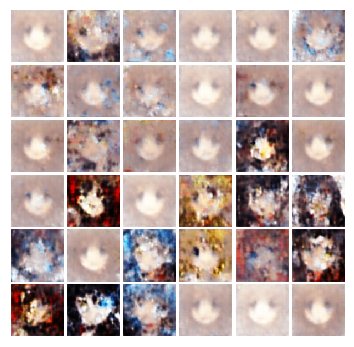


Iter:22800, D:-210.9, G:-19.41
epoch:4561---------------------------------
Iter:22805, D:-192.8, G:-10.02
epoch:4562---------------------------------
Iter:22810, D:-218.9, G:-10.96
epoch:4563---------------------------------
Iter:22815, D:-160.8, G:8.578
epoch:4564---------------------------------
Iter:22820, D:-226.4, G:-8.469
epoch:4565---------------------------------
Iter:22825, D:-190.4, G:2.569
epoch:4566---------------------------------
Iter:22830, D:-214.7, G:-17.64
epoch:4567---------------------------------
Iter:22835, D:-231.0, G:-16.63
epoch:4568---------------------------------
Iter:22840, D:-208.7, G:-13.62
epoch:4569---------------------------------
Iter:22845, D:-175.0, G:1.897
epoch:4570---------------------------------
Iter:22850, D:-232.2, G:-24.66
epoch:4571---------------------------------
Iter:22855, D:-265.1, G:-18.2
epoch:4572---------------------------------
Iter:22860, D:-195.1, G:-16.07
epoch:4573---------------------------------
Iter:22865, D:-197.0, G:4.58

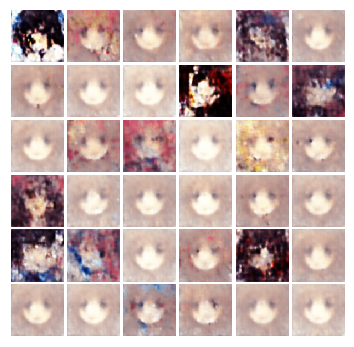


Iter:23000, D:-213.1, G:-18.51
epoch:4601---------------------------------
Iter:23005, D:-195.0, G:-4.972
epoch:4602---------------------------------
Iter:23010, D:-228.0, G:-16.74
epoch:4603---------------------------------
Iter:23015, D:-208.1, G:-5.535
epoch:4604---------------------------------
Iter:23020, D:-189.4, G:-13.68
epoch:4605---------------------------------
Iter:23025, D:-203.0, G:-5.345
epoch:4606---------------------------------
Iter:23030, D:-214.1, G:-6.183
epoch:4607---------------------------------
Iter:23035, D:-229.5, G:-13.19
epoch:4608---------------------------------
Iter:23040, D:-225.4, G:-10.1
epoch:4609---------------------------------
Iter:23045, D:-148.6, G:-1.313
epoch:4610---------------------------------
Iter:23050, D:-198.9, G:-18.03
epoch:4611---------------------------------
Iter:23055, D:-206.6, G:-9.013
epoch:4612---------------------------------
Iter:23060, D:-232.7, G:-11.94
epoch:4613---------------------------------
Iter:23065, D:-214.3, G:-

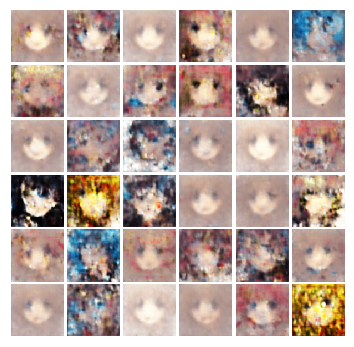


Iter:23200, D:-222.7, G:-19.23
epoch:4641---------------------------------
Iter:23205, D:-249.7, G:-11.69
epoch:4642---------------------------------
Iter:23210, D:-186.8, G:-12.52
epoch:4643---------------------------------
Iter:23215, D:-235.1, G:-14.71
epoch:4644---------------------------------
Iter:23220, D:-243.9, G:-23.85
epoch:4645---------------------------------
Iter:23225, D:-193.0, G:-22.37
epoch:4646---------------------------------
Iter:23230, D:-175.1, G:-5.168
epoch:4647---------------------------------
Iter:23235, D:-225.7, G:-12.77
epoch:4648---------------------------------
Iter:23240, D:-241.0, G:-14.77
epoch:4649---------------------------------
Iter:23245, D:-168.2, G:-0.377
epoch:4650---------------------------------
Iter:23250, D:-199.9, G:-2.554
epoch:4651---------------------------------
Iter:23255, D:-221.3, G:-16.57
epoch:4652---------------------------------
Iter:23260, D:-194.7, G:-18.08
epoch:4653---------------------------------
Iter:23265, D:-248.8, G:

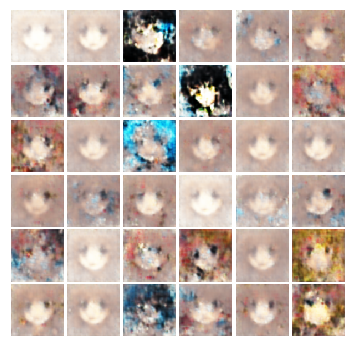


Iter:23400, D:-213.8, G:-9.795
epoch:4681---------------------------------
Iter:23405, D:-183.7, G:-2.654
epoch:4682---------------------------------
Iter:23410, D:-220.9, G:-23.14
epoch:4683---------------------------------
Iter:23415, D:-181.1, G:-4.016
epoch:4684---------------------------------
Iter:23420, D:-192.7, G:-19.09
epoch:4685---------------------------------
Iter:23425, D:-175.5, G:-11.29
epoch:4686---------------------------------
Iter:23430, D:-219.1, G:-4.567
epoch:4687---------------------------------
Iter:23435, D:-183.0, G:0.601
epoch:4688---------------------------------
Iter:23440, D:-182.0, G:-17.32
epoch:4689---------------------------------
Iter:23445, D:-208.4, G:-10.55
epoch:4690---------------------------------
Iter:23450, D:-191.2, G:-0.4111
epoch:4691---------------------------------
Iter:23455, D:-211.5, G:-17.45
epoch:4692---------------------------------
Iter:23460, D:-212.3, G:-4.475
epoch:4693---------------------------------
Iter:23465, D:-211.1, G:

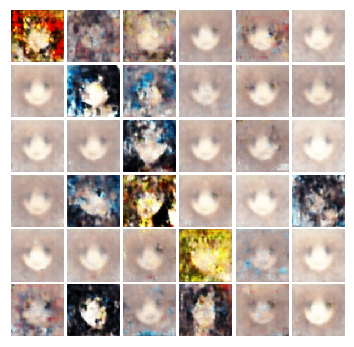


Iter:23600, D:-234.9, G:-21.88
epoch:4721---------------------------------
Iter:23605, D:-208.0, G:-14.01
epoch:4722---------------------------------
Iter:23610, D:-184.0, G:8.256
epoch:4723---------------------------------
Iter:23615, D:-225.5, G:-16.7
epoch:4724---------------------------------
Iter:23620, D:-220.4, G:-4.697
epoch:4725---------------------------------
Iter:23625, D:-217.9, G:-7.808
epoch:4726---------------------------------
Iter:23630, D:-208.6, G:-23.85
epoch:4727---------------------------------
Iter:23635, D:-231.4, G:-15.71
epoch:4728---------------------------------
Iter:23640, D:-219.1, G:-1.333
epoch:4729---------------------------------
Iter:23645, D:-200.2, G:-19.57
epoch:4730---------------------------------
Iter:23650, D:-220.6, G:-0.484
epoch:4731---------------------------------
Iter:23655, D:-183.5, G:-4.431
epoch:4732---------------------------------
Iter:23660, D:-197.4, G:-16.64
epoch:4733---------------------------------
Iter:23665, D:-208.8, G:-8

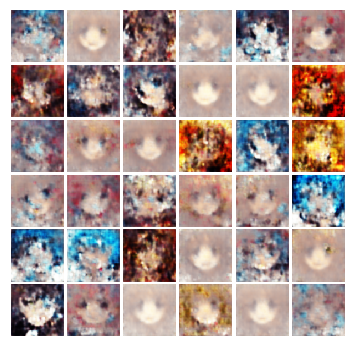


Iter:23800, D:-227.6, G:-12.3
epoch:4761---------------------------------
Iter:23805, D:-187.0, G:-9.523
epoch:4762---------------------------------
Iter:23810, D:-198.0, G:-11.68
epoch:4763---------------------------------
Iter:23815, D:-150.5, G:-12.12
epoch:4764---------------------------------
Iter:23820, D:-205.9, G:-23.33
epoch:4765---------------------------------
Iter:23825, D:-224.1, G:-28.49
epoch:4766---------------------------------
Iter:23830, D:-213.7, G:-17.56
epoch:4767---------------------------------
Iter:23835, D:-213.0, G:-15.72
epoch:4768---------------------------------
Iter:23840, D:-212.0, G:-12.44
epoch:4769---------------------------------
Iter:23845, D:-217.7, G:-17.4
epoch:4770---------------------------------
Iter:23850, D:-225.9, G:-12.43
epoch:4771---------------------------------
Iter:23855, D:-207.9, G:-9.966
epoch:4772---------------------------------
Iter:23860, D:-207.7, G:-20.73
epoch:4773---------------------------------
Iter:23865, D:-216.4, G:-2

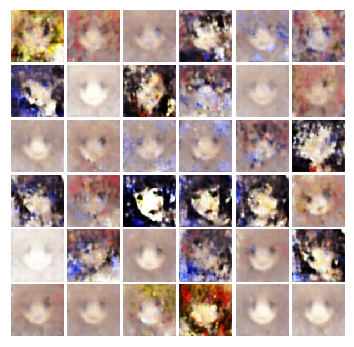


Iter:24000, D:-224.7, G:-18.4
epoch:4801---------------------------------
Iter:24005, D:-162.0, G:-14.49
epoch:4802---------------------------------
Iter:24010, D:-208.8, G:-20.85
epoch:4803---------------------------------
Iter:24015, D:-206.8, G:-23.71
epoch:4804---------------------------------
Iter:24020, D:-204.1, G:-19.73
epoch:4805---------------------------------
Iter:24025, D:-208.7, G:-9.107
epoch:4806---------------------------------
Iter:24030, D:-204.2, G:-12.19
epoch:4807---------------------------------
Iter:24035, D:-209.8, G:-17.77
epoch:4808---------------------------------
Iter:24040, D:-212.6, G:-24.74
epoch:4809---------------------------------
Iter:24045, D:-250.4, G:-23.19
epoch:4810---------------------------------
Iter:24050, D:-167.3, G:-7.754
epoch:4811---------------------------------
Iter:24055, D:-178.4, G:-13.25
epoch:4812---------------------------------
Iter:24060, D:-255.8, G:-34.44
epoch:4813---------------------------------
Iter:24065, D:-246.6, G:-

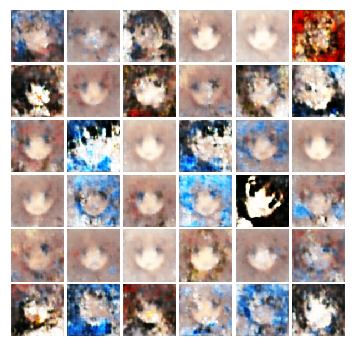


Iter:24200, D:-180.6, G:-21.85
epoch:4841---------------------------------
Iter:24205, D:-189.7, G:-19.11
epoch:4842---------------------------------
Iter:24210, D:-217.3, G:-13.74
epoch:4843---------------------------------
Iter:24215, D:-211.4, G:-22.47
epoch:4844---------------------------------
Iter:24220, D:-198.7, G:-19.74
epoch:4845---------------------------------
Iter:24225, D:-206.5, G:-22.07
epoch:4846---------------------------------
Iter:24230, D:-225.4, G:-14.77
epoch:4847---------------------------------
Iter:24235, D:-210.6, G:-16.54
epoch:4848---------------------------------
Iter:24240, D:-201.2, G:-13.89
epoch:4849---------------------------------
Iter:24245, D:-223.7, G:-10.98
epoch:4850---------------------------------
Iter:24250, D:-212.1, G:-18.31
epoch:4851---------------------------------
Iter:24255, D:-218.8, G:-19.11
epoch:4852---------------------------------
Iter:24260, D:-207.8, G:-23.86
epoch:4853---------------------------------
Iter:24265, D:-207.6, G:

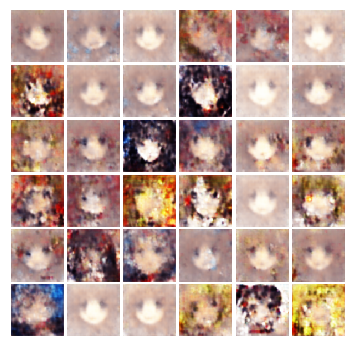


Iter:24400, D:-205.1, G:-17.24
epoch:4881---------------------------------
Iter:24405, D:-213.7, G:-23.14
epoch:4882---------------------------------
Iter:24410, D:-203.1, G:-13.11
epoch:4883---------------------------------
Iter:24415, D:-211.1, G:-15.42
epoch:4884---------------------------------
Iter:24420, D:-208.7, G:-20.36
epoch:4885---------------------------------
Iter:24425, D:-204.8, G:-24.63
epoch:4886---------------------------------
Iter:24430, D:-207.3, G:-13.91
epoch:4887---------------------------------
Iter:24435, D:-199.6, G:-13.02
epoch:4888---------------------------------
Iter:24440, D:-205.1, G:-16.71
epoch:4889---------------------------------
Iter:24445, D:-231.6, G:-18.36
epoch:4890---------------------------------
Iter:24450, D:-202.6, G:-9.641
epoch:4891---------------------------------
Iter:24455, D:-193.1, G:-20.97
epoch:4892---------------------------------
Iter:24460, D:-196.9, G:-12.29
epoch:4893---------------------------------
Iter:24465, D:-191.0, G:

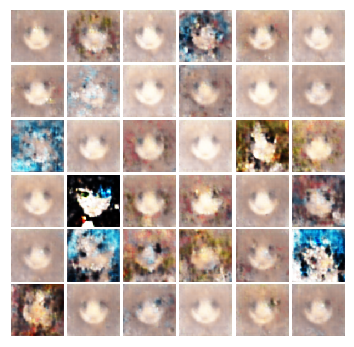


Iter:24600, D:-199.7, G:-22.03
epoch:4921---------------------------------
Iter:24605, D:-185.2, G:-5.553
epoch:4922---------------------------------
Iter:24610, D:-172.0, G:-15.77
epoch:4923---------------------------------
Iter:24615, D:-173.9, G:-10.02
epoch:4924---------------------------------
Iter:24620, D:-213.9, G:-29.17
epoch:4925---------------------------------
Iter:24625, D:-243.1, G:-29.58
epoch:4926---------------------------------
Iter:24630, D:-193.9, G:-5.803
epoch:4927---------------------------------
Iter:24635, D:-180.9, G:-4.414
epoch:4928---------------------------------
Iter:24640, D:-190.1, G:-12.83
epoch:4929---------------------------------
Iter:24645, D:-196.3, G:-26.22
epoch:4930---------------------------------
Iter:24650, D:-187.0, G:-16.58
epoch:4931---------------------------------
Iter:24655, D:-218.9, G:-20.81
epoch:4932---------------------------------
Iter:24660, D:-246.4, G:-14.47
epoch:4933---------------------------------
Iter:24665, D:-205.6, G:

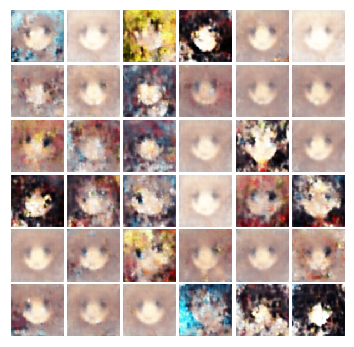


Iter:24800, D:-243.3, G:-29.44
epoch:4961---------------------------------
Iter:24805, D:-227.2, G:-26.61
epoch:4962---------------------------------
Iter:24810, D:-215.6, G:-19.65
epoch:4963---------------------------------
Iter:24815, D:-176.3, G:-0.6513
epoch:4964---------------------------------
Iter:24820, D:-196.9, G:-27.85
epoch:4965---------------------------------
Iter:24825, D:-202.2, G:-22.87
epoch:4966---------------------------------
Iter:24830, D:-236.9, G:-24.78
epoch:4967---------------------------------
Iter:24835, D:-232.0, G:-18.33
epoch:4968---------------------------------
Iter:24840, D:-224.8, G:-21.36
epoch:4969---------------------------------
Iter:24845, D:-173.2, G:-4.103
epoch:4970---------------------------------
Iter:24850, D:-148.5, G:-6.978
epoch:4971---------------------------------
Iter:24855, D:-208.8, G:-22.2
epoch:4972---------------------------------
Iter:24860, D:-211.1, G:-13.7
epoch:4973---------------------------------
Iter:24865, D:-246.6, G:-

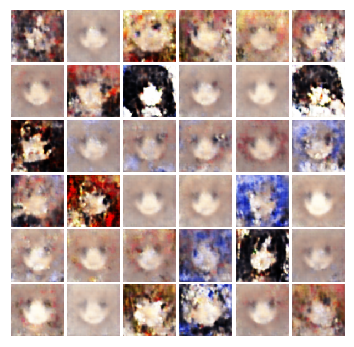


Iter:25000, D:-182.9, G:-9.425
epoch:5001---------------------------------
Iter:25005, D:-189.1, G:-15.36
epoch:5002---------------------------------
Iter:25010, D:-223.0, G:-27.66
epoch:5003---------------------------------
Iter:25015, D:-206.8, G:-14.77
epoch:5004---------------------------------
Iter:25020, D:-203.5, G:-26.61
epoch:5005---------------------------------
Iter:25025, D:-230.3, G:-21.69
epoch:5006---------------------------------
Iter:25030, D:-234.4, G:-20.79
epoch:5007---------------------------------
Iter:25035, D:-207.3, G:-11.43
epoch:5008---------------------------------
Iter:25040, D:-183.2, G:-17.62
epoch:5009---------------------------------
Iter:25045, D:-226.7, G:-25.89
epoch:5010---------------------------------
Iter:25050, D:-154.2, G:-16.24
epoch:5011---------------------------------
Iter:25055, D:-214.0, G:-15.82
epoch:5012---------------------------------
Iter:25060, D:-189.7, G:-31.74
epoch:5013---------------------------------
Iter:25065, D:-189.8, G:

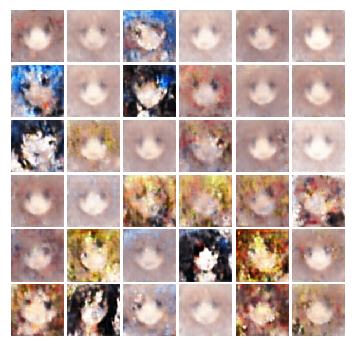


Iter:25200, D:-211.1, G:-14.87
epoch:5041---------------------------------
Iter:25205, D:-210.1, G:-22.31
epoch:5042---------------------------------
Iter:25210, D:-210.3, G:-25.92
epoch:5043---------------------------------
Iter:25215, D:-238.0, G:-10.73
epoch:5044---------------------------------
Iter:25220, D:-222.4, G:-17.07
epoch:5045---------------------------------
Iter:25225, D:-181.3, G:-16.74
epoch:5046---------------------------------
Iter:25230, D:-187.3, G:-16.22
epoch:5047---------------------------------
Iter:25235, D:-187.8, G:-15.21
epoch:5048---------------------------------
Iter:25240, D:-159.3, G:-14.4
epoch:5049---------------------------------
Iter:25245, D:-224.6, G:-33.7
epoch:5050---------------------------------
Iter:25250, D:-242.4, G:-26.22
epoch:5051---------------------------------
Iter:25255, D:-211.9, G:-9.26
epoch:5052---------------------------------
Iter:25260, D:-220.3, G:-22.78
epoch:5053---------------------------------
Iter:25265, D:-220.1, G:-23

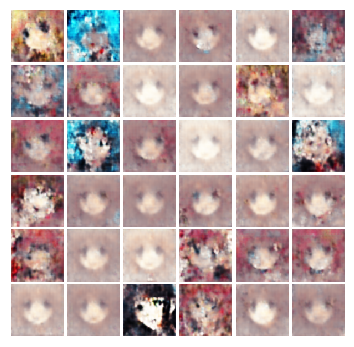


Iter:25400, D:-232.1, G:-29.24
epoch:5081---------------------------------
Iter:25405, D:-161.5, G:-9.594
epoch:5082---------------------------------
Iter:25410, D:-199.5, G:-22.09
epoch:5083---------------------------------
Iter:25415, D:-197.1, G:-16.63
epoch:5084---------------------------------
Iter:25420, D:-252.7, G:-30.74
epoch:5085---------------------------------
Iter:25425, D:-168.4, G:-3.071
epoch:5086---------------------------------
Iter:25430, D:-180.9, G:-10.92
epoch:5087---------------------------------
Iter:25435, D:-214.5, G:-23.91
epoch:5088---------------------------------
Iter:25440, D:-216.4, G:-21.01
epoch:5089---------------------------------
Iter:25445, D:-196.0, G:-8.005
epoch:5090---------------------------------
Iter:25450, D:-201.8, G:-20.86
epoch:5091---------------------------------
Iter:25455, D:-208.7, G:-19.95
epoch:5092---------------------------------
Iter:25460, D:-217.2, G:-14.99
epoch:5093---------------------------------
Iter:25465, D:-192.4, G:

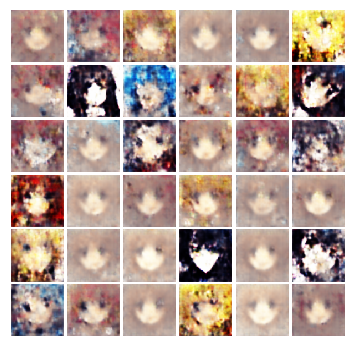


Iter:25600, D:-196.0, G:-12.22
epoch:5121---------------------------------
Iter:25605, D:-219.2, G:-18.58
epoch:5122---------------------------------
Iter:25610, D:-220.4, G:-29.35
epoch:5123---------------------------------
Iter:25615, D:-230.4, G:-27.81
epoch:5124---------------------------------
Iter:25620, D:-205.1, G:-18.01
epoch:5125---------------------------------
Iter:25625, D:-204.8, G:-34.76
epoch:5126---------------------------------
Iter:25630, D:-217.1, G:-29.16
epoch:5127---------------------------------
Iter:25635, D:-213.5, G:-17.38
epoch:5128---------------------------------
Iter:25640, D:-246.9, G:-31.24
epoch:5129---------------------------------
Iter:25645, D:-197.3, G:-12.24
epoch:5130---------------------------------
Iter:25650, D:-207.6, G:-12.57
epoch:5131---------------------------------
Iter:25655, D:-194.0, G:-18.06
epoch:5132---------------------------------
Iter:25660, D:-207.6, G:-24.55
epoch:5133---------------------------------
Iter:25665, D:-196.0, G:

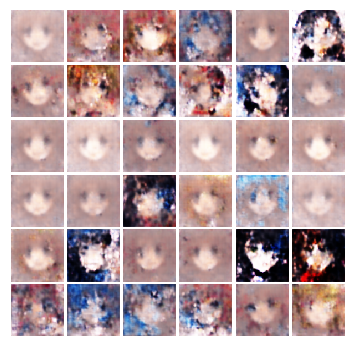


Iter:25800, D:-254.9, G:-21.5
epoch:5161---------------------------------
Iter:25805, D:-205.2, G:-18.7
epoch:5162---------------------------------
Iter:25810, D:-241.7, G:-13.07
epoch:5163---------------------------------
Iter:25815, D:-217.5, G:-29.02
epoch:5164---------------------------------
Iter:25820, D:-202.0, G:-20.76
epoch:5165---------------------------------
Iter:25825, D:-178.7, G:-17.28
epoch:5166---------------------------------
Iter:25830, D:-214.7, G:-34.2
epoch:5167---------------------------------
Iter:25835, D:-271.5, G:-29.75
epoch:5168---------------------------------
Iter:25840, D:-190.0, G:-18.95
epoch:5169---------------------------------
Iter:25845, D:-170.9, G:-21.56
epoch:5170---------------------------------
Iter:25850, D:-216.4, G:-29.75
epoch:5171---------------------------------
Iter:25855, D:-194.0, G:-24.71
epoch:5172---------------------------------
Iter:25860, D:-208.2, G:-21.24
epoch:5173---------------------------------
Iter:25865, D:-185.2, G:-20

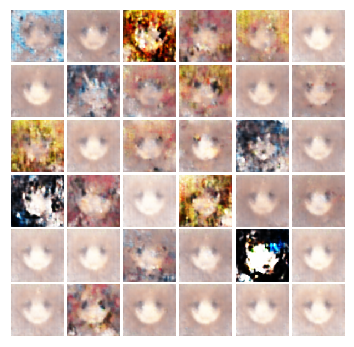


Iter:26000, D:-183.9, G:-26.85
epoch:5201---------------------------------
Iter:26005, D:-228.7, G:-25.67
epoch:5202---------------------------------
Iter:26010, D:-198.8, G:-22.47
epoch:5203---------------------------------
Iter:26015, D:-205.7, G:-20.18
epoch:5204---------------------------------
Iter:26020, D:-209.9, G:-27.68
epoch:5205---------------------------------
Iter:26025, D:-185.2, G:-20.92
epoch:5206---------------------------------
Iter:26030, D:-188.8, G:-14.05
epoch:5207---------------------------------
Iter:26035, D:-227.3, G:-28.17
epoch:5208---------------------------------
Iter:26040, D:-246.3, G:-34.91
epoch:5209---------------------------------
Iter:26045, D:-219.0, G:-24.01
epoch:5210---------------------------------
Iter:26050, D:-195.9, G:-21.2
epoch:5211---------------------------------
Iter:26055, D:-241.0, G:-39.72
epoch:5212---------------------------------
Iter:26060, D:-221.3, G:-23.79
epoch:5213---------------------------------
Iter:26065, D:-177.4, G:-

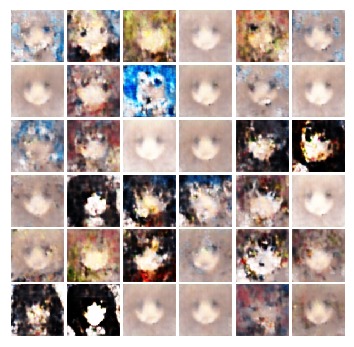


Iter:26200, D:-219.9, G:-32.37
epoch:5241---------------------------------
Iter:26205, D:-211.9, G:-9.785
epoch:5242---------------------------------
Iter:26210, D:-232.9, G:-14.9
epoch:5243---------------------------------
Iter:26215, D:-236.5, G:-40.81
epoch:5244---------------------------------
Iter:26220, D:-153.7, G:-19.01
epoch:5245---------------------------------
Iter:26225, D:-226.0, G:-29.8
epoch:5246---------------------------------
Iter:26230, D:-223.2, G:-23.69
epoch:5247---------------------------------
Iter:26235, D:-196.7, G:-24.83
epoch:5248---------------------------------
Iter:26240, D:-256.0, G:-29.61
epoch:5249---------------------------------
Iter:26245, D:-207.3, G:-17.65
epoch:5250---------------------------------
Iter:26250, D:-237.9, G:-38.16
epoch:5251---------------------------------
Iter:26255, D:-216.3, G:-40.9
epoch:5252---------------------------------
Iter:26260, D:-194.7, G:-32.48
epoch:5253---------------------------------
Iter:26265, D:-220.8, G:-22

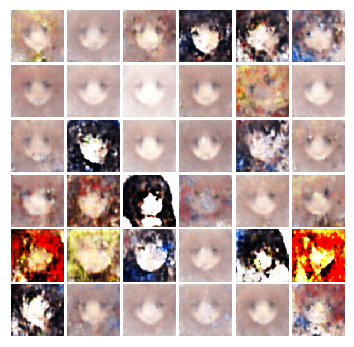


Iter:26400, D:-188.3, G:-26.38
epoch:5281---------------------------------
Iter:26405, D:-202.0, G:-30.64
epoch:5282---------------------------------
Iter:26410, D:-231.2, G:-28.85
epoch:5283---------------------------------
Iter:26415, D:-193.3, G:-15.85
epoch:5284---------------------------------
Iter:26420, D:-229.3, G:-20.74
epoch:5285---------------------------------
Iter:26425, D:-220.4, G:-29.97
epoch:5286---------------------------------
Iter:26430, D:-202.8, G:-23.56
epoch:5287---------------------------------
Iter:26435, D:-225.0, G:-27.27
epoch:5288---------------------------------
Iter:26440, D:-218.2, G:-12.94
epoch:5289---------------------------------
Iter:26445, D:-199.7, G:-39.74
epoch:5290---------------------------------
Iter:26450, D:-259.8, G:-25.15
epoch:5291---------------------------------
Iter:26455, D:-209.4, G:-18.34
epoch:5292---------------------------------
Iter:26460, D:-218.0, G:-24.83
epoch:5293---------------------------------
Iter:26465, D:-182.3, G:

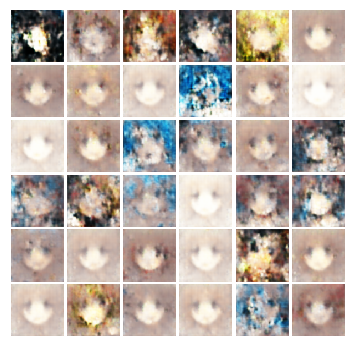


Iter:26600, D:-197.2, G:-23.87
epoch:5321---------------------------------
Iter:26605, D:-234.6, G:-20.9
epoch:5322---------------------------------
Iter:26610, D:-259.1, G:-35.45
epoch:5323---------------------------------
Iter:26615, D:-208.1, G:-22.08
epoch:5324---------------------------------
Iter:26620, D:-233.0, G:-25.7
epoch:5325---------------------------------
Iter:26625, D:-182.5, G:-22.2
epoch:5326---------------------------------
Iter:26630, D:-197.4, G:-35.07
epoch:5327---------------------------------
Iter:26635, D:-196.6, G:-18.17
epoch:5328---------------------------------
Iter:26640, D:-214.8, G:-33.27
epoch:5329---------------------------------
Iter:26645, D:-190.9, G:-30.25
epoch:5330---------------------------------
Iter:26650, D:-193.4, G:-23.5
epoch:5331---------------------------------
Iter:26655, D:-206.5, G:-33.3
epoch:5332---------------------------------
Iter:26660, D:-185.6, G:-27.5
epoch:5333---------------------------------
Iter:26665, D:-234.8, G:-39.44

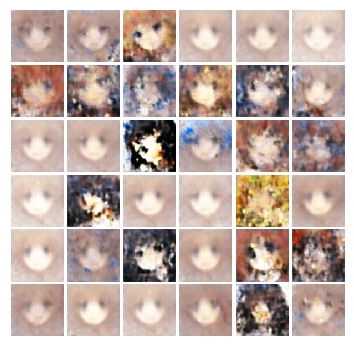


Iter:26800, D:-240.2, G:-43.58
epoch:5361---------------------------------
Iter:26805, D:-196.5, G:-13.75
epoch:5362---------------------------------
Iter:26810, D:-215.5, G:-35.1
epoch:5363---------------------------------
Iter:26815, D:-234.3, G:-28.41
epoch:5364---------------------------------
Iter:26820, D:-201.0, G:-25.28
epoch:5365---------------------------------
Iter:26825, D:-184.0, G:-29.22
epoch:5366---------------------------------
Iter:26830, D:-183.7, G:-27.92
epoch:5367---------------------------------
Iter:26835, D:-207.7, G:-33.53
epoch:5368---------------------------------
Iter:26840, D:-202.3, G:-20.71
epoch:5369---------------------------------
Iter:26845, D:-171.1, G:-25.22
epoch:5370---------------------------------
Iter:26850, D:-195.0, G:-28.29
epoch:5371---------------------------------
Iter:26855, D:-190.3, G:-26.26
epoch:5372---------------------------------
Iter:26860, D:-219.3, G:-34.26
epoch:5373---------------------------------
Iter:26865, D:-252.4, G:-

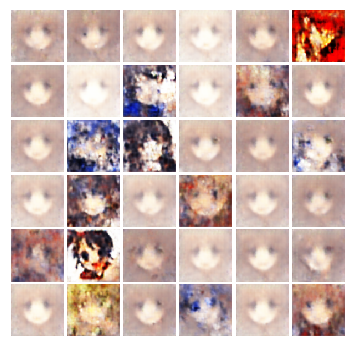


Iter:27000, D:-191.0, G:-16.88
epoch:5401---------------------------------
Iter:27005, D:-228.6, G:-31.4
epoch:5402---------------------------------
Iter:27010, D:-216.8, G:-30.86
epoch:5403---------------------------------
Iter:27015, D:-200.8, G:-10.67
epoch:5404---------------------------------
Iter:27020, D:-183.2, G:-27.15
epoch:5405---------------------------------
Iter:27025, D:-241.2, G:-36.39
epoch:5406---------------------------------
Iter:27030, D:-192.1, G:-19.38
epoch:5407---------------------------------
Iter:27035, D:-169.7, G:-29.04
epoch:5408---------------------------------
Iter:27040, D:-199.5, G:-24.78
epoch:5409---------------------------------
Iter:27045, D:-168.3, G:-15.86
epoch:5410---------------------------------
Iter:27050, D:-250.5, G:-39.25
epoch:5411---------------------------------
Iter:27055, D:-230.2, G:-28.55
epoch:5412---------------------------------
Iter:27060, D:-218.2, G:-19.28
epoch:5413---------------------------------
Iter:27065, D:-163.7, G:-

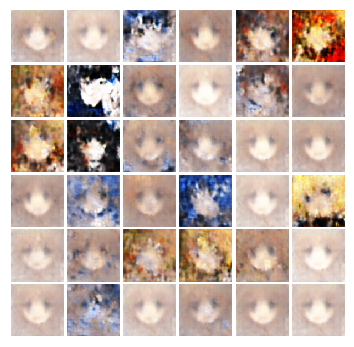


Iter:27200, D:-193.5, G:-18.71
epoch:5441---------------------------------
Iter:27205, D:-177.8, G:-18.01
epoch:5442---------------------------------
Iter:27210, D:-183.9, G:-32.26
epoch:5443---------------------------------
Iter:27215, D:-175.0, G:-21.91
epoch:5444---------------------------------
Iter:27220, D:-181.1, G:-18.59
epoch:5445---------------------------------
Iter:27225, D:-236.6, G:-35.09
epoch:5446---------------------------------
Iter:27230, D:-206.1, G:-18.12
epoch:5447---------------------------------
Iter:27235, D:-227.2, G:-44.58
epoch:5448---------------------------------
Iter:27240, D:-177.6, G:-16.05
epoch:5449---------------------------------
Iter:27245, D:-213.5, G:-31.74
epoch:5450---------------------------------
Iter:27250, D:-198.4, G:-19.62
epoch:5451---------------------------------
Iter:27255, D:-202.9, G:-24.48
epoch:5452---------------------------------
Iter:27260, D:-230.6, G:-34.22
epoch:5453---------------------------------
Iter:27265, D:-231.0, G:

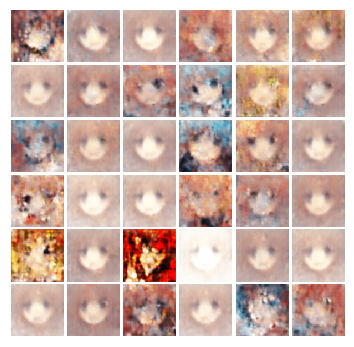


Iter:27400, D:-199.0, G:-26.63
epoch:5481---------------------------------
Iter:27405, D:-223.8, G:-22.62
epoch:5482---------------------------------
Iter:27410, D:-229.2, G:-14.9
epoch:5483---------------------------------
Iter:27415, D:-183.1, G:-30.91
epoch:5484---------------------------------
Iter:27420, D:-209.4, G:-39.22
epoch:5485---------------------------------
Iter:27425, D:-213.5, G:-22.88
epoch:5486---------------------------------
Iter:27430, D:-198.2, G:-29.16
epoch:5487---------------------------------
Iter:27435, D:-189.1, G:-27.73
epoch:5488---------------------------------
Iter:27440, D:-185.7, G:-23.25
epoch:5489---------------------------------
Iter:27445, D:-217.6, G:-38.54
epoch:5490---------------------------------
Iter:27450, D:-231.5, G:-24.63
epoch:5491---------------------------------
Iter:27455, D:-207.3, G:-21.15
epoch:5492---------------------------------
Iter:27460, D:-188.4, G:-19.37
epoch:5493---------------------------------
Iter:27465, D:-141.4, G:-

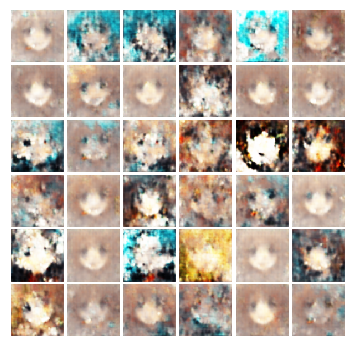


Iter:27600, D:-222.3, G:-22.58
epoch:5521---------------------------------
Iter:27605, D:-213.1, G:-22.91
epoch:5522---------------------------------
Iter:27610, D:-187.4, G:-14.59
epoch:5523---------------------------------
Iter:27615, D:-182.3, G:-34.74
epoch:5524---------------------------------
Iter:27620, D:-190.4, G:-12.15
epoch:5525---------------------------------
Iter:27625, D:-178.8, G:-25.63
epoch:5526---------------------------------
Iter:27630, D:-207.4, G:-28.2
epoch:5527---------------------------------
Iter:27635, D:-209.4, G:-33.65
epoch:5528---------------------------------
Iter:27640, D:-234.1, G:-27.31
epoch:5529---------------------------------
Iter:27645, D:-205.4, G:-25.38
epoch:5530---------------------------------
Iter:27650, D:-243.2, G:-37.2
epoch:5531---------------------------------
Iter:27655, D:-186.3, G:-17.72
epoch:5532---------------------------------
Iter:27660, D:-229.1, G:-22.81
epoch:5533---------------------------------
Iter:27665, D:-227.3, G:-3

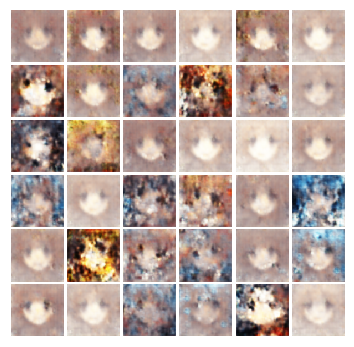

In [5]:
tf.reset_default_graph()
img_size = cifar_10.shape[1]
x = tf.placeholder(tf.float32,[batch_size,img_size*img_size*3])#----------------------------------------change para
img_real = x
z = sample_noise(batch_size,noise_dim) 
G_sample = generator(z)#output [batch,96*96*3]
out_img = tf.reshape(deprocess(G_sample[:save_size]),[-1,img_size,img_size,3])#------------------------change para  #resize shape. 9696

                                                        #output = [batch,96,96,3] 

with tf.variable_scope("") as scope:
    logits_real = discriminator(preprocess(x))
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)
    
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator')
d_solver,g_solver = get_solvers()

d_loss,g_loss = wgan_gp_loss(logits_real,logits_fake,batch_size,x,G_sample) #change loss oneonoeneone ----------------
d_train_step = d_solver.minimize(d_loss,var_list=D_vars)
g_train_step = g_solver.minimize(g_loss,var_list=G_vars)
d_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
g_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')
tf.summary.image("image",out_img,max_outputs=save_size)
merged = tf.summary.merge_all()

with session() as sess:
    try:
        with tf.device("/gpu:0") as dev:
            #merged
            
            ##initialize
            sess.run(tf.global_variables_initializer())
            
            
            train_writer = tf.summary.FileWriter(log_dir,sess.graph)
            
            train(sess,g_train_step,g_loss,d_train_step,d_loss,g_extra_step,d_extra_step,
                  show_every=200,print_every=5,batch_size=batch_size,num_epoch=5000)    
    except tf.errors.InvalidArgumentError:
        print("no gpu found, please use Google Cloud if you want GPU acceleration") 
